# **KOH1**

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from collections import defaultdict, Counter
from sklearn.metrics import (
    adjusted_rand_score, normalized_mutual_info_score,
    calinski_harabasz_score, davies_bouldin_score, silhouette_score
)
import matplotlib.pyplot as plt
import seaborn as sns

# **Available neighborhood functions**

In [8]:
def gaussian(distances, sigma):
    """
    Gaussian neighborhood function.

    Parameters:
        distances (numpy.ndarray): Distances from the BMU.
        sigma (float): Neighborhood radius.

    Returns:
        numpy.ndarray: Gaussian function values based on distances.
    """
    
    return np.exp(-distances**2 / (2 * sigma**2))


def mexican_hat(distances, sigma):
    """
    Mexican Hat neighborhood function (second derivative of Gaussian).

    Parameters:
        distances (numpy.ndarray): Distances from the BMU.
        sigma (float): Neighborhood radius.

    Returns:
        numpy.ndarray: Mexican Hat function values based on distances.
    """
    
    return (1 - (distances**2 / sigma**2)) * np.exp(-distances**2 / (2 * sigma**2))


# **Kohonen Network**

In [9]:
class KohonenNetwork:
    def __init__(self, M, N):
        """
        Initializes the Kohonen Network.

        Parameters:
            M (int): The number of rows in the neuron grid.
            N (int): The number of columns in the neuron grid.
        """
        
        self.M = M
        self.N = N
        self.weights = None
        self.neurons = np.array([[np.array([i, j]) for j in range(N)] for i in range(M)])
        self.input_dim = None
        
        self.neighborhood_functions = {
            'gaussian': gaussian,
            'mexican_hat': mexican_hat
        }
        self.neighborhood_function = None


    def train(self, 
              data, 
              epochs, 
              learning_rate=0.1, 
              sigma=1.0, 
              decay_lambda=1000, 
              neighborhood_function='gaussian', 
              sigma_decay=True, 
              verbose=True):

        """
        Trains the Kohonen network on the given data. The method adjusts the network weights and organizes data based on their similarity.

        Parameters:
            data (numpy.ndarray): The input data for training, with each row representing a data point.
            epochs (int): The number of training epochs.
            learning_rate (float): The initial learning rate.
            sigma (float): The initial neighborhood radius.
            decay_lambda (float): The decay factor for the learning rate and neighborhood radius.
            neighborhood_function (str): The type of neighborhood function ('gaussian' or 'mexican_hat').
            sigma_decay (bool): Whether to apply decay to the neighborhood radius (sigma).
        """
        
        if self.weights is None:
            self.input_dim = data.shape[1]
            self.weights = np.random.rand(self.M, self.N, self.input_dim)
        
        if neighborhood_function not in self.neighborhood_functions:
            raise ValueError(f"Unknown neighborhood function '{neighborhood_function}'. Choose from: {list(self.neighborhood_functions.keys())}")
        
        self.neighborhood_function = self.neighborhood_functions[neighborhood_function]

        iteration = 0  
        for epoch in range(epochs):
            if verbose:
                print(f"Epoch {epoch + 1}/{epochs}")
            shuffled_data = np.random.permutation(data) 
            for sample in shuffled_data:
                bmu_idx = self.find_bmu(sample)
                self.update_weights(sample, bmu_idx, iteration, learning_rate, sigma, decay_lambda, sigma_decay)
                iteration += 1  


    def find_bmu(self, sample):
        """
        Finds the Best Matching Unit (BMU) for the given sample.
        The function calculates the Euclidean distance between the sample and each neuron's weights
        and returns the index of the neuron with the smallest distance (the BMU).
        
        Parameters:
            sample (numpy.ndarray): The input data sample to find the BMU for.

        Returns:
            tuple: The indices (i, j) of the BMU (Best Matching Unit) in the network grid.
        """
        
        distances = np.linalg.norm(self.weights - sample, axis=2)
        bmu_idx = np.unravel_index(np.argmin(distances), (self.M, self.N))
        return bmu_idx


    def update_weights(self, sample, bmu_idx, iteration, initial_learning_rate, initial_sigma, decay_lambda, sigma_decay):
        """
        Updates the weights of the network based on the sample and the BMU.
        The function calculates the learning rate and sigma for the current iteration,
        then updates the weights of the neurons within the neighborhood of the BMU.
        
        Parameters:
            sample (numpy.ndarray): The input data sample that is used for weight updates.
            bmu_idx (tuple): The index of the Best Matching Unit (BMU).
            iteration (int): The current iteration of training.
            initial_learning_rate (float): The initial learning rate.
            initial_sigma (float): The initial value of sigma (neighborhood radius).
            decay_lambda (float): The decay factor for the learning rate and neighborhood radius.
            sigma_decay (bool): Whether to apply decay to the neighborhood radius (sigma).
        """
        
        learning_rate = initial_learning_rate * np.exp(-iteration / decay_lambda)
        if sigma_decay:
            sigma = initial_sigma * np.exp(-iteration / decay_lambda)
            sigma = max(sigma, 1e-4)
        else:
            sigma = initial_sigma
        
        bmu_location = np.array(bmu_idx)
        distances_on_grid = np.linalg.norm(self.neurons - bmu_location, axis=2)

        neighborhood = self.calculate_neighborhood(distances_on_grid, sigma)
        neighborhood = np.expand_dims(neighborhood, axis=2)

        self.weights += learning_rate * neighborhood * (sample - self.weights)


    def calculate_neighborhood(self, distances, sigma):
        """
        Calculates the neighborhood function for the given distances.
        The function applies the selected neighborhood function (e.g., Gaussian or Mexican Hat)
        to the distance values, resulting in a matrix of weights that influence the neurons' updates.
        
        Parameters:
            distances (numpy.ndarray): The distances between neurons and the BMU.
            sigma (float): The neighborhood radius.

        Returns:
            numpy.ndarray: The calculated neighborhood function values.
        """
        
        return self.neighborhood_function(distances, sigma)


    def predict(self, sample):
        """
        Finds the Best Matching Unit (BMU) for a new sample.
        This method returns the index of the neuron that best matches the input sample,
        which is the BMU (Best Matching Unit).
        
        Parameters:
            sample (numpy.ndarray): The input data sample to predict the BMU for.

        Returns:
            tuple: The indices (i, j) of the BMU in the network grid.
        """
        
        return self.find_bmu(sample)
    
    
    def assign_clusters(self, data):
        """
        Assigns each point from the data to its best neuron (BMU).
        This method assigns each input data point to the neuron that is closest to it (BMU).

        Parameters:
            data (numpy.ndarray): The input data to be clustered.

        Returns:
            numpy.ndarray: An array of indices of the BMU for each data point.
        """
        
        bmu_locations = np.array([self.predict(sample) for sample in data])
        return bmu_locations


    def assign_classes(self, data):
        """
        Assigns classes to the data based on the Best Matching Unit (BMU) for each point.
        The function assigns a class label to each data point based on its corresponding BMU.
        Each unique BMU gets a unique class label.
        
        Parameters:
            data (numpy.ndarray): The input data to be classified.

        Returns:
            numpy.ndarray: An array with assigned classes (cluster labels) for each data point.
        """
        
        bmu_locations = self.assign_clusters(data)  
        bmu_flat_indices = bmu_locations[:, 0] * self.N + bmu_locations[:, 1]  

        unique_bmu_indices = np.unique(bmu_flat_indices)  
        class_mapping = {bmu_idx: idx for idx, bmu_idx in enumerate(unique_bmu_indices)} 
        
        assigned_classes = np.array([class_mapping[idx] for idx in bmu_flat_indices])
        
        return assigned_classes


    def plot_data_and_clusters(self, data, labels_true=None):
        """
        Creates a plot comparing:
        - Data with true labels
        - Data with assigned clusters (Kohonen neurons)

        Works for both 2D and 3D data.

        Parameters:
            data (numpy.ndarray): The input data to be visualized.
            labels_true (numpy.ndarray, optional): The true class labels for the data. Defaults to None.

        Returns:
            None
        """
        
        if labels_true is None:
            raise ValueError("To create a comparison, you must provide true labels (labels_true).")
        
        classes = self.assign_classes(data)  

        custom_colors = [
            'red', 'lightgreen', 'darkgreen', 'blue', 'yellow', 'orange', 'pink', 
            'black', 'brown', 'purple', 'cyan', 'magenta', 'lime', 
            'teal', 'indigo', 'gold', 'silver', 'navy', 'violet', 
            'beige', 'coral'
        ]              

        true_color_map = np.array([custom_colors[i % len(custom_colors)] for i in labels_true])
        cluster_color_map = np.array([custom_colors[i % len(custom_colors)] for i in classes])

        fig = plt.figure(figsize=(14, 6))

        if data.shape[1] == 2:
            # 2D DATA
            ax1 = fig.add_subplot(1, 2, 1)
            ax2 = fig.add_subplot(1, 2, 2)

            scatter1 = ax1.scatter(data[:, 0], data[:, 1], c=true_color_map, s=30)
            scatter2 = ax2.scatter(data[:, 0], data[:, 1], c=cluster_color_map, s=30)

            ax1.set_xlabel('x')
            ax1.set_ylabel('y')
            ax2.set_xlabel('x')
            ax2.set_ylabel('y')

        elif data.shape[1] == 3:
            # 3D DATA
            ax1 = fig.add_subplot(1, 2, 1, projection='3d')
            ax2 = fig.add_subplot(1, 2, 2, projection='3d')

            scatter1 = ax1.scatter(data[:, 0], data[:, 1], data[:, 2], c=true_color_map, s=30)
            scatter2 = ax2.scatter(data[:, 0], data[:, 1], data[:, 2], c=cluster_color_map, s=30)

            ax1.set_xlabel('x')
            ax1.set_ylabel('y')
            ax1.set_zlabel('z')
            ax2.set_xlabel('x')
            ax2.set_ylabel('y')
            ax2.set_zlabel('z')

        else:
            raise ValueError("Only 2D or 3D data is supported.")

        ax1.set_title("Data with True Labels")
        ax2.set_title("Data Colored by Kohonen Neurons")
        ax1.grid(True)
        ax2.grid(True)

        plt.tight_layout()
        plt.show()
        
        
    def plot_stacked_bar_neurons(self, data, labels_true, labels_pred):
        
        """
        Plots two stacked bar plots:
        - One for the true classes
        - One for the classes predicted by the model

        Parameters:
            data (numpy.ndarray): Input data.
            labels_true (numpy.ndarray): True class labels.
            labels_pred (numpy.ndarray): Class labels predicted by the model.

        Returns:
            None
        """
        
        bmu_locations = self.assign_clusters(data)

        neuron_positions_true = defaultdict(list)
        neuron_positions_pred = defaultdict(list)

        for idx, neuron in enumerate(bmu_locations):
            neuron = tuple(neuron)
            neuron_positions_true[neuron].append(labels_true[idx])
            neuron_positions_pred[neuron].append(labels_pred[idx])

        neurons = sorted(set(neuron_positions_true.keys()) | set(neuron_positions_pred.keys()))
        all_classes_true = np.unique(labels_true)
        all_classes_pred = np.unique(labels_pred)

        data_true_per_class = {cls: [] for cls in all_classes_true}
        data_pred_per_class = {cls: [] for cls in all_classes_pred}

        for neuron in neurons:
            counter_true = Counter(neuron_positions_true.get(neuron, []))
            counter_pred = Counter(neuron_positions_pred.get(neuron, []))
            for cls in all_classes_true:
                data_true_per_class[cls].append(counter_true.get(cls, 0))
            for cls in all_classes_pred:
                data_pred_per_class[cls].append(counter_pred.get(cls, 0))

        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(max(14, len(neurons)), 6), sharey=True)

        bottom_true = np.zeros(len(neurons))
        bottom_pred = np.zeros(len(neurons))
        
        colors = plt.colormaps.get_cmap('tab10')

        for idx, cls in enumerate(all_classes_true):
            counts = data_true_per_class[cls]
            ax1.bar(range(len(neurons)), counts, bottom=bottom_true, label=f'Class {cls}', color=colors(idx))
            bottom_true += counts

        for idx, cls in enumerate(all_classes_pred):
            counts = data_pred_per_class[cls]
            ax2.bar(range(len(neurons)), counts, bottom=bottom_pred, label=f'Class {cls}', color=colors(idx))

        ax1.set_xticks(range(len(neurons)))
        ax1.set_xticklabels([f"{n}" for n in neurons], rotation=90)
        ax2.set_xticks(range(len(neurons)))
        ax2.set_xticklabels([f"{n}" for n in neurons], rotation=90)

        ax1.set_xlabel("Neurons (grid positions)")
        ax2.set_xlabel("Neurons (grid positions)")
        ax1.set_ylabel("Number of samples")
        
        ax1.set_title("True Classes per Neuron")
        ax2.set_title("Predicted Classes per Neuron")

        max_height = max(bottom_true.max(), bottom_pred.max())
        ax1.set_ylim(0, max_height * 1.1)  
        ax2.set_ylim(0, max_height * 1.1)

        ax1.legend(title="True Classes", bbox_to_anchor=(1.05, 1), loc='upper left')
        ax2.legend(title="Predicted Classes", bbox_to_anchor=(1.05, 1), loc='upper left')

        plt.tight_layout()
        plt.show()
    
    def external_cluster_metrics(self, y_true, y_pred):
        """
        Computes external clustering evaluation metrics.

        Parameters:
            y_true (numpy.ndarray): True labels.
            y_pred (numpy.ndarray): Predicted labels.

        Returns:
            dict: Dictionary with 'ARI' and 'NMI' scores.
        """
        ari = adjusted_rand_score(y_true, y_pred)
        nmi = normalized_mutual_info_score(y_true, y_pred)

        return {
            'Adjusted Rand Index': ari,
            'Normalized Mutual Information': nmi
        }
        
    
    def internal_cluster_metrics(self, data, labels_pred):
        """
        Computes internal clustering evaluation metrics.

        Parameters:
            data (numpy.ndarray): Input features.
            labels_pred (numpy.ndarray): Predicted labels.

        Returns:
            dict: Dictionary with 'Calinski-Harabasz', 'Davies-Bouldin', and 'Silhouette' scores.
        """
        ch = calinski_harabasz_score(data, labels_pred)
        db = davies_bouldin_score(data, labels_pred)
        silhouette = silhouette_score(data, labels_pred)

        return {
            'Calinski-Harabasz Index': ch,
            'Davies-Bouldin Index': db,
            'Silhouette Score': silhouette
        }
        
    
    def evaluate_clustering(self, data, labels_true, labels_pred, show_table=True):
        """
        Evaluates the clustering quality using both external and internal metrics, and prints the results.

        Parameters:
            data (numpy.ndarray): Input data.
            labels_true (numpy.ndarray): True class labels.
            labels_pred (numpy.ndarray): Predicted class labels.
            show_table (bool): Whether to display the results as a table. Default is True.

        Returns:
            dict: Dictionary containing evaluation metrics.
        """
        
        ari = adjusted_rand_score(labels_true, labels_pred)
        nmi = normalized_mutual_info_score(labels_true, labels_pred)

        ch = db = silhouette = np.nan

        if len(np.unique(labels_pred)) > 1:
            # Only compute internal metrics if there are at least two clusters
            ch = calinski_harabasz_score(data, labels_pred)
            db = davies_bouldin_score(data, labels_pred)
            silhouette = silhouette_score(data, labels_pred)

        results = {
            'Adjusted Rand Index (ARI)': ari,
            'Normalized Mutual Information (NMI)': nmi,
            'Calinski-Harabasz Index': ch,
            'Davies-Bouldin Index': db,
            'Silhouette Score': silhouette
        }

        if show_table:
            results_df = pd.DataFrame(list(results.items()), columns=['Metric', 'Value'])
            print("\nClustering Evaluation Metrics:")
            print(results_df.to_string(index=False))

        return results


# **Tests**

In [10]:
sigmas = [0.1, 0.5, 1.0, 10.0]
neighborhood_function_names = ['gaussian', 'mexican_hat']
MNs = [(2, 2), (2, 3), (3, 3), (10, 10)]

In [15]:
def make_summary_plots(results_df):
    grouped_nmi = results_df.groupby('sigma')['nmi'].agg(['mean', 'std']).reset_index()
    grouped_db = results_df.groupby('sigma')['davies_bouldin'].agg(['mean', 'std']).reset_index()

    fig, axes = plt.subplots(1, 2, figsize=(16, 6))

    axes[0].plot(grouped_nmi['sigma'], grouped_nmi['mean'], marker='o', color='blue', label='Mean NMI')
    axes[0].fill_between(grouped_nmi['sigma'],
                        grouped_nmi['mean'] - grouped_nmi['std'],
                        grouped_nmi['mean'] + grouped_nmi['std'],
                        color='blue', alpha=0.2, label='Mean ± STD')

    axes[0].set_title('Change in NMI with respect to Sigma')
    axes[0].set_xlabel('Sigma')
    axes[0].set_ylabel('NMI')
    axes[0].legend()
    axes[0].grid(True)

    axes[1].plot(grouped_db['sigma'], grouped_db['mean'], marker='o', color='red', label='Mean Davies-Bouldin')
    axes[1].fill_between(grouped_db['sigma'],
                        grouped_db['mean'] - grouped_db['std'],
                        grouped_db['mean'] + grouped_db['std'],
                        color='red', alpha=0.2, label='Mean ± STD')

    axes[1].set_title('Change in Davies-Bouldin with respect to Sigma')
    axes[1].set_xlabel('Sigma')
    axes[1].set_ylabel('Davies-Bouldin Score')
    axes[1].legend()
    axes[1].grid(True)

    plt.tight_layout()
    plt.show()

    fig, axes = plt.subplots(1, 2, figsize=(16, 6))

    sns.boxplot(x='function_name', y='davies_bouldin', hue='function_name', data=results_df, palette='Set2', ax=axes[0], legend=False)
    axes[0].set_title('Davies-Bouldin Score vs Neighborhood Function')
    axes[0].set_xlabel('Neighborhood Function')
    axes[0].set_ylabel('Davies-Bouldin Score')
    axes[0].grid(True, axis='y')

    sns.boxplot(x='function_name', y='nmi', hue='function_name', data=results_df, palette='Set3', ax=axes[1], legend=False)
    axes[1].set_title('NMI vs Neighborhood Function')
    axes[1].set_xlabel('Neighborhood Function')
    axes[1].set_ylabel('NMI')
    axes[1].grid(True, axis='y')

    plt.tight_layout()
    plt.show()

    fig, axes = plt.subplots(1, 2, figsize=(20, 7))

    x_labels = [f"M={m}, N={n}" for m, n in zip(results_df['M'], results_df['N'])]

    sns.barplot(x=x_labels, y=results_df['nmi'], errorbar='sd', palette='muted', ax=axes[0], hue=x_labels, legend=False)
    axes[0].set_title('Average NMI for different (M, N) combinations')
    axes[0].set_xlabel('(M, N)')
    axes[0].set_ylabel('NMI')
    axes[0].tick_params(axis='x', rotation=45)
    axes[0].grid(axis='y')

    sns.barplot(x=x_labels, y=results_df['davies_bouldin'], errorbar='sd', palette='muted', ax=axes[1], hue=x_labels, legend=False)
    axes[1].set_title('Average Davies-Bouldin for different (M, N) combinations')
    axes[1].set_xlabel('(M, N)')
    axes[1].set_ylabel('Davies-Bouldin')
    axes[1].tick_params(axis='x', rotation=45)
    axes[1].grid(axis='y')

    plt.tight_layout()
    plt.show()

# **Hexagon dataset**


############### Neighborhood function: gaussian. M = 2, N = 2. Sigma: 0.1. ###############

Number of original classes: 6. Number of clusters detected by the network: 4.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.665960
Normalized Mutual Information (NMI)   0.816940
            Calinski-Harabasz Index 985.127685
               Davies-Bouldin Index   0.761324
                   Silhouette Score   0.486986


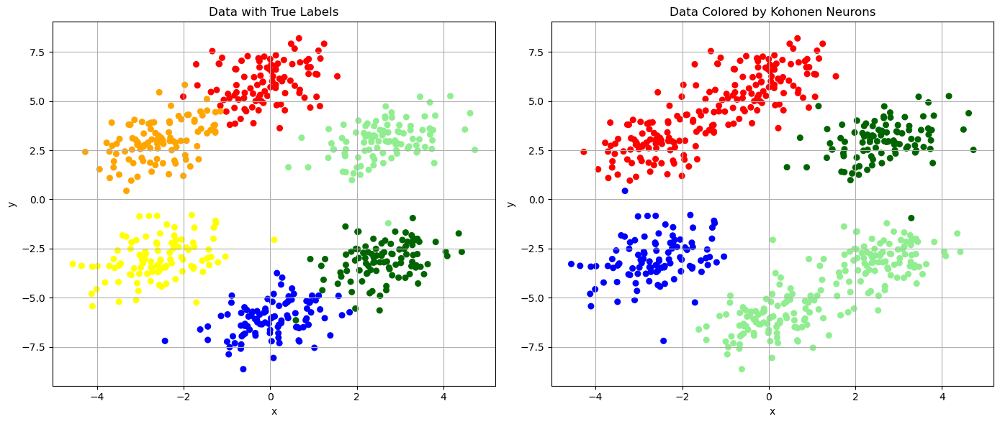

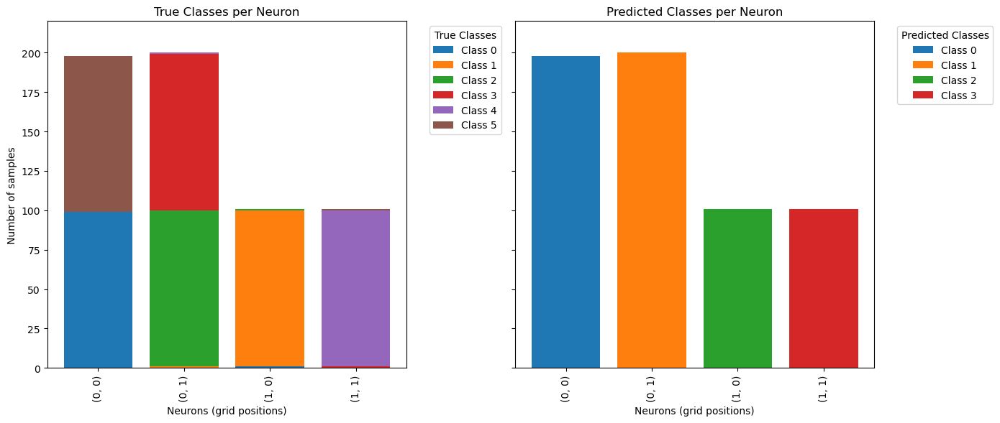


############### Neighborhood function: gaussian. M = 2, N = 2. Sigma: 0.5. ###############

Number of original classes: 6. Number of clusters detected by the network: 4.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.665960
Normalized Mutual Information (NMI)   0.816940
            Calinski-Harabasz Index 985.127685
               Davies-Bouldin Index   0.761324
                   Silhouette Score   0.486986


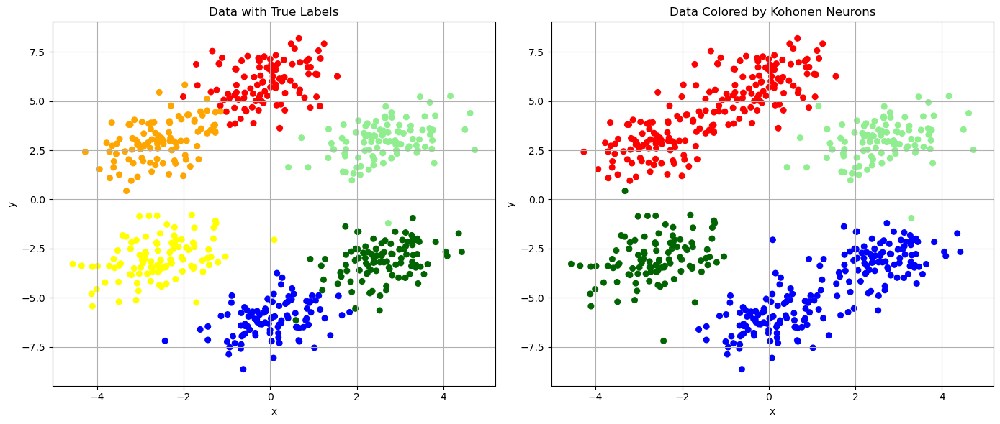

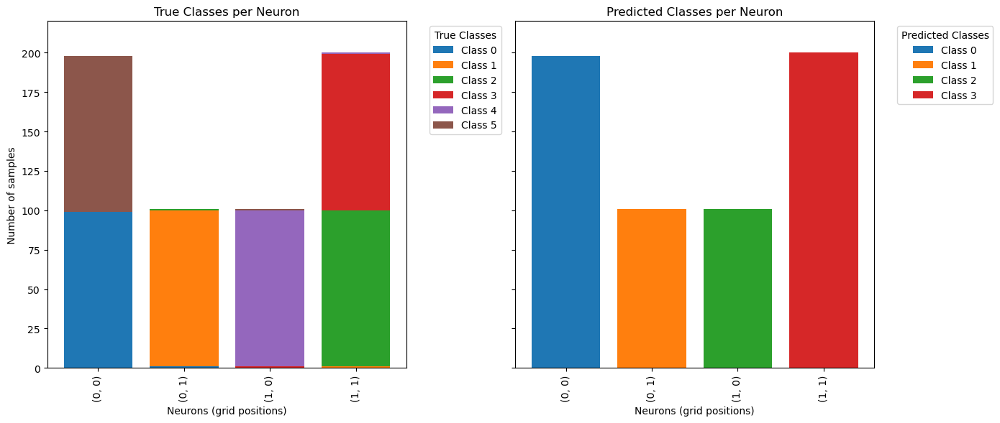


############### Neighborhood function: gaussian. M = 2, N = 2. Sigma: 1.0. ###############

Number of original classes: 6. Number of clusters detected by the network: 4.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.645746
Normalized Mutual Information (NMI)   0.777672
            Calinski-Harabasz Index 953.083535
               Davies-Bouldin Index   0.824017
                   Silhouette Score   0.454623


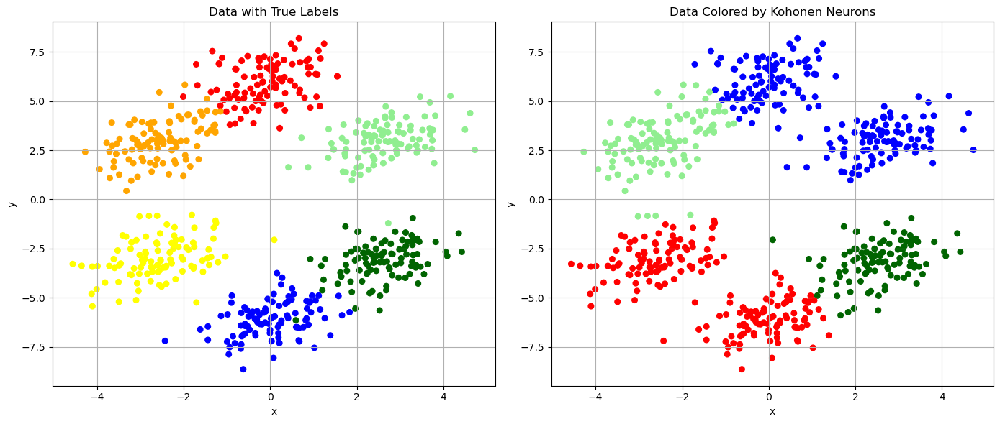

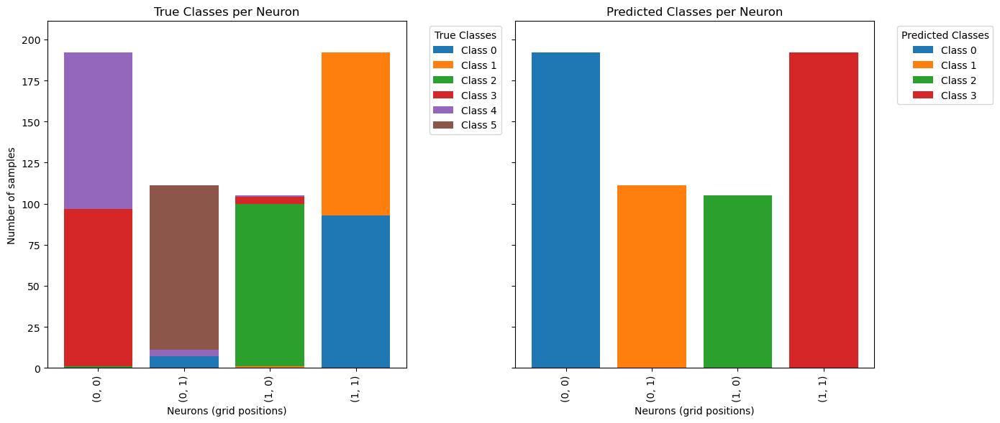


############### Neighborhood function: gaussian. M = 2, N = 2. Sigma: 10.0. ###############

Number of original classes: 6. Number of clusters detected by the network: 4.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.321345
Normalized Mutual Information (NMI)   0.524383
            Calinski-Harabasz Index 582.745719
               Davies-Bouldin Index   0.872106
                   Silhouette Score   0.291347


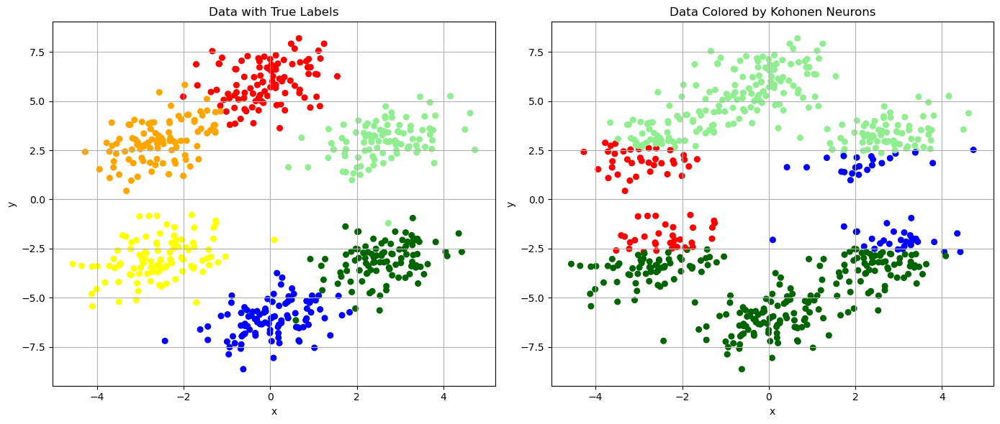

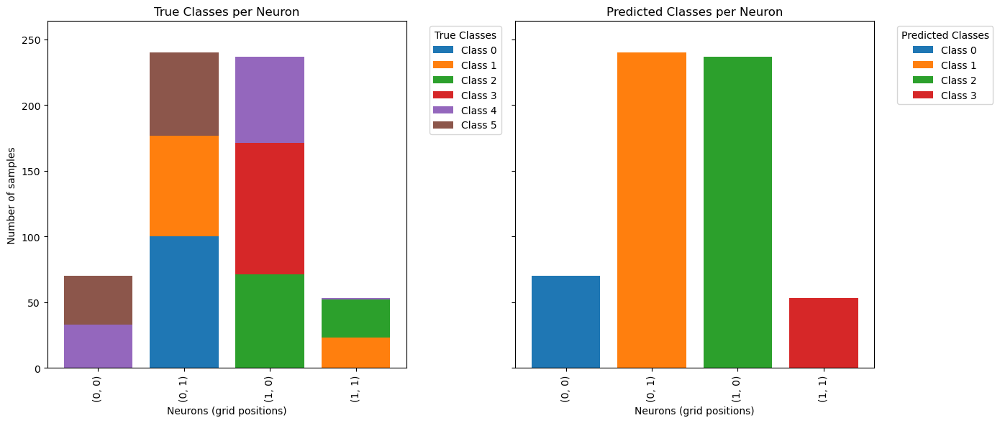


############### Neighborhood function: gaussian. M = 2, N = 3. Sigma: 0.1. ###############

Number of original classes: 6. Number of clusters detected by the network: 6.

Clustering Evaluation Metrics:
                             Metric       Value
          Adjusted Rand Index (ARI)    0.941276
Normalized Mutual Information (NMI)    0.938366
            Calinski-Harabasz Index 1841.663551
               Davies-Bouldin Index    0.540275
                   Silhouette Score    0.598927


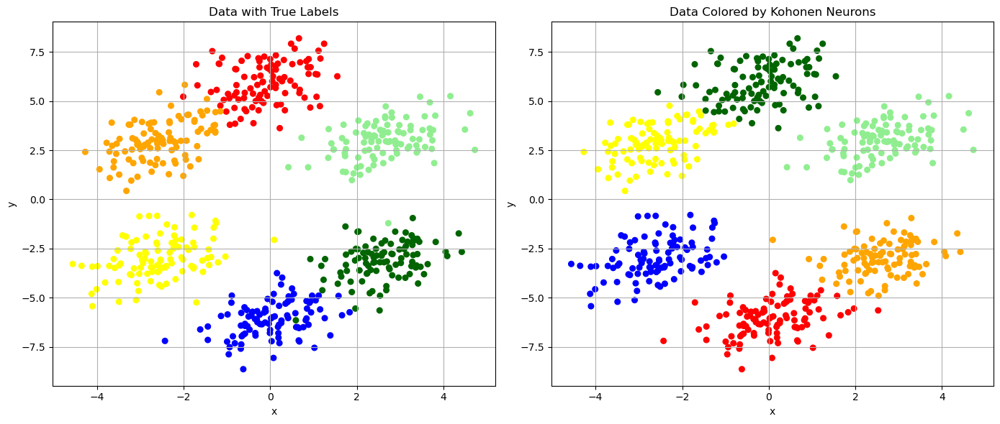

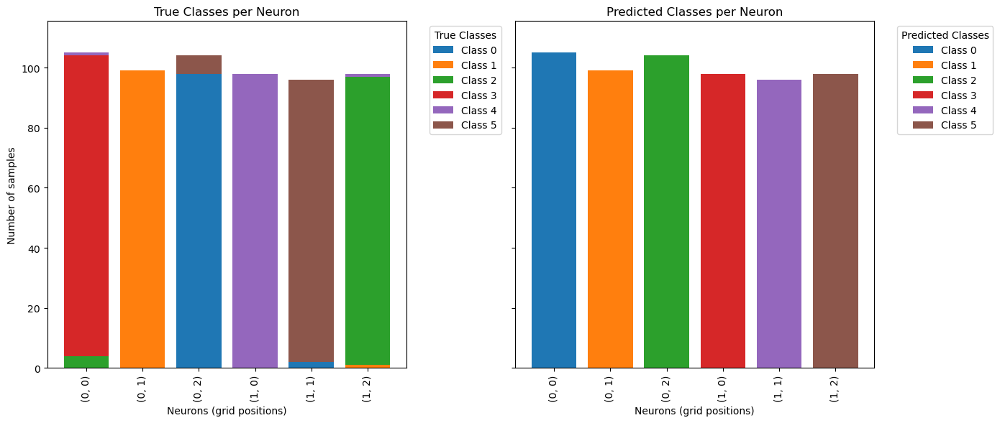


############### Neighborhood function: gaussian. M = 2, N = 3. Sigma: 0.5. ###############

Number of original classes: 6. Number of clusters detected by the network: 6.

Clustering Evaluation Metrics:
                             Metric       Value
          Adjusted Rand Index (ARI)    0.941276
Normalized Mutual Information (NMI)    0.938366
            Calinski-Harabasz Index 1841.663551
               Davies-Bouldin Index    0.540275
                   Silhouette Score    0.598927


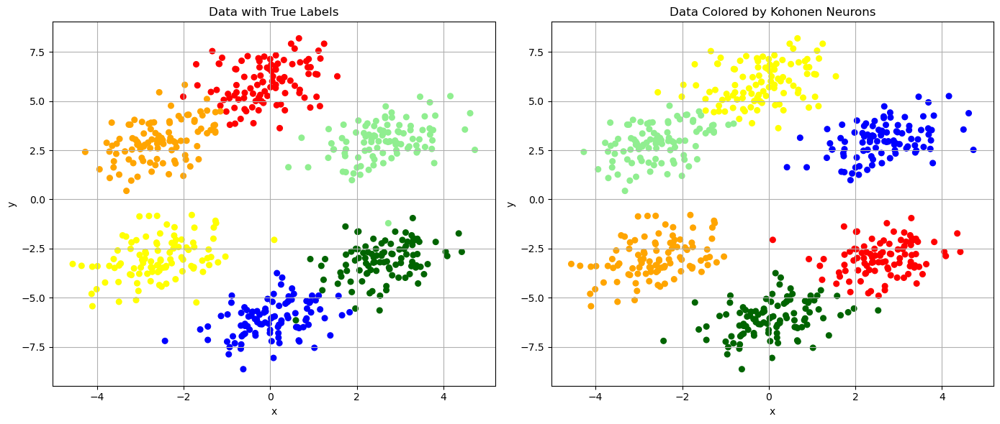

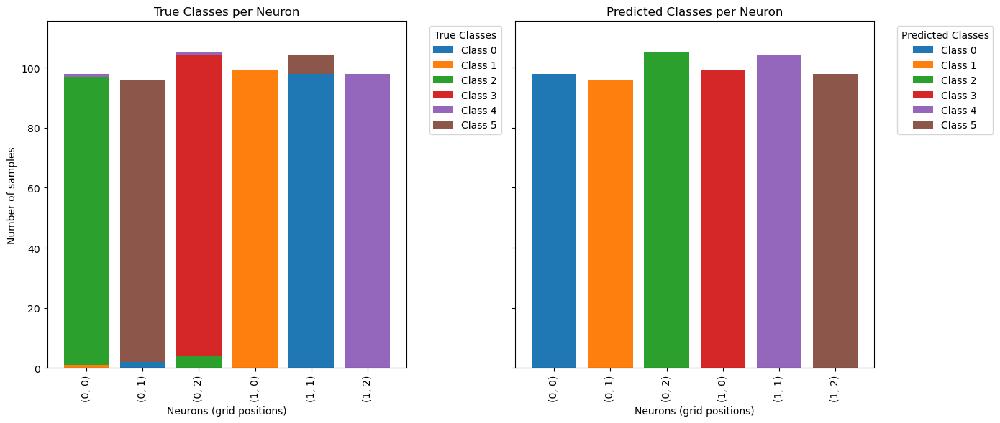


############### Neighborhood function: gaussian. M = 2, N = 3. Sigma: 1.0. ###############

Number of original classes: 6. Number of clusters detected by the network: 6.

Clustering Evaluation Metrics:
                             Metric       Value
          Adjusted Rand Index (ARI)    0.941276
Normalized Mutual Information (NMI)    0.938366
            Calinski-Harabasz Index 1841.663551
               Davies-Bouldin Index    0.540275
                   Silhouette Score    0.598927


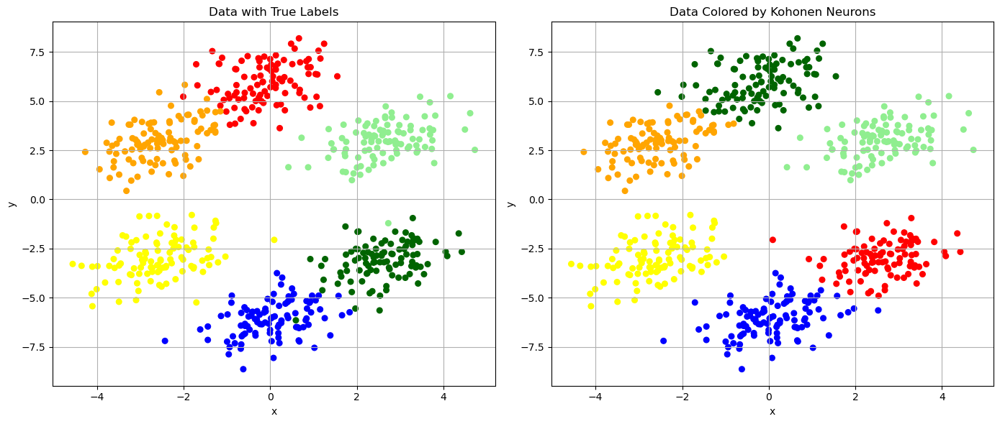

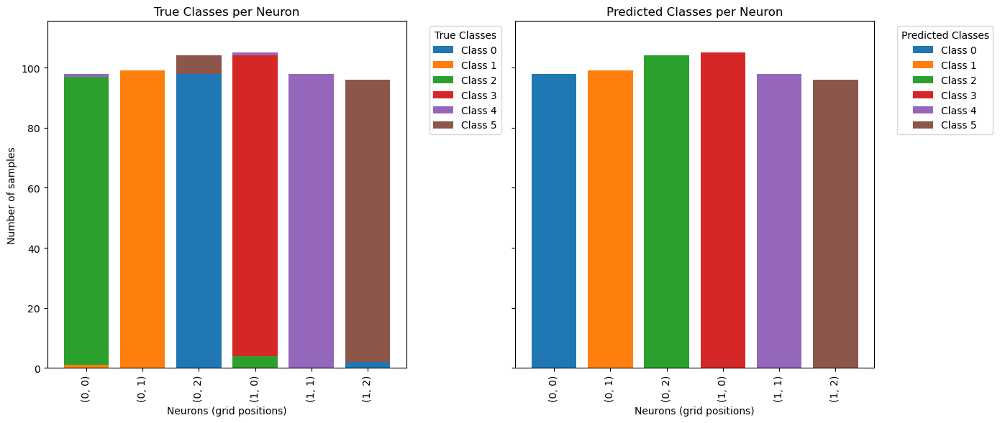


############### Neighborhood function: gaussian. M = 2, N = 3. Sigma: 10.0. ###############

Number of original classes: 6. Number of clusters detected by the network: 6.

Clustering Evaluation Metrics:
                             Metric       Value
          Adjusted Rand Index (ARI)    0.727035
Normalized Mutual Information (NMI)    0.814624
            Calinski-Harabasz Index 1047.894828
               Davies-Bouldin Index    0.743859
                   Silhouette Score    0.437326


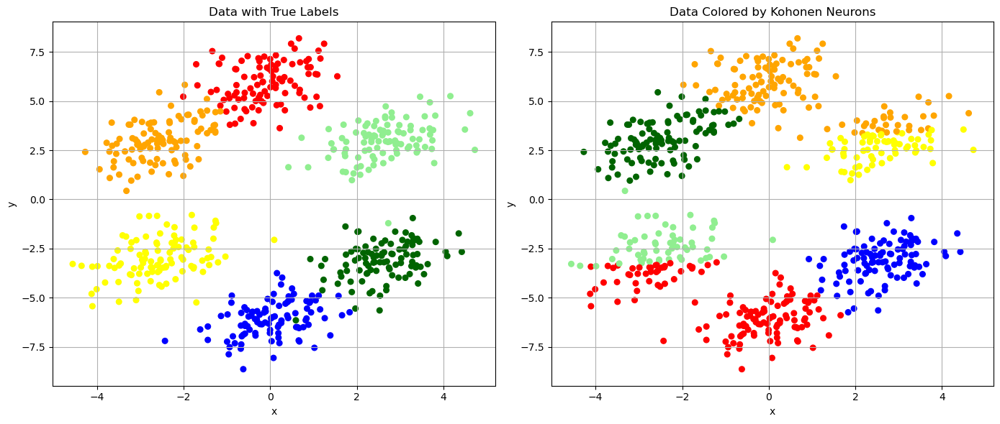

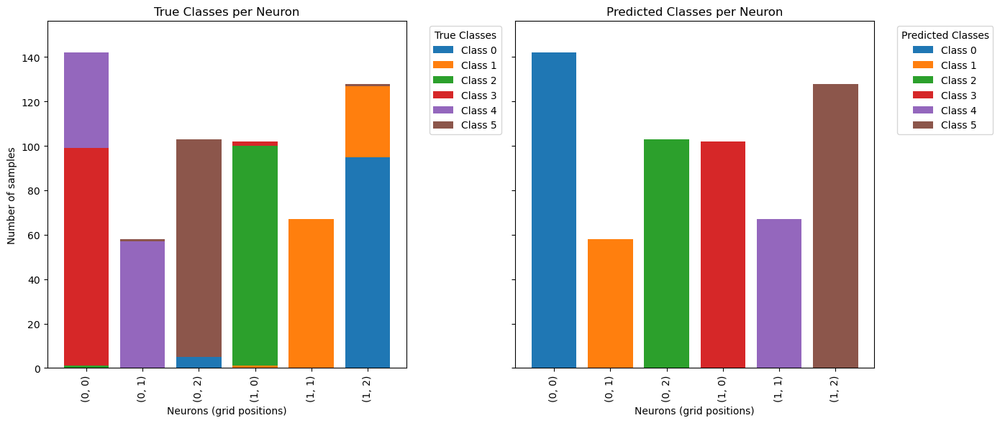


############### Neighborhood function: gaussian. M = 3, N = 3. Sigma: 0.1. ###############

Number of original classes: 6. Number of clusters detected by the network: 9.

Clustering Evaluation Metrics:
                             Metric       Value
          Adjusted Rand Index (ARI)    0.887257
Normalized Mutual Information (NMI)    0.901900
            Calinski-Harabasz Index 1285.457764
               Davies-Bouldin Index    0.708027
                   Silhouette Score    0.465514


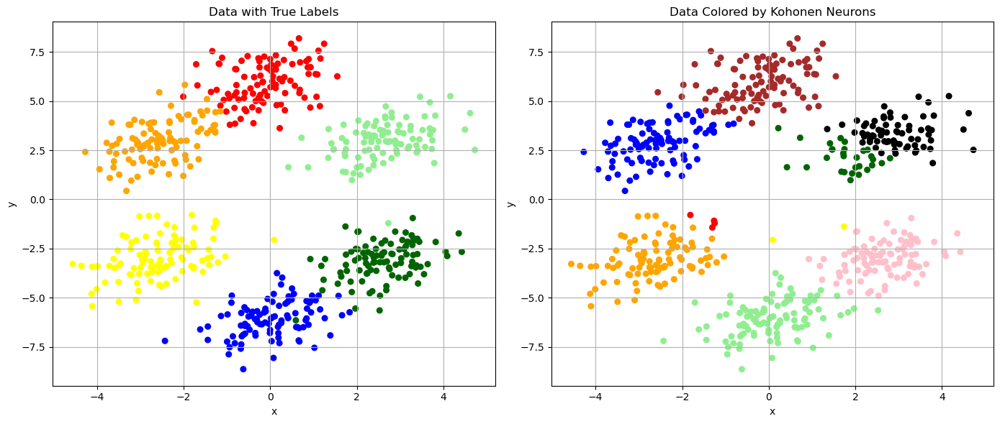

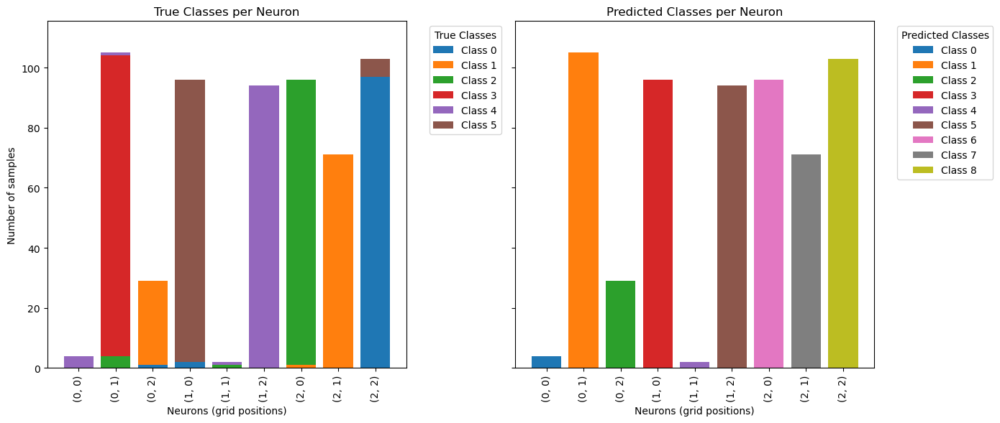


############### Neighborhood function: gaussian. M = 3, N = 3. Sigma: 0.5. ###############

Number of original classes: 6. Number of clusters detected by the network: 9.

Clustering Evaluation Metrics:
                             Metric       Value
          Adjusted Rand Index (ARI)    0.880961
Normalized Mutual Information (NMI)    0.898617
            Calinski-Harabasz Index 1296.152136
               Davies-Bouldin Index    0.761304
                   Silhouette Score    0.489133


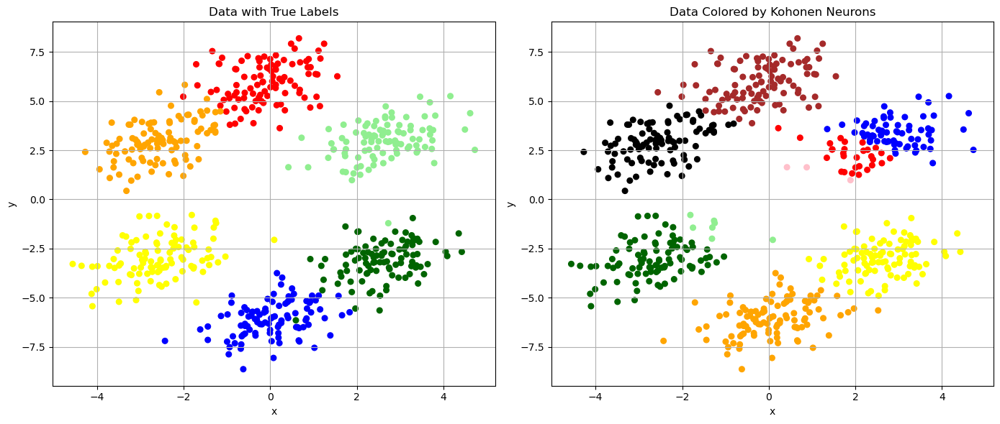

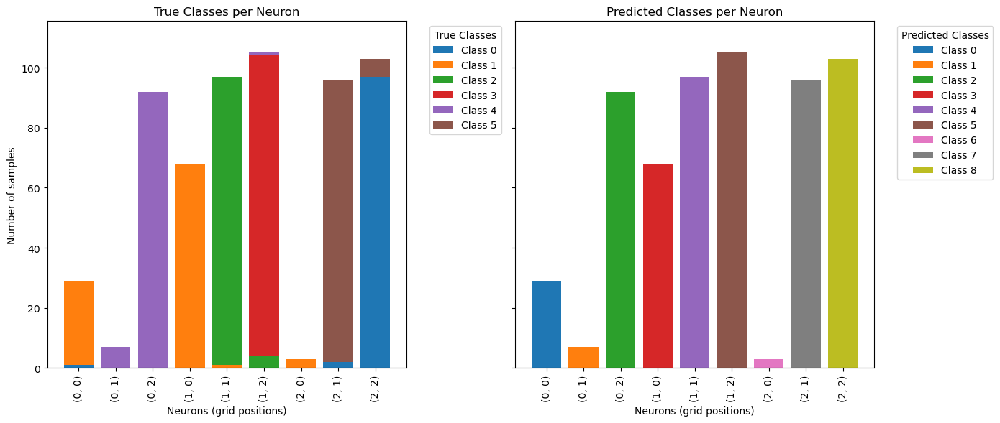


############### Neighborhood function: gaussian. M = 3, N = 3. Sigma: 1.0. ###############

Number of original classes: 6. Number of clusters detected by the network: 9.

Clustering Evaluation Metrics:
                             Metric       Value
          Adjusted Rand Index (ARI)    0.898879
Normalized Mutual Information (NMI)    0.900716
            Calinski-Harabasz Index 1263.001779
               Davies-Bouldin Index    0.923265
                   Silhouette Score    0.516821


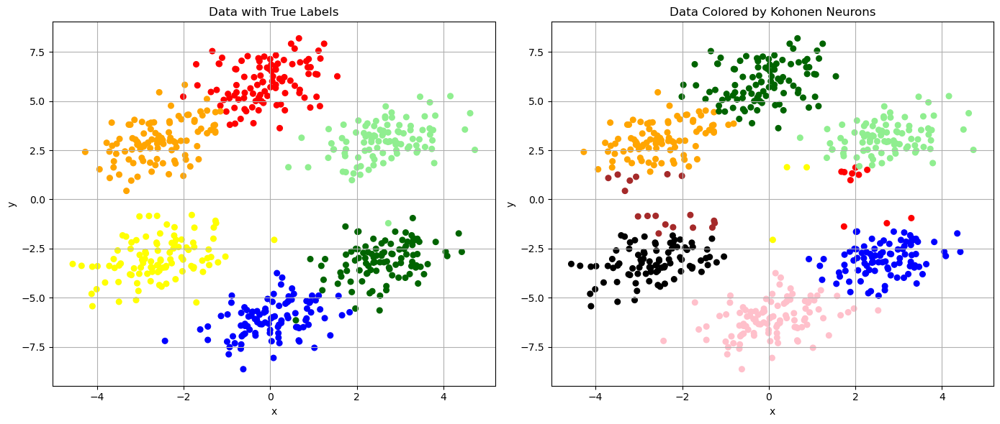

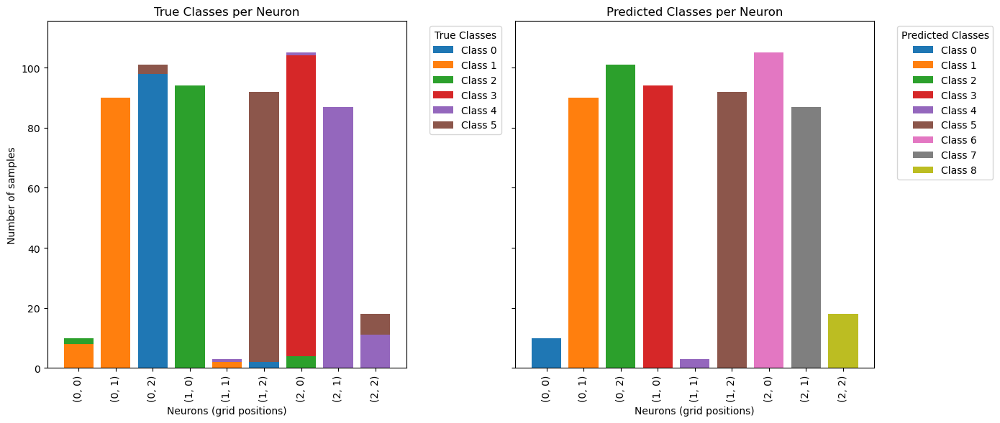


############### Neighborhood function: gaussian. M = 3, N = 3. Sigma: 10.0. ###############

Number of original classes: 6. Number of clusters detected by the network: 9.

Clustering Evaluation Metrics:
                             Metric       Value
          Adjusted Rand Index (ARI)    0.901761
Normalized Mutual Information (NMI)    0.902816
            Calinski-Harabasz Index 1239.684960
               Davies-Bouldin Index    0.905864
                   Silhouette Score    0.513213


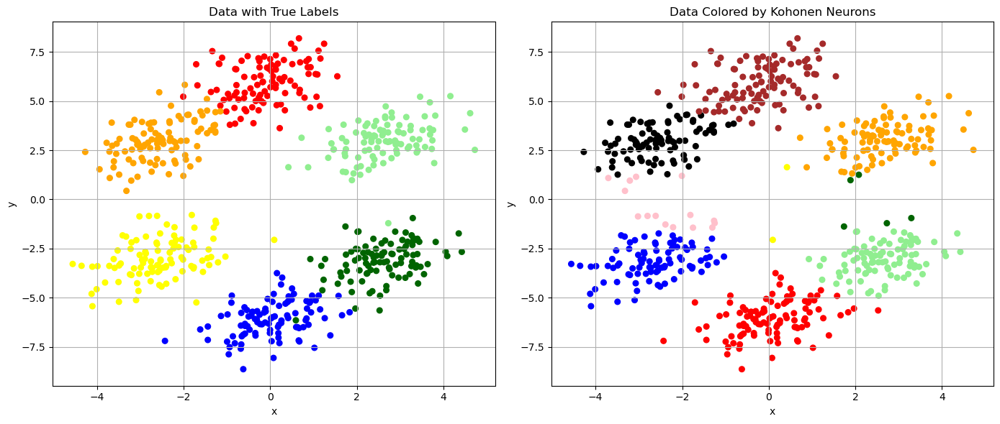

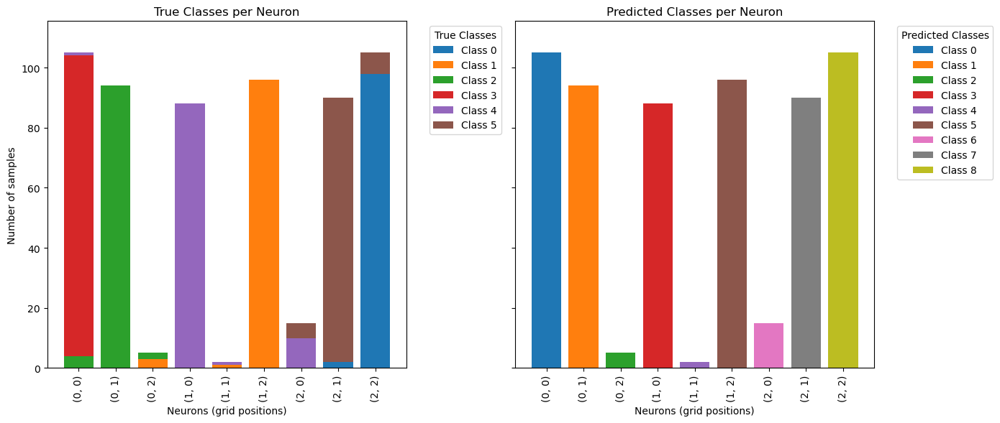


############### Neighborhood function: gaussian. M = 10, N = 10. Sigma: 0.1. ###############

Number of original classes: 6. Number of clusters detected by the network: 12.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.885112
Normalized Mutual Information (NMI)   0.898755
            Calinski-Harabasz Index 937.002765
               Davies-Bouldin Index   0.601732
                   Silhouette Score   0.417830


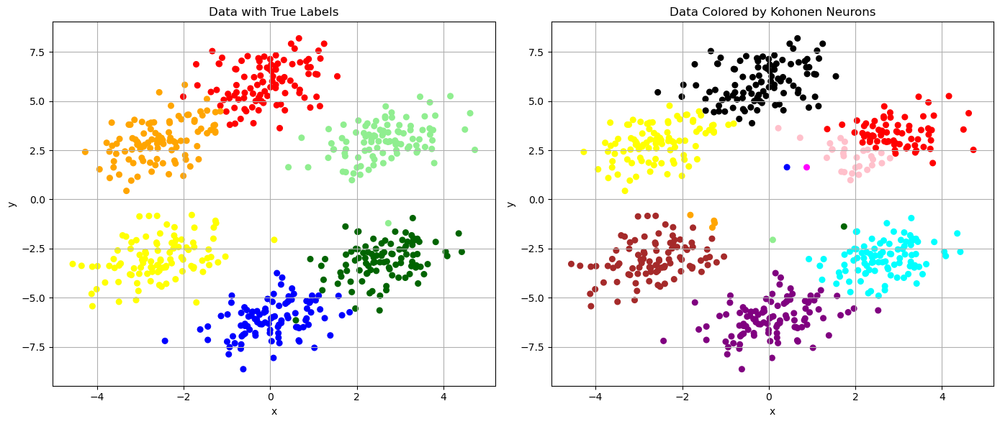

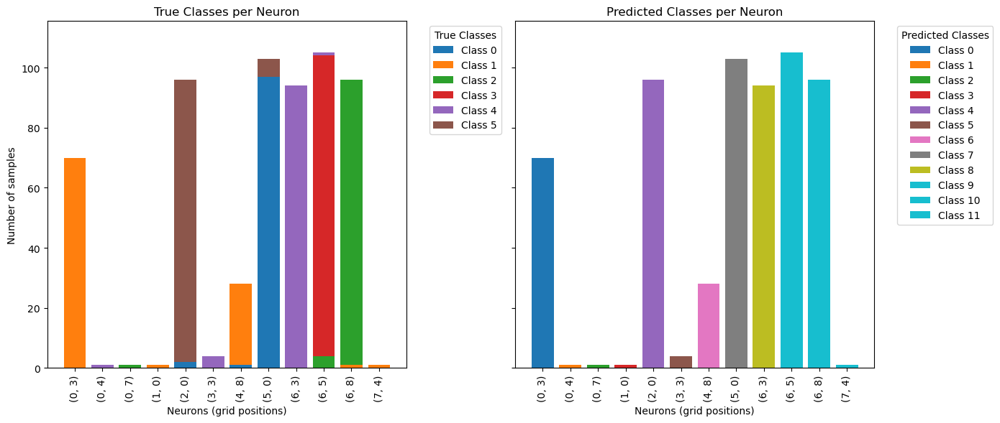


############### Neighborhood function: gaussian. M = 10, N = 10. Sigma: 0.5. ###############

Number of original classes: 6. Number of clusters detected by the network: 14.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.775623
Normalized Mutual Information (NMI)   0.834608
            Calinski-Harabasz Index 992.495276
               Davies-Bouldin Index   0.752170
                   Silhouette Score   0.337106


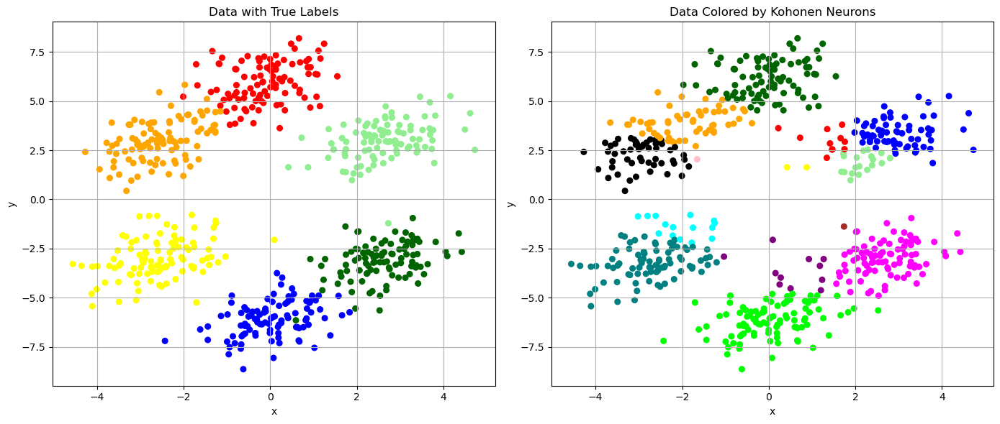

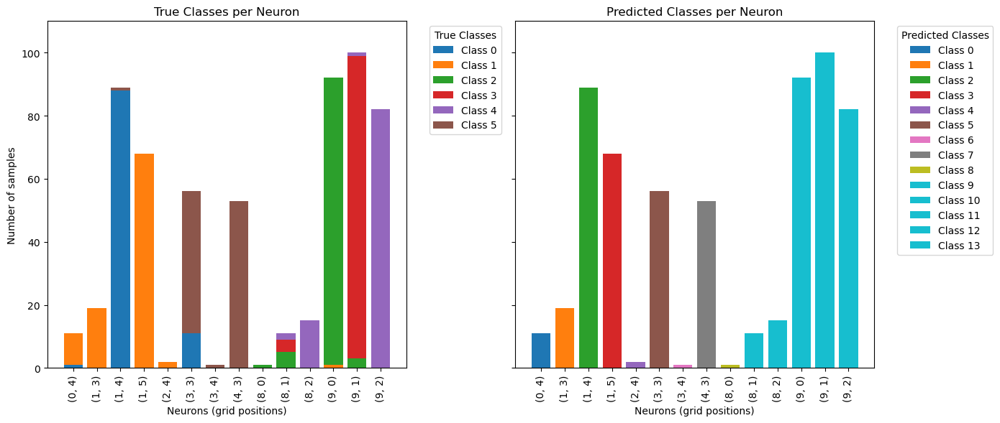


############### Neighborhood function: gaussian. M = 10, N = 10. Sigma: 1.0. ###############

Number of original classes: 6. Number of clusters detected by the network: 45.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.261808
Normalized Mutual Information (NMI)   0.646676
            Calinski-Harabasz Index 909.351639
               Davies-Bouldin Index   0.879282
                   Silhouette Score   0.250946


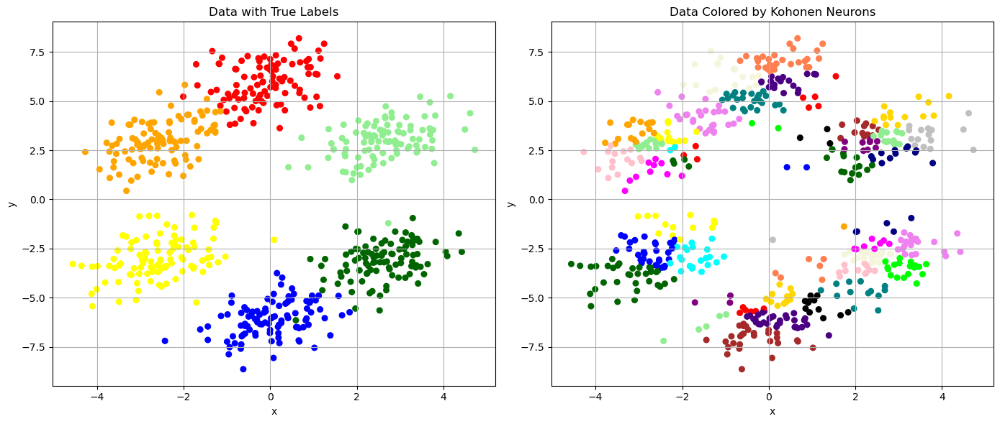

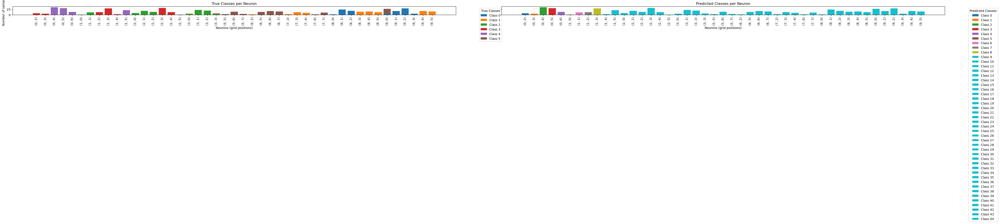


############### Neighborhood function: gaussian. M = 10, N = 10. Sigma: 10.0. ###############

Number of original classes: 6. Number of clusters detected by the network: 82.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.193317
Normalized Mutual Information (NMI)   0.600958
            Calinski-Harabasz Index 592.285630
               Davies-Bouldin Index   0.899697
                   Silhouette Score   0.162816


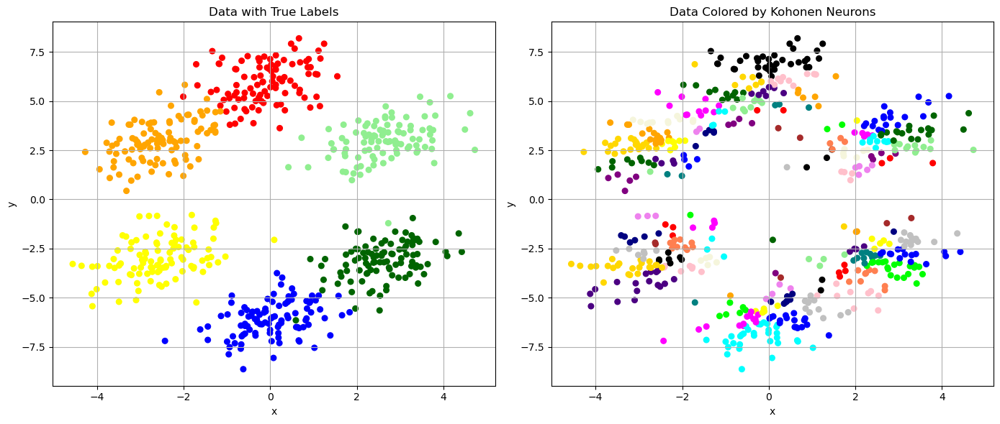

C:\Users\flang\AppData\Local\Temp\ipykernel_17760\1167224659.py:339: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


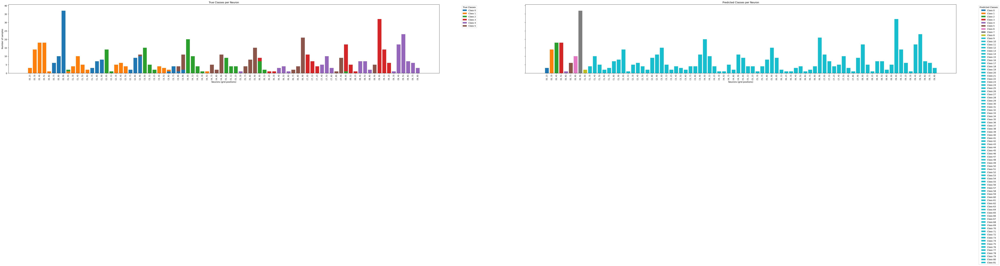


############### Neighborhood function: mexican_hat. M = 2, N = 2. Sigma: 0.1. ###############

Number of original classes: 6. Number of clusters detected by the network: 4.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.536059
Normalized Mutual Information (NMI)   0.752479
            Calinski-Harabasz Index 809.764077
               Davies-Bouldin Index   0.555826
                   Silhouette Score   0.523288


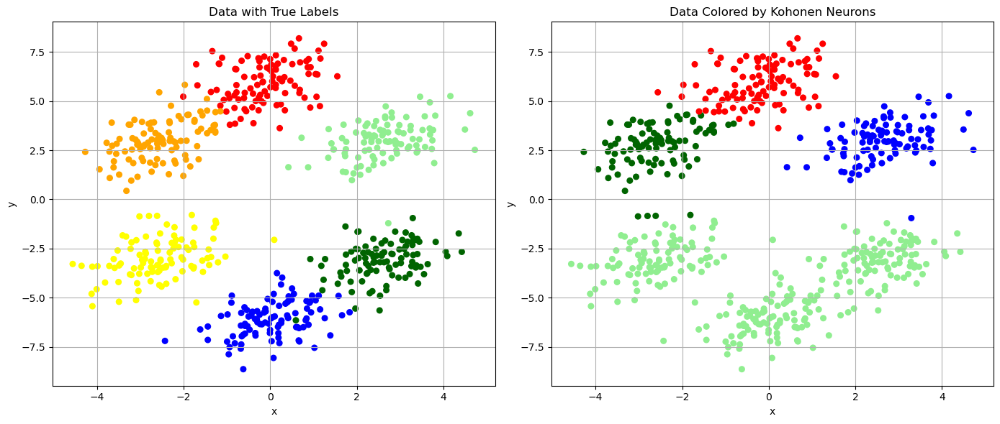

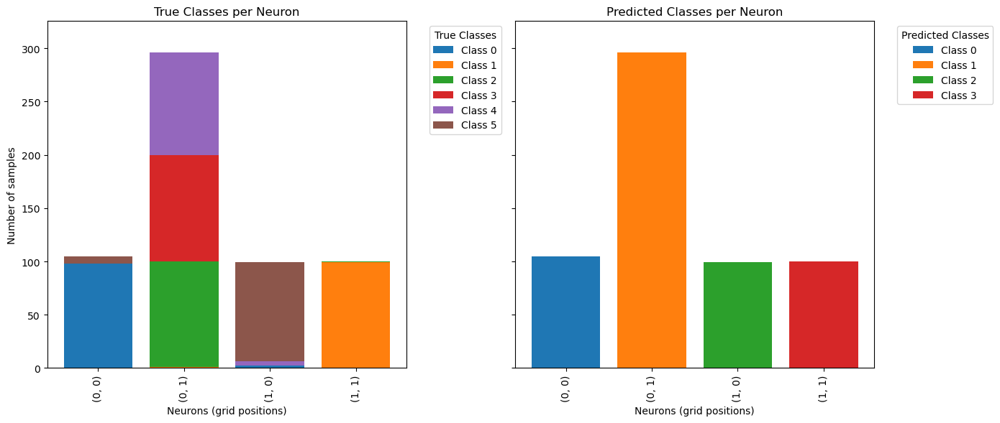


############### Neighborhood function: mexican_hat. M = 2, N = 2. Sigma: 0.5. ###############

Number of original classes: 6. Number of clusters detected by the network: 2.

Clustering Evaluation Metrics:
                             Metric       Value
          Adjusted Rand Index (ARI)    0.329261
Normalized Mutual Information (NMI)    0.550370
            Calinski-Harabasz Index 1203.330761
               Davies-Bouldin Index    0.669114
                   Silhouette Score    0.575867


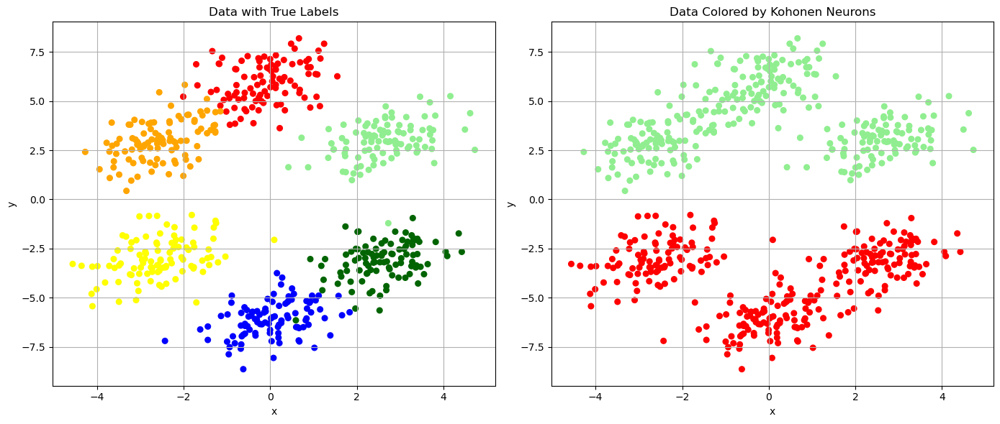

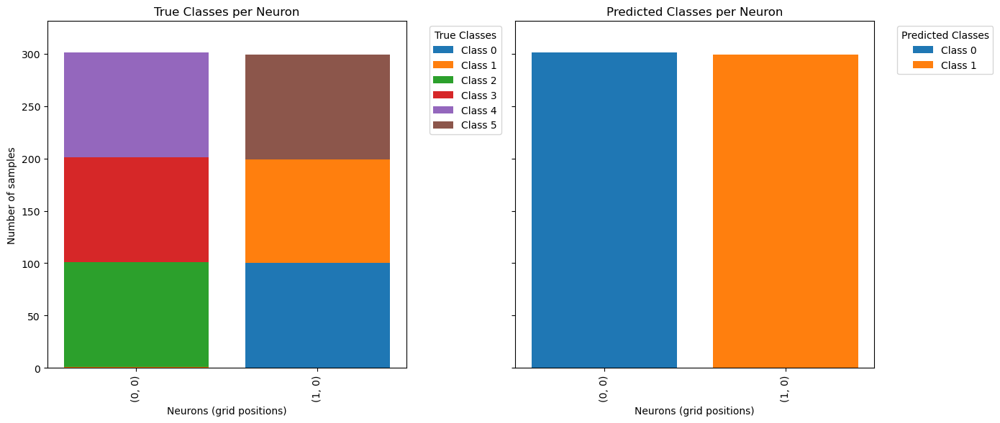


############### Neighborhood function: mexican_hat. M = 2, N = 2. Sigma: 1.0. ###############

Number of original classes: 6. Number of clusters detected by the network: 1.

Clustering Evaluation Metrics:
                             Metric  Value
          Adjusted Rand Index (ARI)    0.0
Normalized Mutual Information (NMI)    0.0
            Calinski-Harabasz Index    NaN
               Davies-Bouldin Index    NaN
                   Silhouette Score    NaN


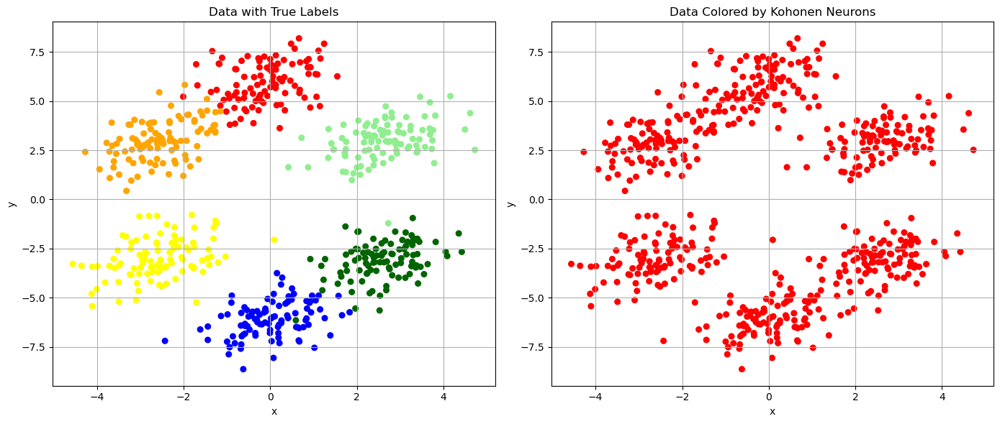

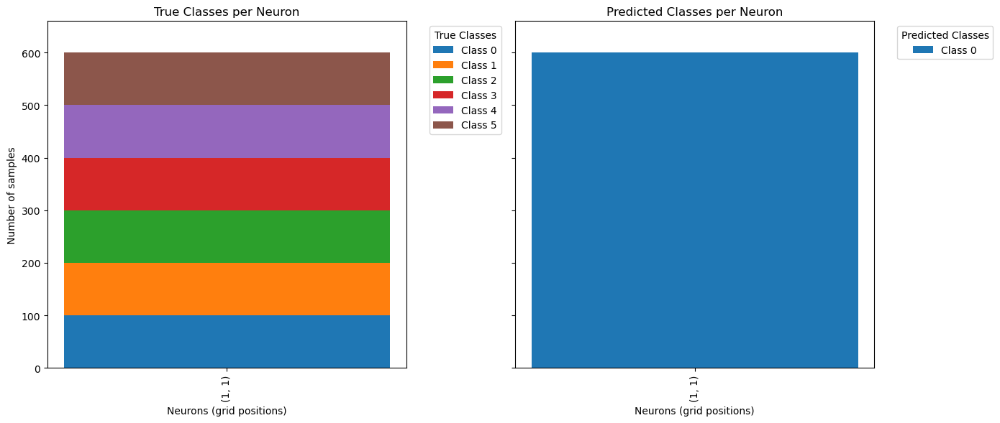


############### Neighborhood function: mexican_hat. M = 2, N = 2. Sigma: 10.0. ###############

Number of original classes: 6. Number of clusters detected by the network: 2.

Clustering Evaluation Metrics:
                             Metric       Value
          Adjusted Rand Index (ARI)    0.329261
Normalized Mutual Information (NMI)    0.550370
            Calinski-Harabasz Index 1203.330761
               Davies-Bouldin Index    0.669114
                   Silhouette Score    0.575867


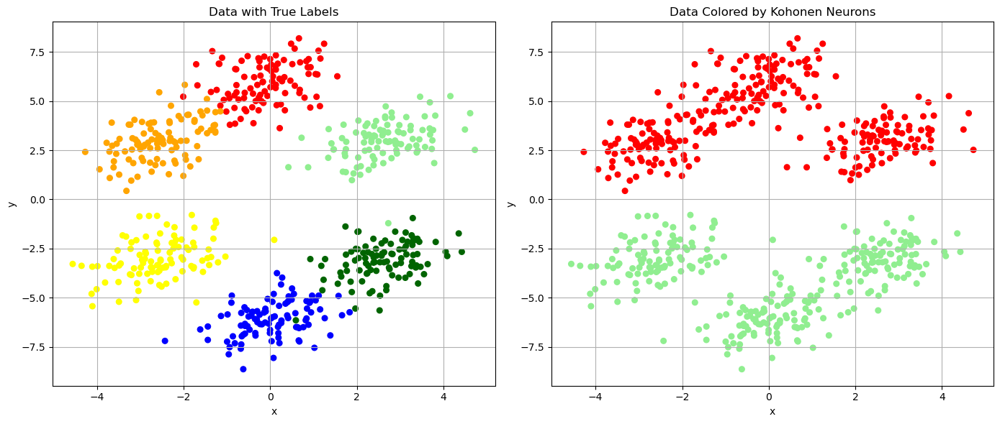

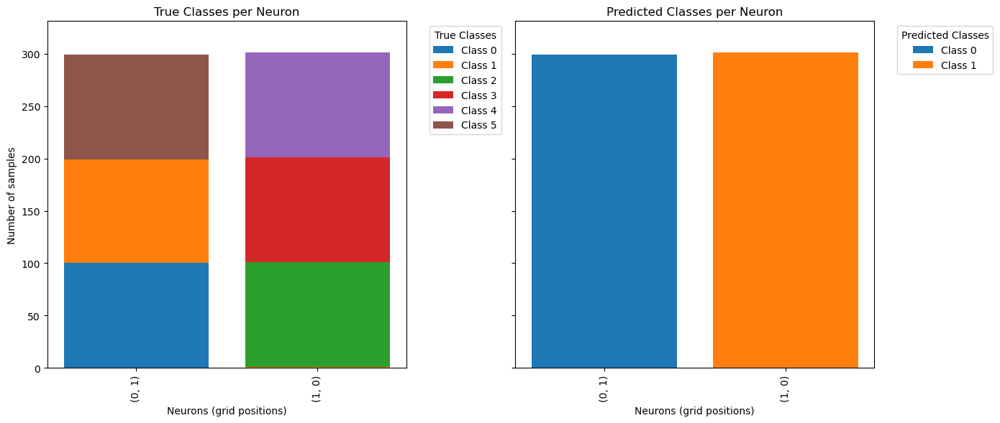


############### Neighborhood function: mexican_hat. M = 2, N = 3. Sigma: 0.1. ###############

Number of original classes: 6. Number of clusters detected by the network: 6.

Clustering Evaluation Metrics:
                             Metric       Value
          Adjusted Rand Index (ARI)    0.941276
Normalized Mutual Information (NMI)    0.938366
            Calinski-Harabasz Index 1841.663551
               Davies-Bouldin Index    0.540275
                   Silhouette Score    0.598927


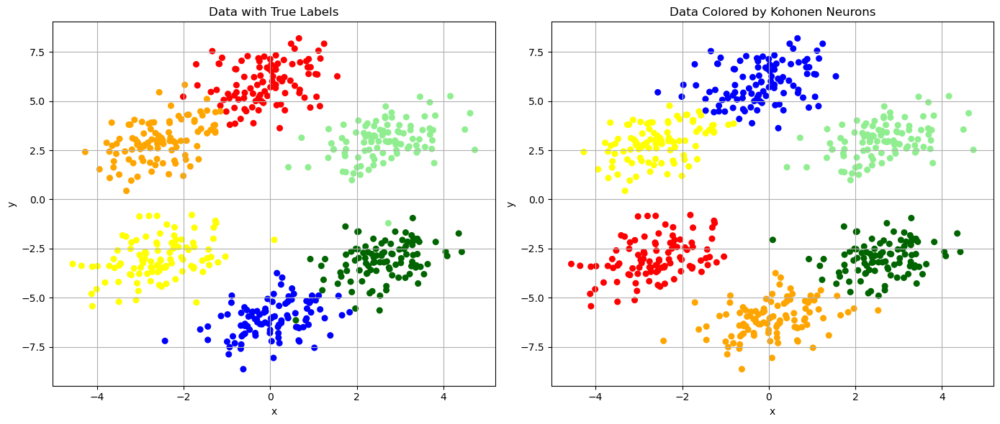

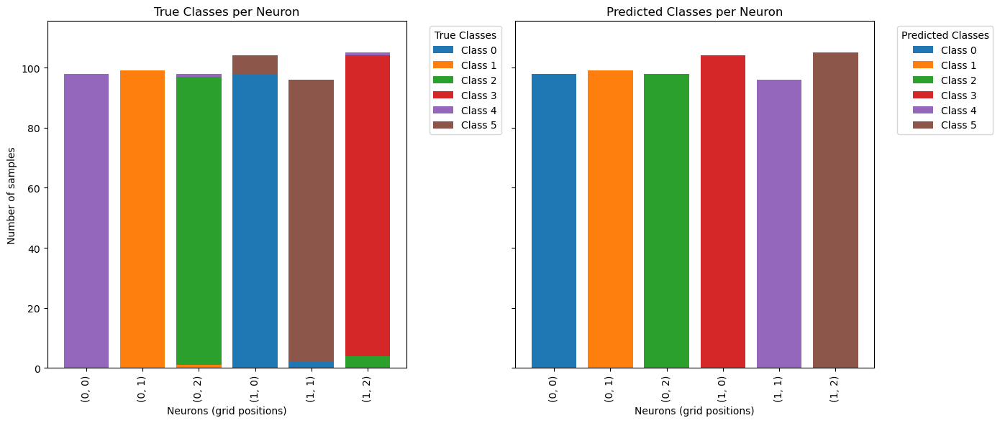


############### Neighborhood function: mexican_hat. M = 2, N = 3. Sigma: 0.5. ###############

Number of original classes: 6. Number of clusters detected by the network: 2.

Clustering Evaluation Metrics:
                             Metric       Value
          Adjusted Rand Index (ARI)    0.329261
Normalized Mutual Information (NMI)    0.550370
            Calinski-Harabasz Index 1203.330761
               Davies-Bouldin Index    0.669114
                   Silhouette Score    0.575867


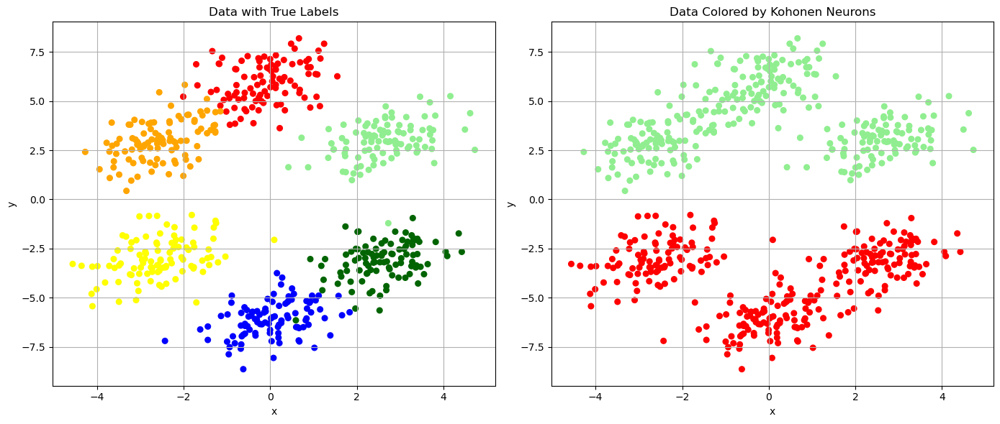

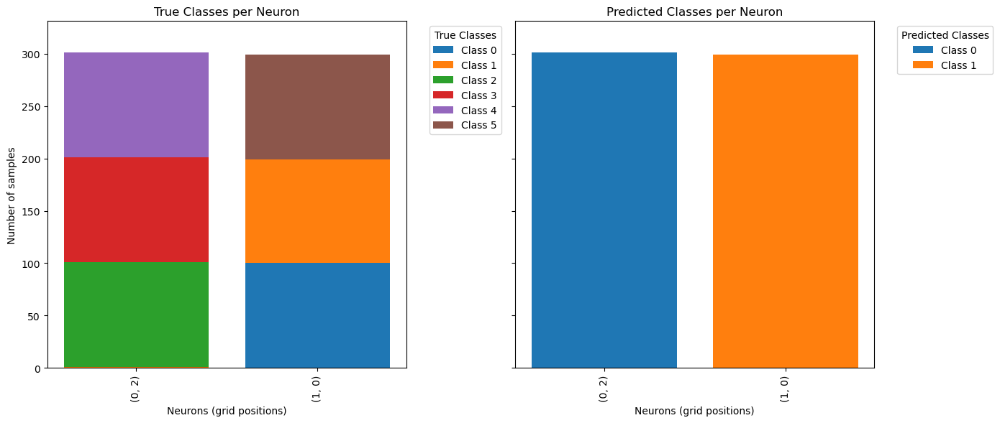


############### Neighborhood function: mexican_hat. M = 2, N = 3. Sigma: 1.0. ###############

Number of original classes: 6. Number of clusters detected by the network: 1.

Clustering Evaluation Metrics:
                             Metric  Value
          Adjusted Rand Index (ARI)    0.0
Normalized Mutual Information (NMI)    0.0
            Calinski-Harabasz Index    NaN
               Davies-Bouldin Index    NaN
                   Silhouette Score    NaN


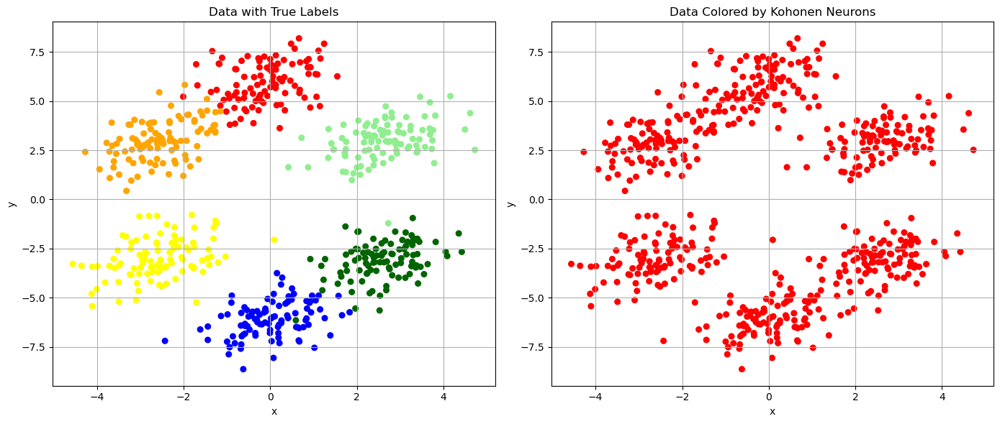

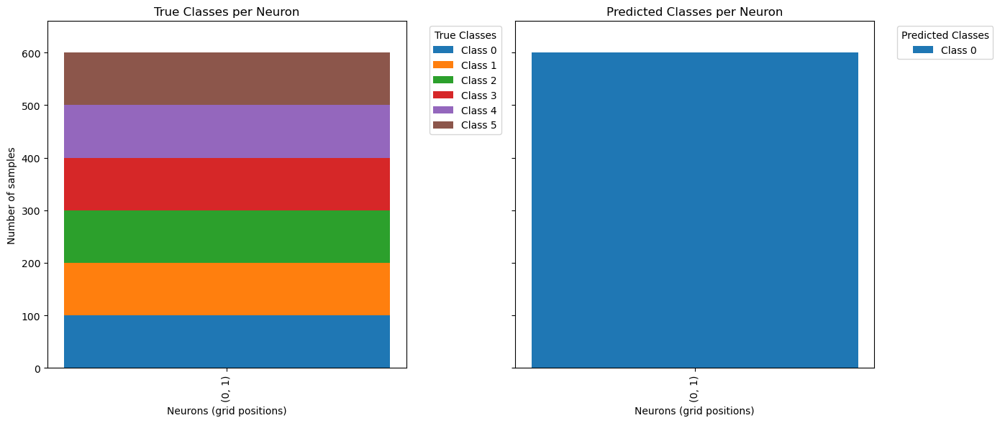


############### Neighborhood function: mexican_hat. M = 2, N = 3. Sigma: 10.0. ###############

Number of original classes: 6. Number of clusters detected by the network: 2.

Clustering Evaluation Metrics:
                             Metric       Value
          Adjusted Rand Index (ARI)    0.329261
Normalized Mutual Information (NMI)    0.550370
            Calinski-Harabasz Index 1203.330761
               Davies-Bouldin Index    0.669114
                   Silhouette Score    0.575867


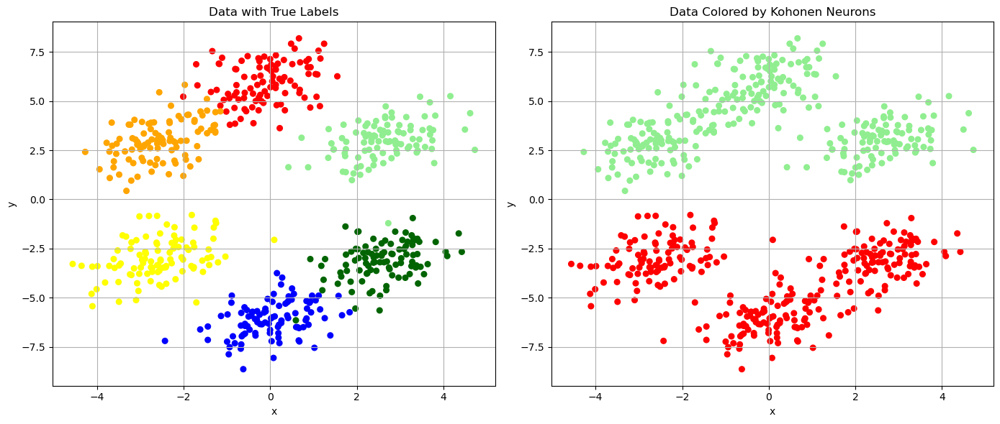

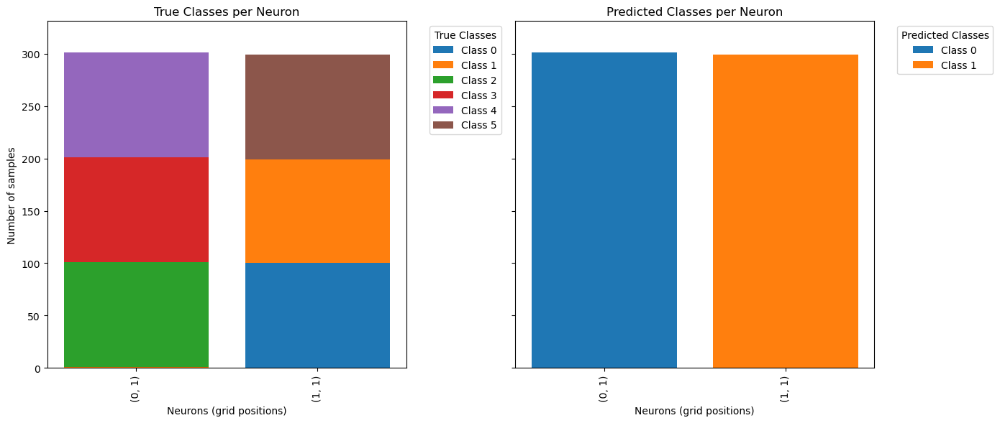


############### Neighborhood function: mexican_hat. M = 3, N = 3. Sigma: 0.1. ###############

Number of original classes: 6. Number of clusters detected by the network: 9.

Clustering Evaluation Metrics:
                             Metric       Value
          Adjusted Rand Index (ARI)    0.892930
Normalized Mutual Information (NMI)    0.907186
            Calinski-Harabasz Index 1256.089708
               Davies-Bouldin Index    0.638120
                   Silhouette Score    0.480633


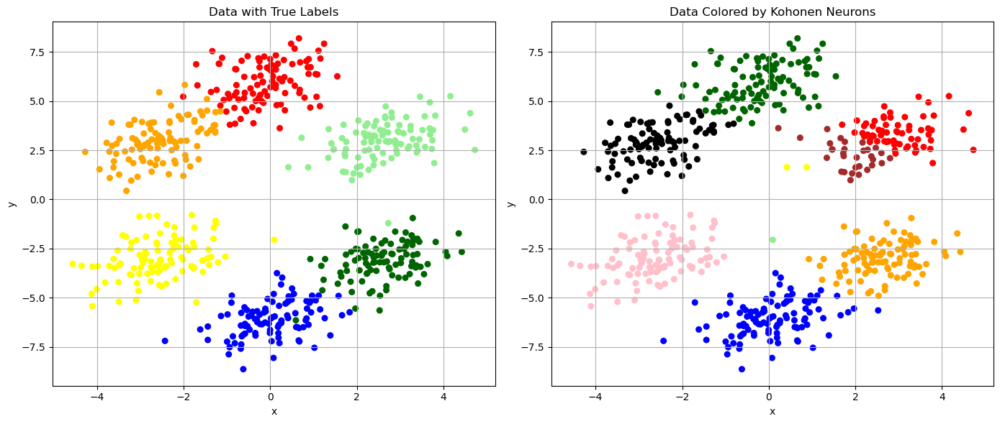

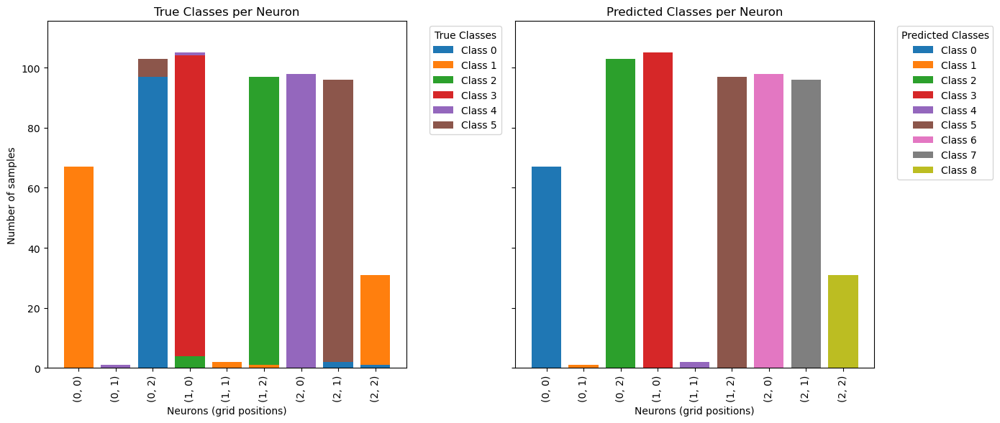


############### Neighborhood function: mexican_hat. M = 3, N = 3. Sigma: 0.5. ###############

Number of original classes: 6. Number of clusters detected by the network: 3.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.450725
Normalized Mutual Information (NMI)   0.663010
            Calinski-Harabasz Index 879.787519
               Davies-Bouldin Index   0.769047
                   Silhouette Score   0.482851


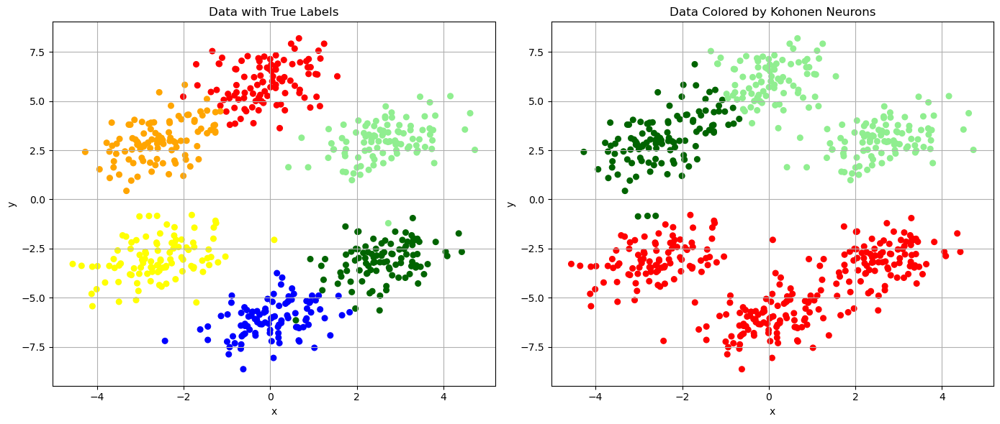

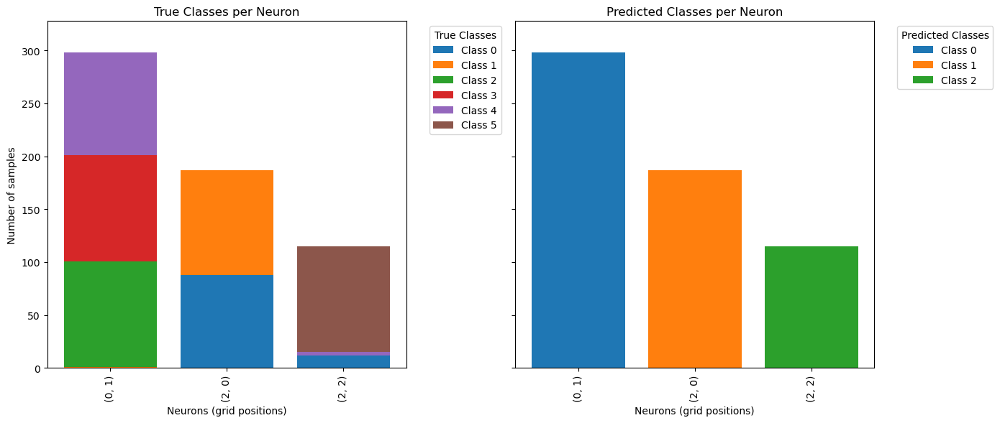


############### Neighborhood function: mexican_hat. M = 3, N = 3. Sigma: 1.0. ###############

Number of original classes: 6. Number of clusters detected by the network: 1.

Clustering Evaluation Metrics:
                             Metric  Value
          Adjusted Rand Index (ARI)    0.0
Normalized Mutual Information (NMI)    0.0
            Calinski-Harabasz Index    NaN
               Davies-Bouldin Index    NaN
                   Silhouette Score    NaN


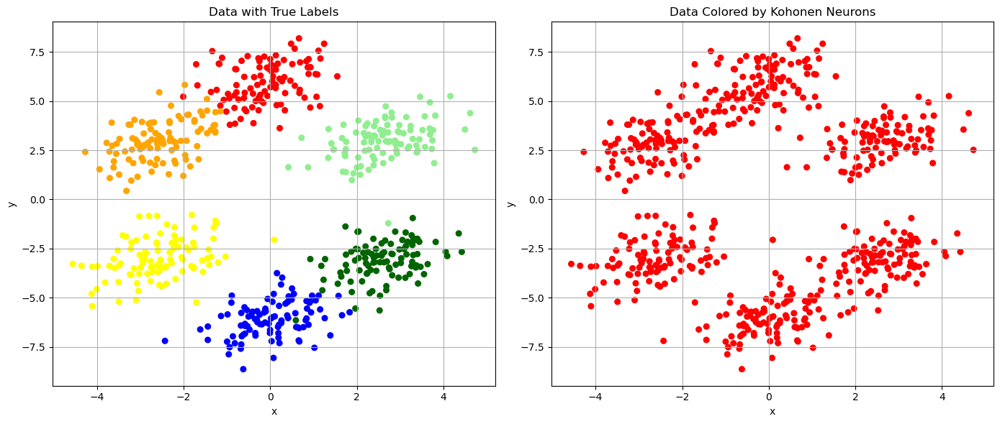

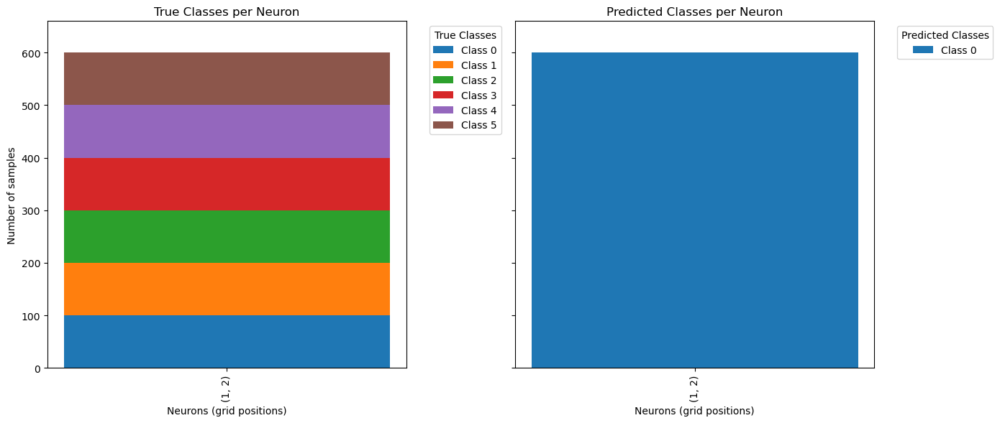


############### Neighborhood function: mexican_hat. M = 3, N = 3. Sigma: 10.0. ###############

Number of original classes: 6. Number of clusters detected by the network: 1.

Clustering Evaluation Metrics:
                             Metric  Value
          Adjusted Rand Index (ARI)    0.0
Normalized Mutual Information (NMI)    0.0
            Calinski-Harabasz Index    NaN
               Davies-Bouldin Index    NaN
                   Silhouette Score    NaN


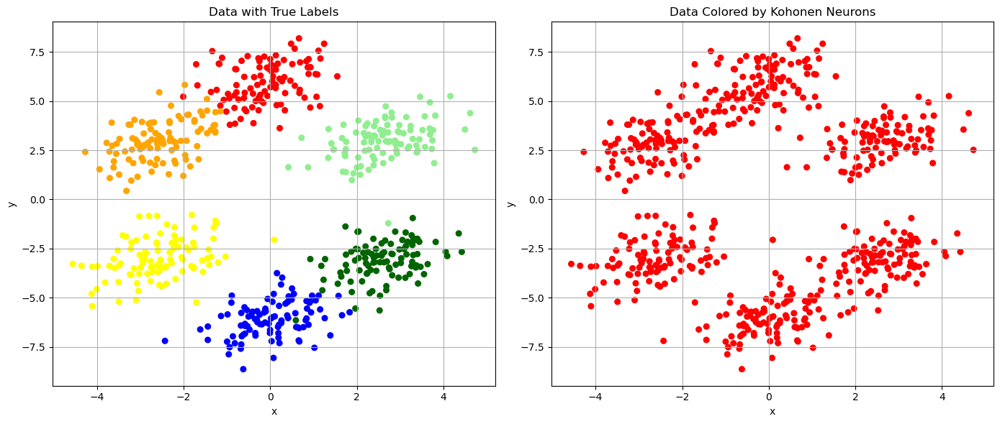

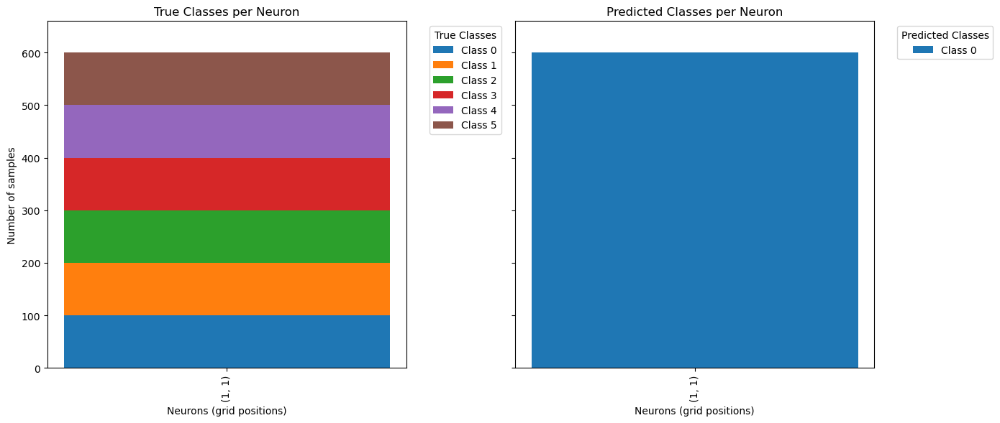


############### Neighborhood function: mexican_hat. M = 10, N = 10. Sigma: 0.1. ###############

Number of original classes: 6. Number of clusters detected by the network: 12.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.877851
Normalized Mutual Information (NMI)   0.894737
            Calinski-Harabasz Index 945.013959
               Davies-Bouldin Index   0.644784
                   Silhouette Score   0.416362


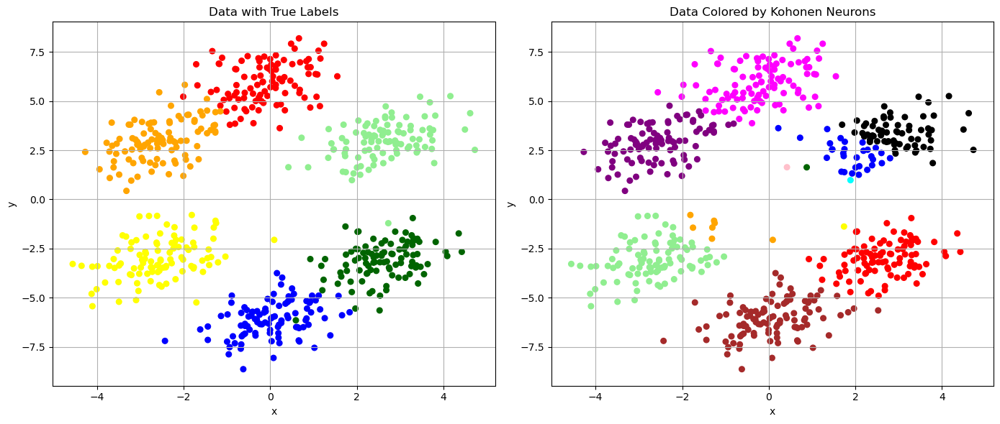

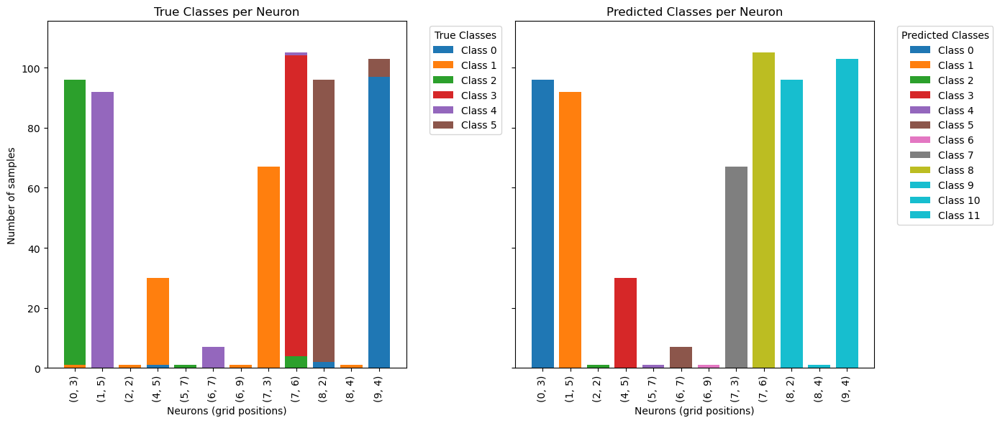


############### Neighborhood function: mexican_hat. M = 10, N = 10. Sigma: 0.5. ###############

Number of original classes: 6. Number of clusters detected by the network: 28.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.438177
Normalized Mutual Information (NMI)   0.712544
            Calinski-Harabasz Index 952.843049
               Davies-Bouldin Index   0.865522
                   Silhouette Score   0.297486


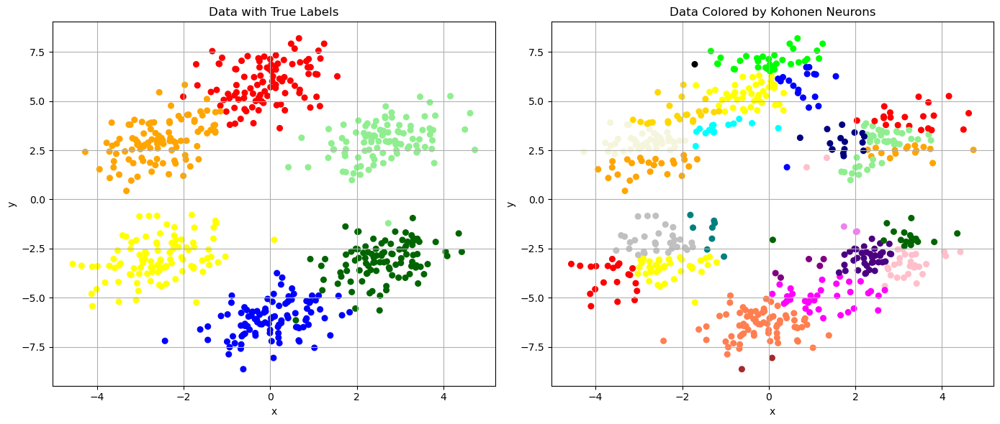

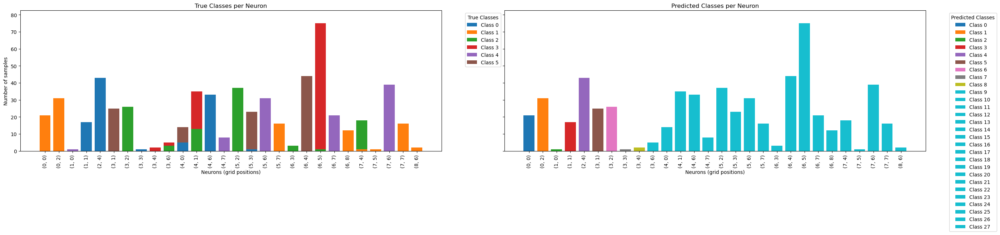


############### Neighborhood function: mexican_hat. M = 10, N = 10. Sigma: 1.0. ###############

Number of original classes: 6. Number of clusters detected by the network: 25.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.566294
Normalized Mutual Information (NMI)   0.757251
            Calinski-Harabasz Index 843.446769
               Davies-Bouldin Index   0.899694
                   Silhouette Score   0.273801


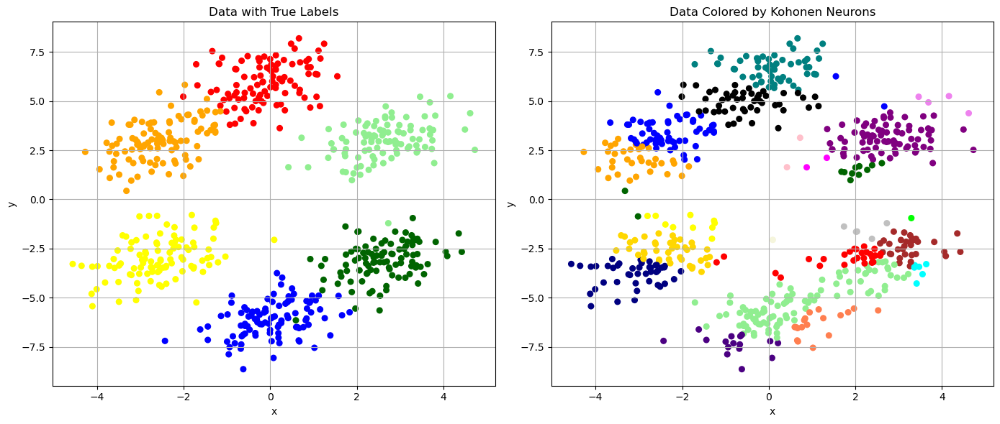

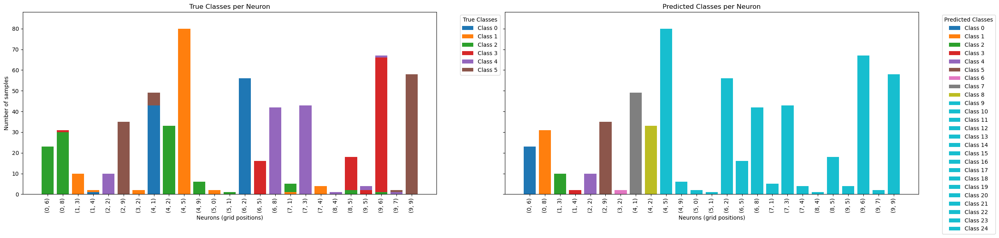


############### Neighborhood function: mexican_hat. M = 10, N = 10. Sigma: 10.0. ###############

Number of original classes: 6. Number of clusters detected by the network: 3.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.518163
Normalized Mutual Information (NMI)   0.688166
            Calinski-Harabasz Index 747.824768
               Davies-Bouldin Index   0.884030
                   Silhouette Score   0.448464


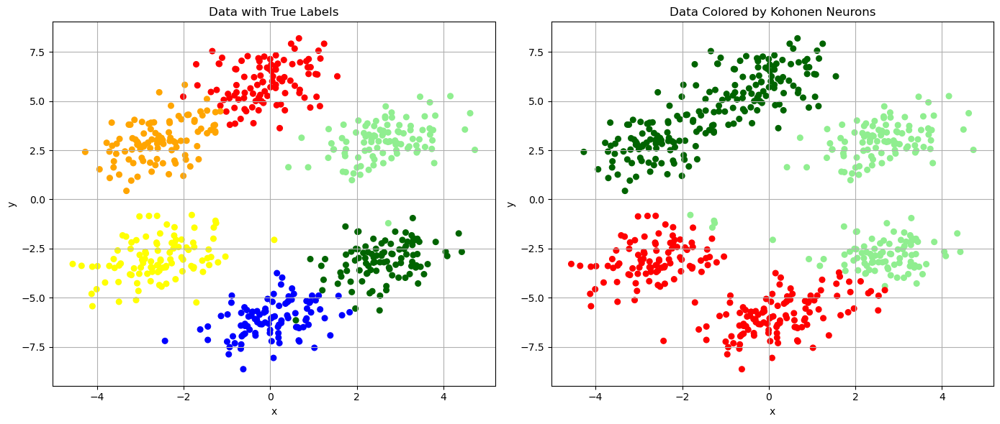

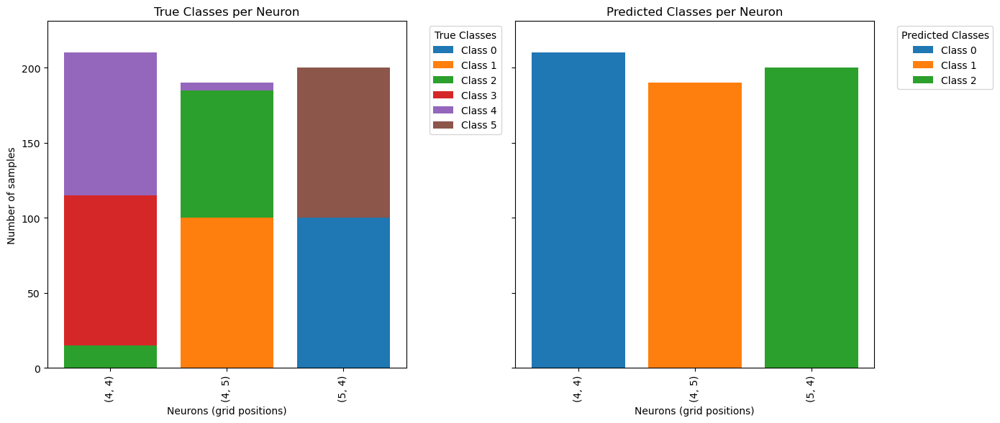

In [12]:
hexagon = pd.read_csv('data/hexagon.csv')
hexagon_X = hexagon[['x', 'y']].values 
hexagon_true_labels = hexagon['c'].values  

results = []

for function_name in neighborhood_function_names:
    for (M, N) in MNs:
        for sigma in sigmas:
            print(f"\n############### Neighborhood function: {function_name}. M = {M}, N = {N}. Sigma: {sigma}. ###############\n")
            som = KohonenNetwork(M=M, N=N)  
            som.train(hexagon_X, 
                    epochs=10, 
                    learning_rate=0.1, 
                    sigma=sigma, 
                    decay_lambda=1000, 
                    neighborhood_function=function_name, 
                    sigma_decay=True, 
                    verbose=False)

            labels_pred_hexagon = som.assign_classes(hexagon_X)  

            unique_true_classes = len(np.unique(hexagon_true_labels))
            unique_clusters = len(np.unique(labels_pred_hexagon))
            print(f"Number of original classes: {unique_true_classes}. Number of clusters detected by the network: {unique_clusters}.")

            metrics = som.evaluate_clustering(hexagon_X, hexagon_true_labels, labels_pred_hexagon)
            result = {
                'function_name': function_name,
                'M': M,
                'N': N,
                'sigma': sigma,
                'unique_clusters': unique_clusters,
                'calinski_harabasz': metrics['Calinski-Harabasz Index'],
                'davies_bouldin': metrics['Davies-Bouldin Index'],
                'silhouette': metrics['Silhouette Score'],
                'ari': metrics['Adjusted Rand Index (ARI)'],
                'nmi': metrics['Normalized Mutual Information (NMI)']
            }
            results.append(result)
            
            som.plot_data_and_clusters(hexagon_X, labels_true=hexagon_true_labels)
            som.plot_stacked_bar_neurons(hexagon_X, hexagon_true_labels, labels_pred_hexagon)
            
results_df = pd.DataFrame(results)

In [13]:
results_df

,function_name,M,N,sigma,unique_clusters,calinski_harabasz,davies_bouldin,silhouette,ari,nmi
0,gaussian,2,2,0.1,4,985.127685,0.761324,0.486986,0.665960,0.816940
1,gaussian,2,2,0.5,4,985.127685,0.761324,0.486986,0.665960,0.816940
2,gaussian,2,2,1.0,4,953.083535,0.824017,0.454623,0.645746,0.777672
3,gaussian,2,2,10.0,4,582.745719,0.872106,0.291347,0.321345,0.524383
4,gaussian,2,3,0.1,6,1841.663551,0.540275,0.598927,0.941276,0.938366
5,gaussian,2,3,0.5,6,1841.663551,0.540275,0.598927,0.941276,0.938366
6,gaussian,2,3,1.0,6,1841.663551,0.540275,0.598927,0.941276,0.938366
7,gaussian,2,3,10.0,6,1047.894828,0.743859,0.437326,0.727035,0.814624
8,gaussian,3,3,0.1,9,1285.457764,0.708027,0.465514,0.887257,0.901900
9,gaussian,3,3,0.5,9,1296.152136,0.761304,0.489133,0.880961,0.898617


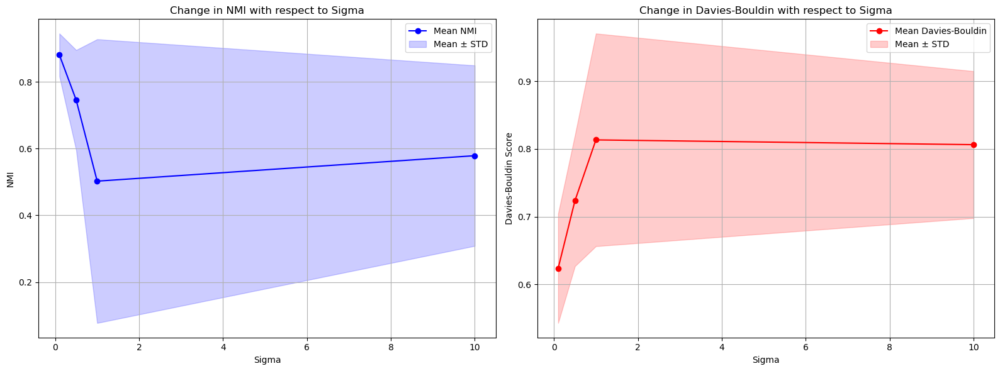

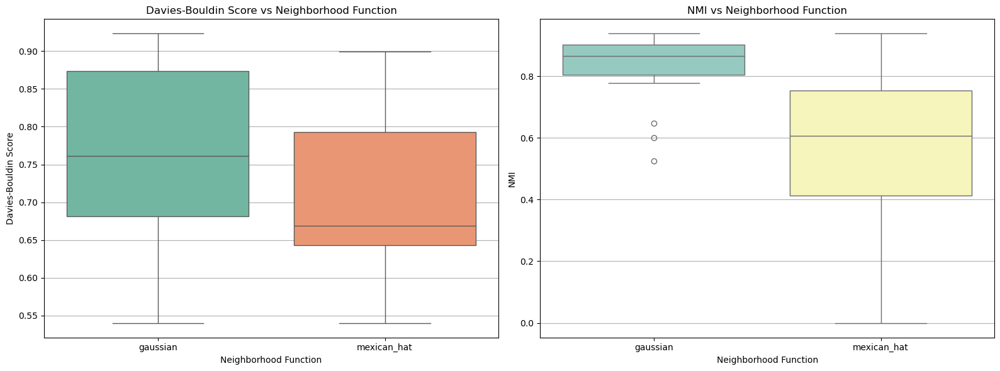

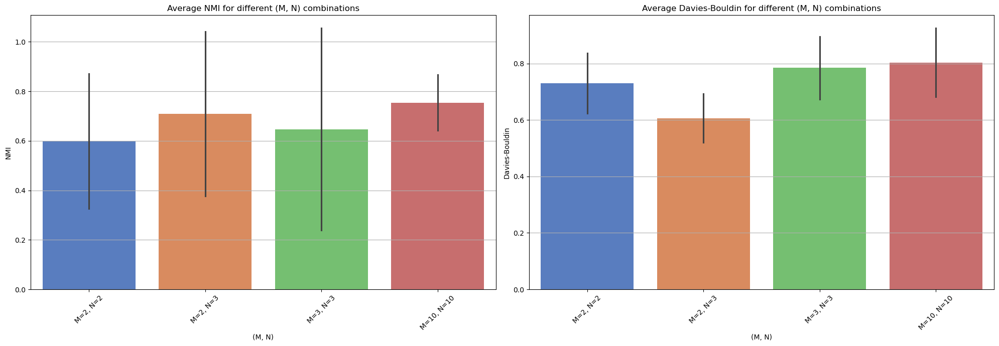

In [16]:
make_summary_plots(results_df)

# **Cube dataset**


############### Neighborhood function: gaussian. M = 2, N = 2. Sigma: 0.1. ###############

Number of original classes: 8. Number of clusters detected by the network: 4.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.413842
Normalized Mutual Information (NMI)   0.698787
            Calinski-Harabasz Index 780.365196
               Davies-Bouldin Index   0.849709
                   Silhouette Score   0.400910


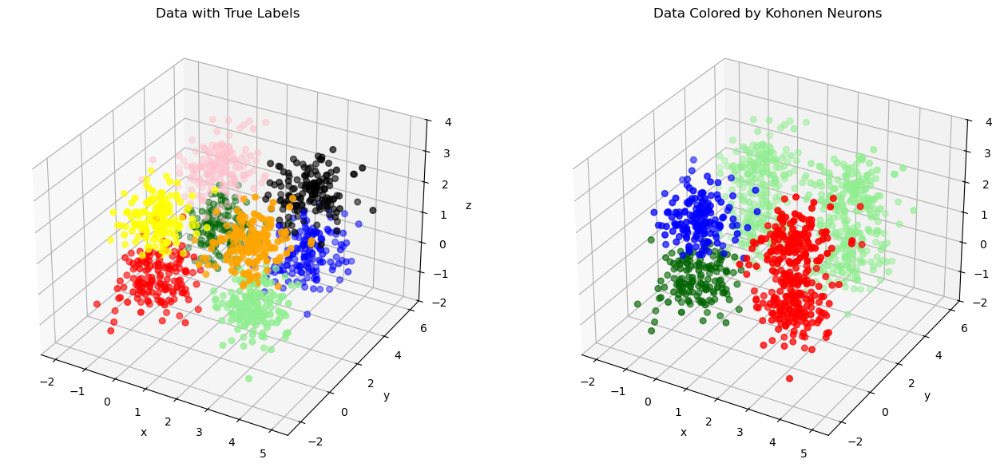

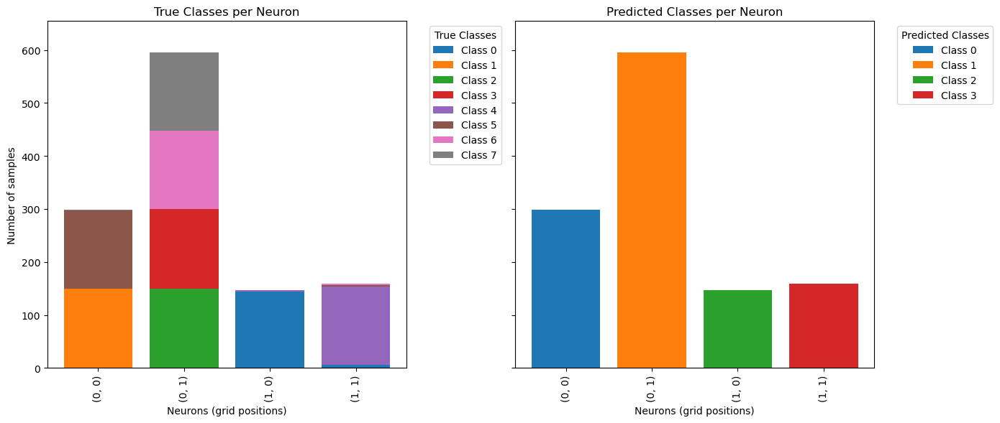


############### Neighborhood function: gaussian. M = 2, N = 2. Sigma: 0.5. ###############

Number of original classes: 8. Number of clusters detected by the network: 4.

Clustering Evaluation Metrics:
                             Metric       Value
          Adjusted Rand Index (ARI)    0.593283
Normalized Mutual Information (NMI)    0.789110
            Calinski-Harabasz Index 1278.632587
               Davies-Bouldin Index    0.878862
                   Silhouette Score    0.469373


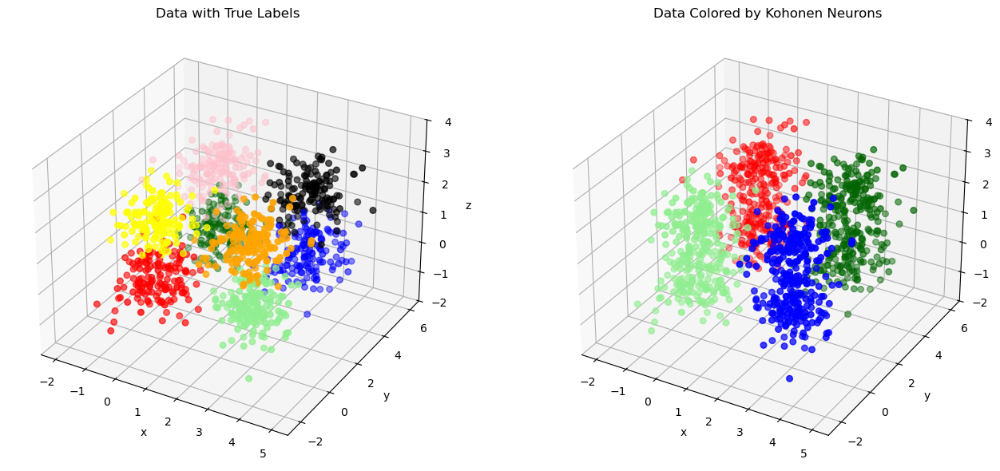

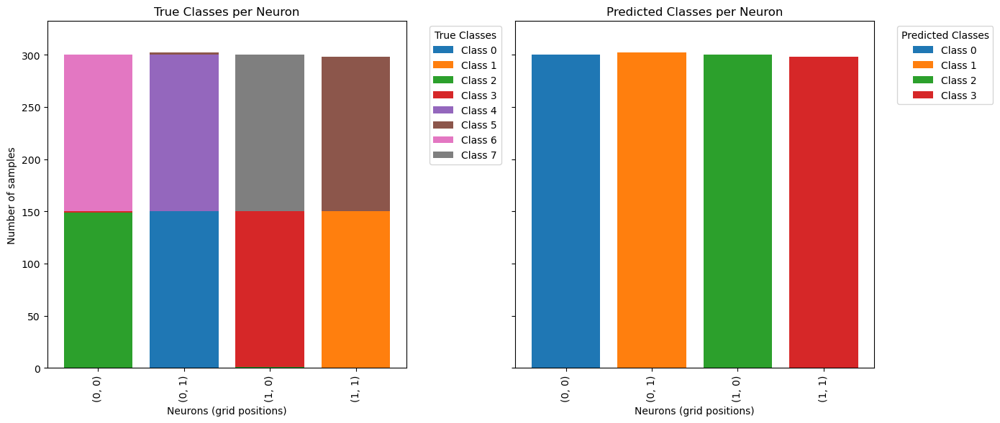


############### Neighborhood function: gaussian. M = 2, N = 2. Sigma: 1.0. ###############

Number of original classes: 8. Number of clusters detected by the network: 4.

Clustering Evaluation Metrics:
                             Metric       Value
          Adjusted Rand Index (ARI)    0.593283
Normalized Mutual Information (NMI)    0.789110
            Calinski-Harabasz Index 1278.632587
               Davies-Bouldin Index    0.878862
                   Silhouette Score    0.469373


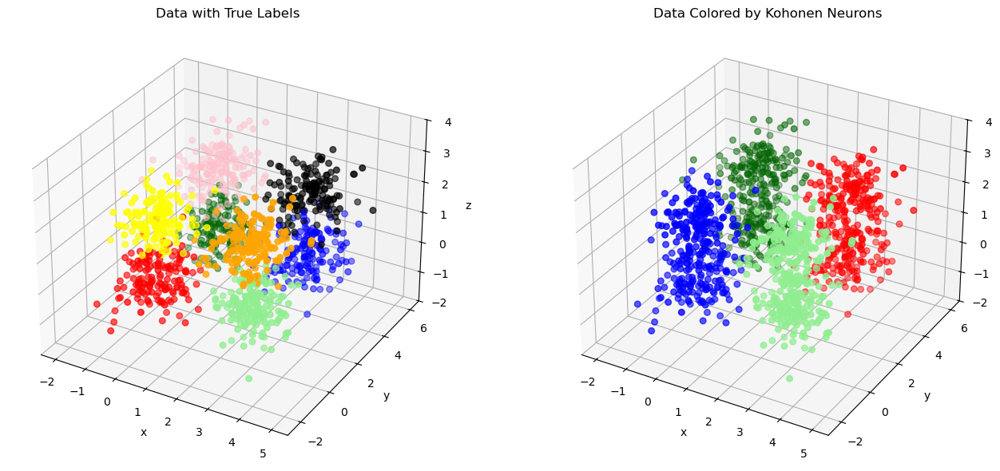

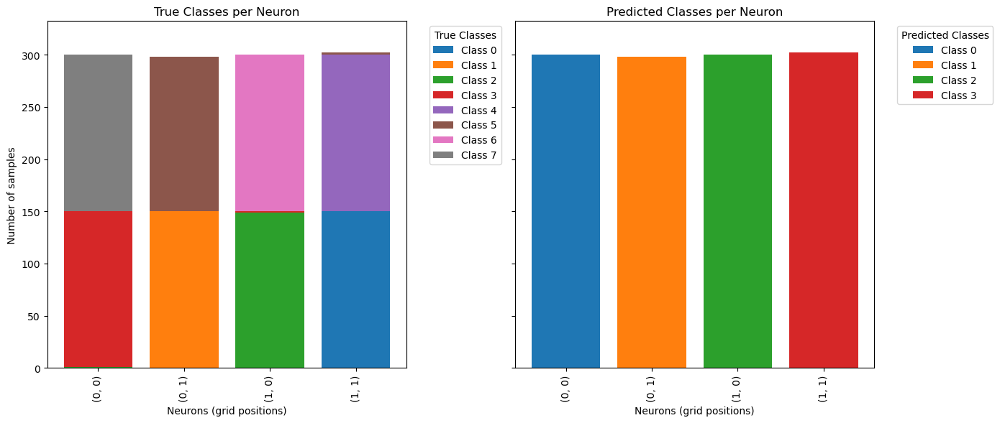


############### Neighborhood function: gaussian. M = 2, N = 2. Sigma: 10.0. ###############

Number of original classes: 8. Number of clusters detected by the network: 4.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.237512
Normalized Mutual Information (NMI)   0.453055
            Calinski-Harabasz Index 442.672785
               Davies-Bouldin Index   1.384172
                   Silhouette Score   0.084942


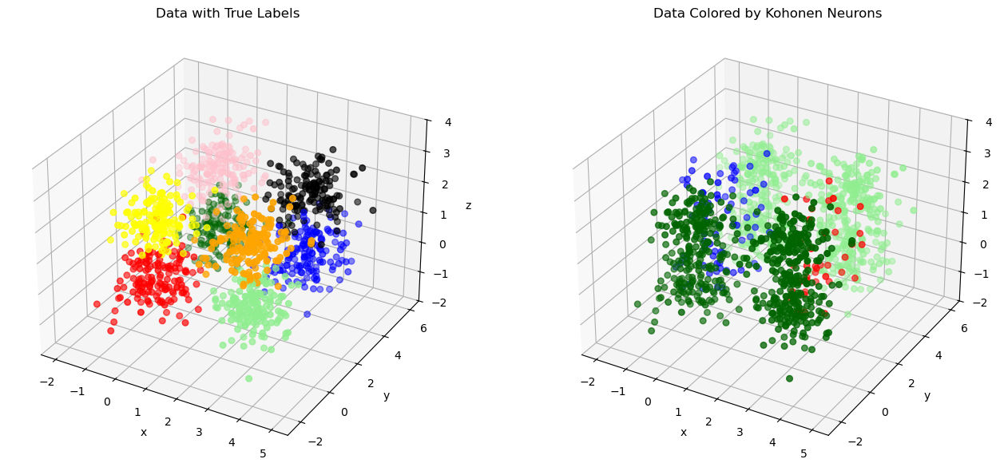

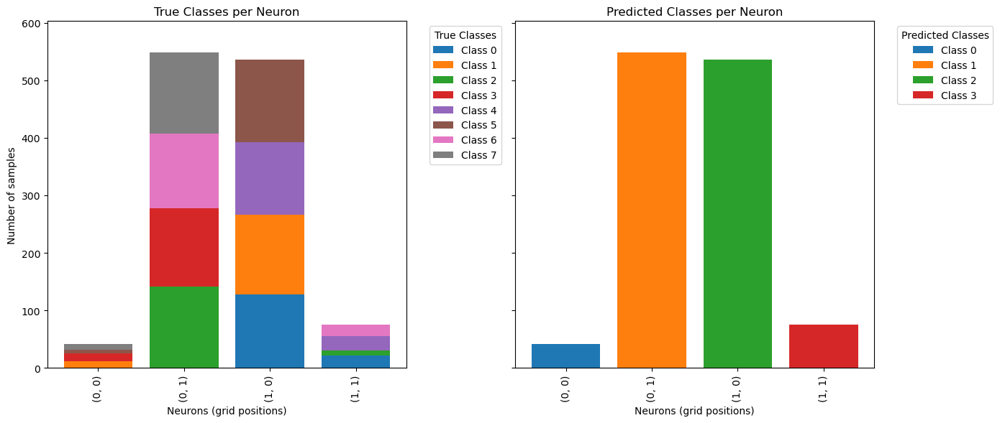


############### Neighborhood function: gaussian. M = 2, N = 4. Sigma: 0.1. ###############

Number of original classes: 8. Number of clusters detected by the network: 8.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.675419
Normalized Mutual Information (NMI)   0.825085
            Calinski-Harabasz Index 833.560999
               Davies-Bouldin Index   1.126645
                   Silhouette Score   0.387399


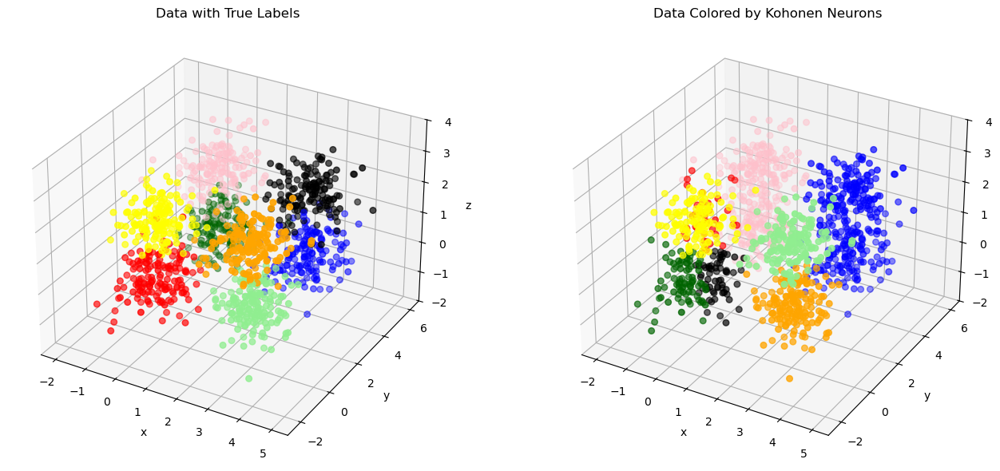

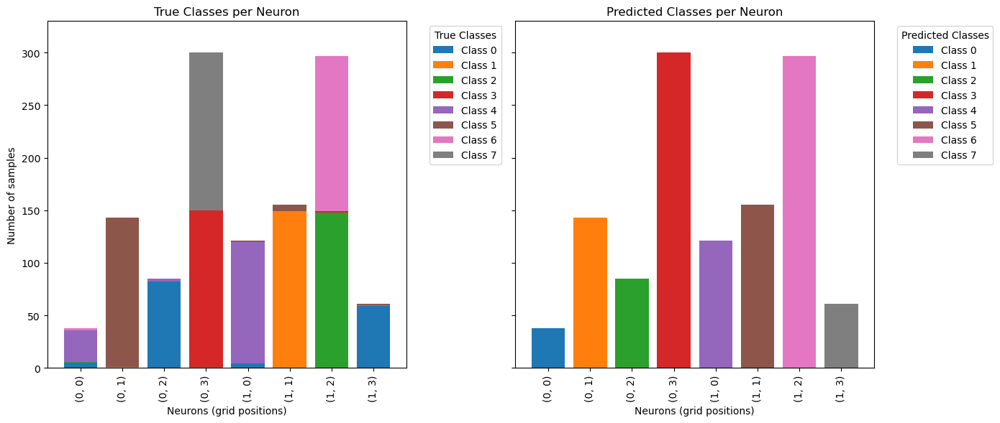


############### Neighborhood function: gaussian. M = 2, N = 4. Sigma: 0.5. ###############

Number of original classes: 8. Number of clusters detected by the network: 8.

Clustering Evaluation Metrics:
                             Metric       Value
          Adjusted Rand Index (ARI)    0.784248
Normalized Mutual Information (NMI)    0.876154
            Calinski-Harabasz Index 1030.663700
               Davies-Bouldin Index    1.014767
                   Silhouette Score    0.399891


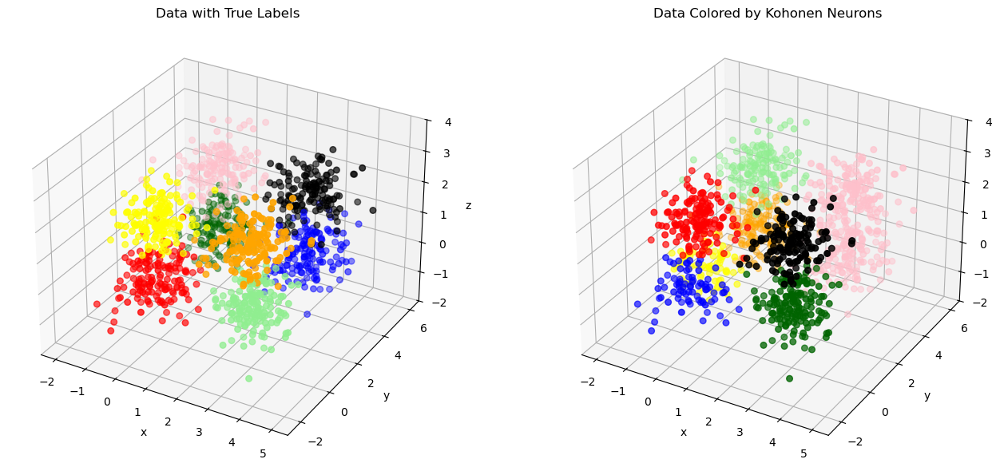

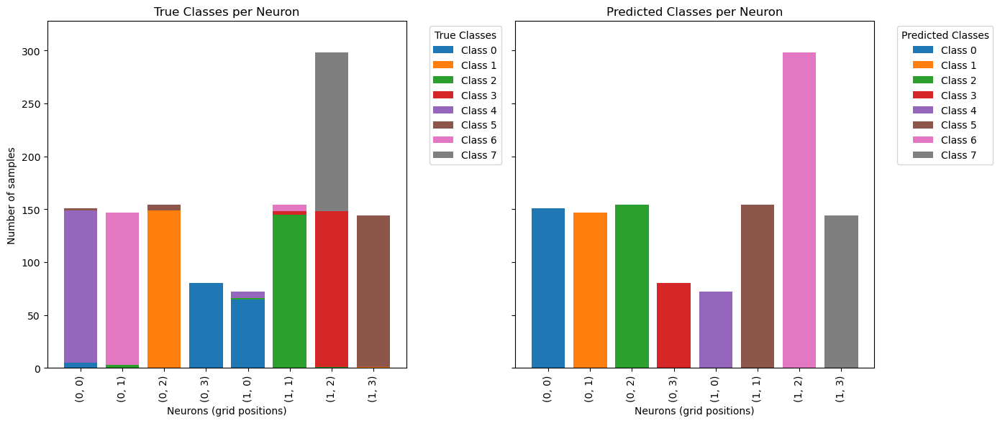


############### Neighborhood function: gaussian. M = 2, N = 4. Sigma: 1.0. ###############

Number of original classes: 8. Number of clusters detected by the network: 8.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.618463
Normalized Mutual Information (NMI)   0.756310
            Calinski-Harabasz Index 826.699953
               Davies-Bouldin Index   1.232632
                   Silhouette Score   0.293000


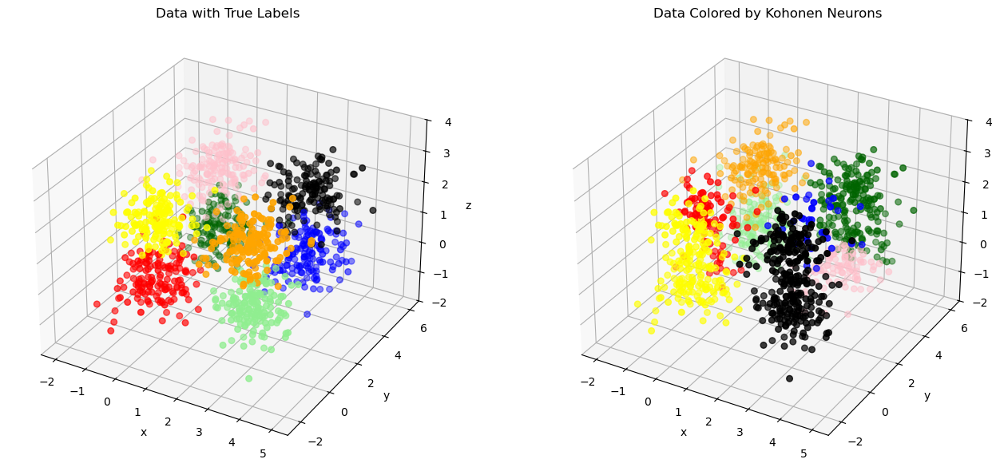

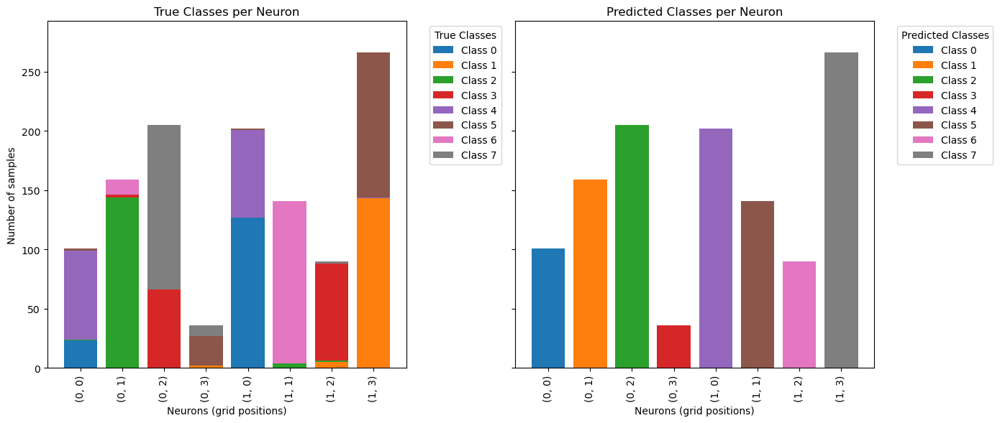


############### Neighborhood function: gaussian. M = 2, N = 4. Sigma: 10.0. ###############

Number of original classes: 8. Number of clusters detected by the network: 8.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.526609
Normalized Mutual Information (NMI)   0.708754
            Calinski-Harabasz Index 629.749168
               Davies-Bouldin Index   1.895240
                   Silhouette Score   0.175298


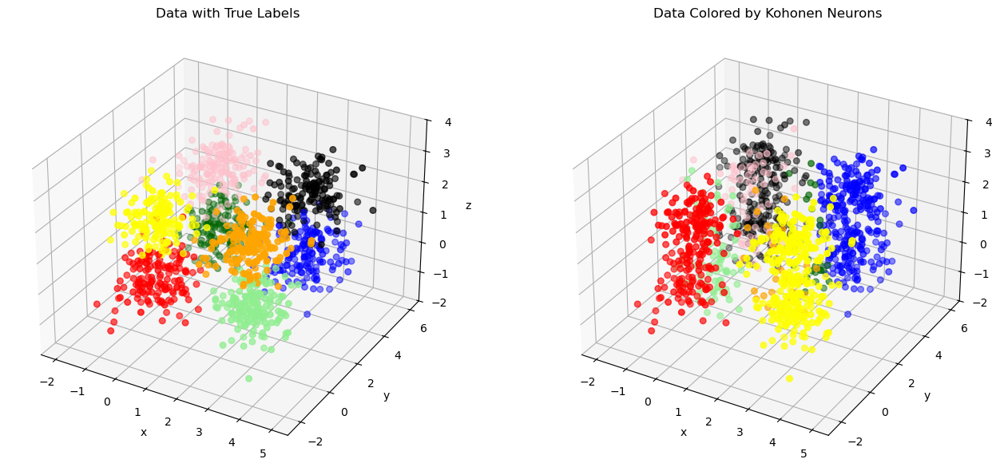

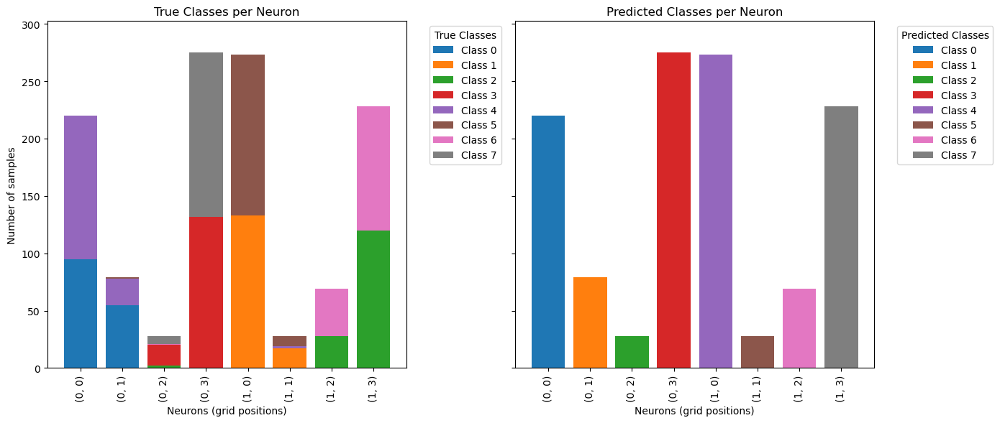


############### Neighborhood function: gaussian. M = 3, N = 3. Sigma: 0.1. ###############

Number of original classes: 8. Number of clusters detected by the network: 9.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.607111
Normalized Mutual Information (NMI)   0.770288
            Calinski-Harabasz Index 688.096206
               Davies-Bouldin Index   1.193394
                   Silhouette Score   0.366513


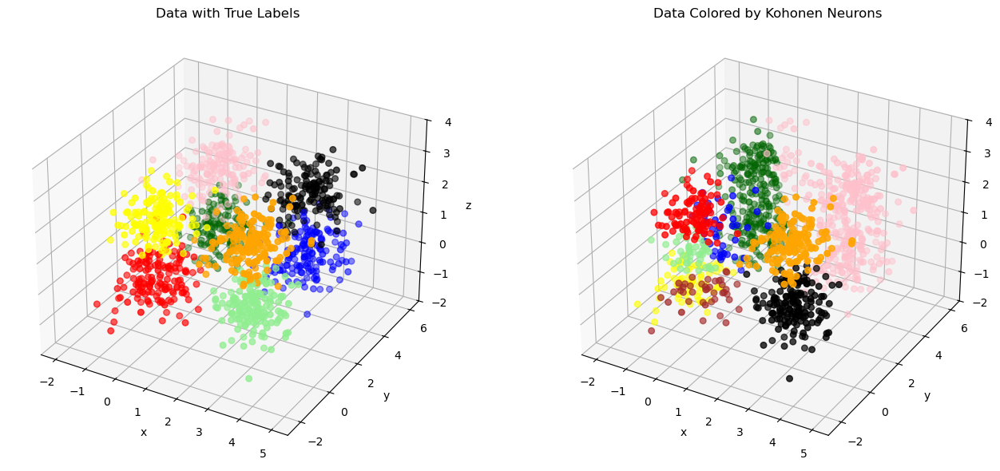

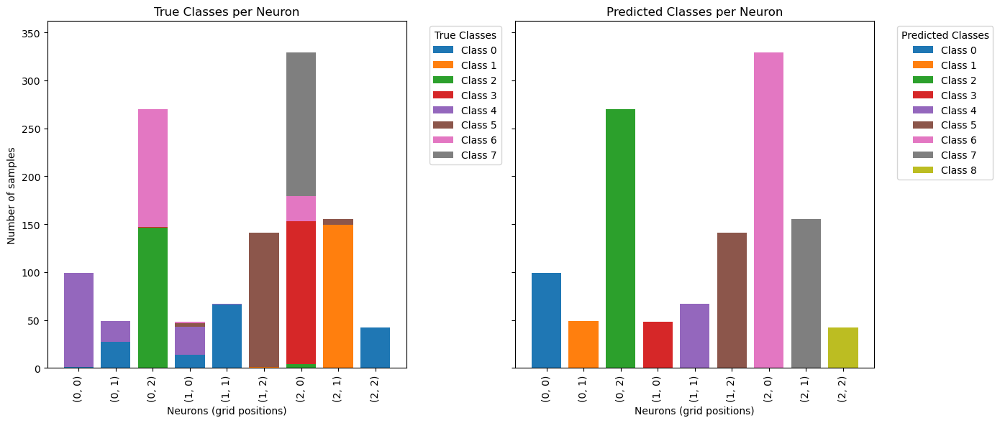


############### Neighborhood function: gaussian. M = 3, N = 3. Sigma: 0.5. ###############

Number of original classes: 8. Number of clusters detected by the network: 9.

Clustering Evaluation Metrics:
                             Metric       Value
          Adjusted Rand Index (ARI)    0.885163
Normalized Mutual Information (NMI)    0.898188
            Calinski-Harabasz Index 1161.430843
               Davies-Bouldin Index    1.017797
                   Silhouette Score    0.393129


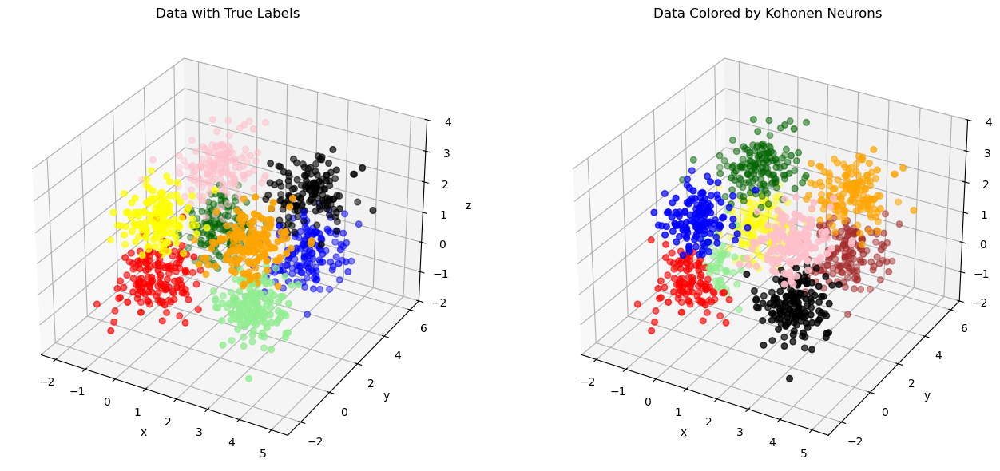

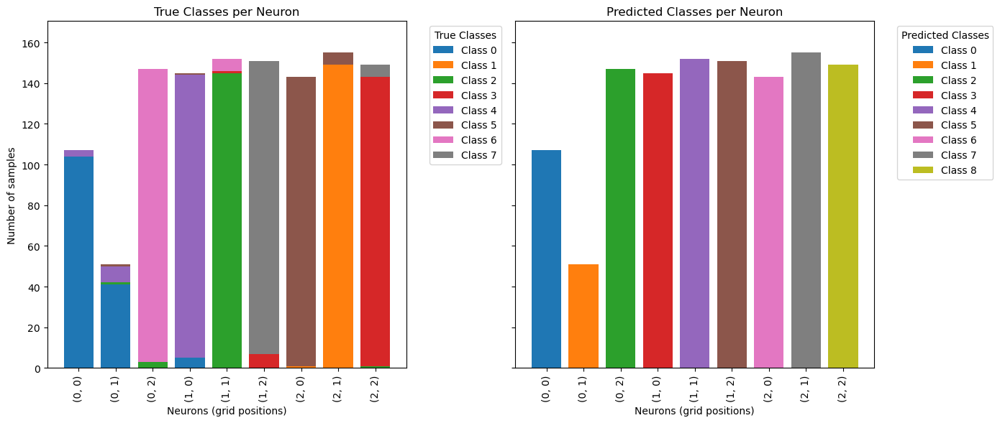


############### Neighborhood function: gaussian. M = 3, N = 3. Sigma: 1.0. ###############

Number of original classes: 8. Number of clusters detected by the network: 9.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.680572
Normalized Mutual Information (NMI)   0.785923
            Calinski-Harabasz Index 787.358057
               Davies-Bouldin Index   1.145419
                   Silhouette Score   0.294288


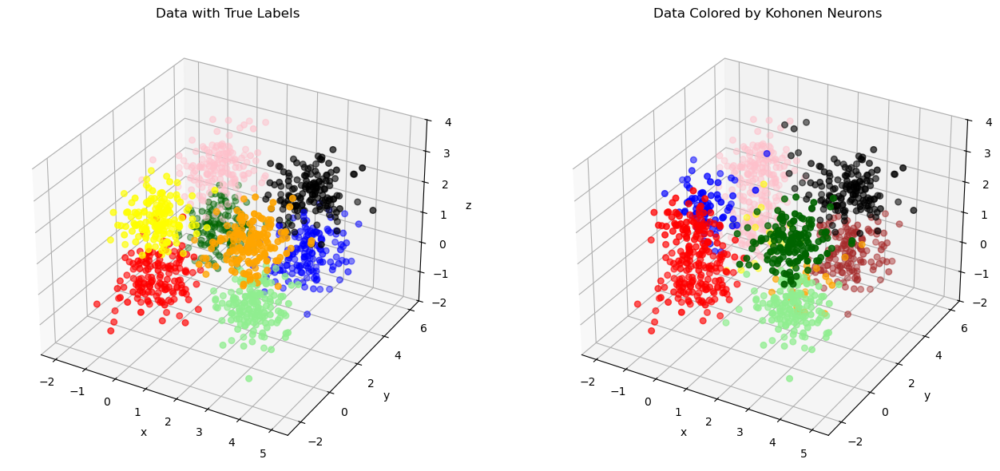

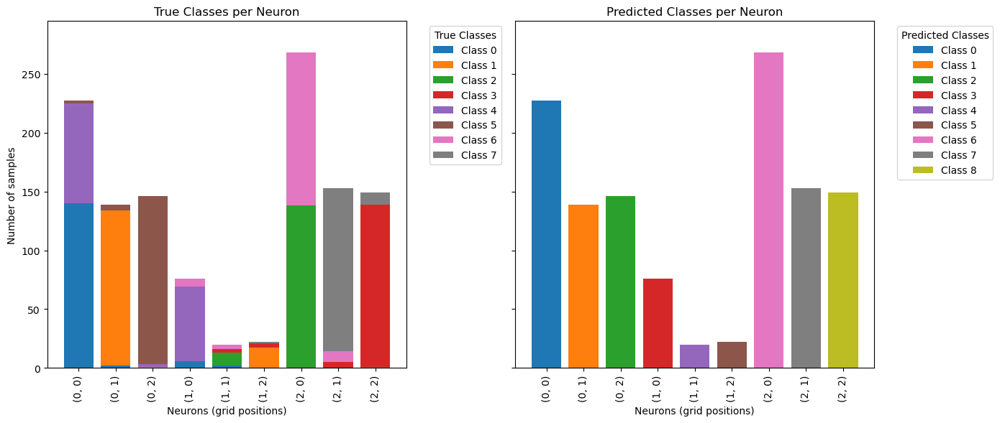


############### Neighborhood function: gaussian. M = 3, N = 3. Sigma: 10.0. ###############

Number of original classes: 8. Number of clusters detected by the network: 9.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.544277
Normalized Mutual Information (NMI)   0.700372
            Calinski-Harabasz Index 528.485826
               Davies-Bouldin Index   1.405764
                   Silhouette Score   0.176403


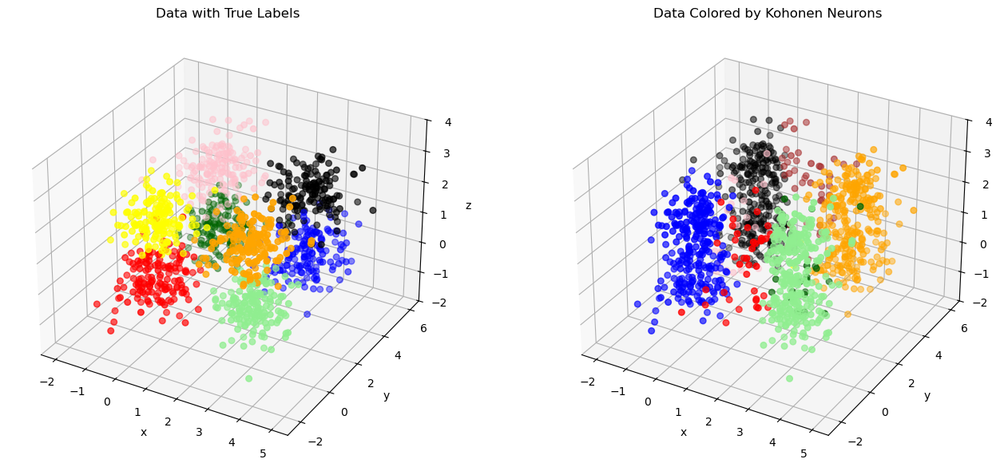

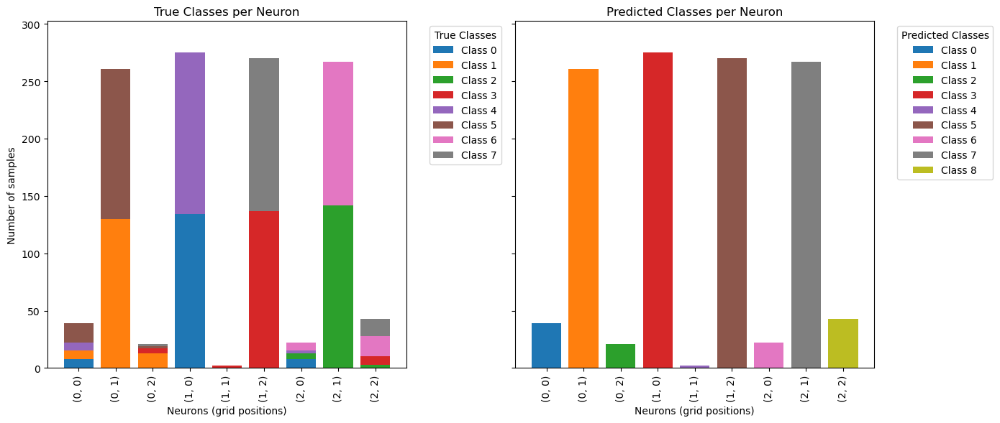


############### Neighborhood function: gaussian. M = 10, N = 10. Sigma: 0.1. ###############

Number of original classes: 8. Number of clusters detected by the network: 49.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.600400
Normalized Mutual Information (NMI)   0.741695
            Calinski-Harabasz Index 134.647795
               Davies-Bouldin Index   0.854778
                   Silhouette Score   0.190918


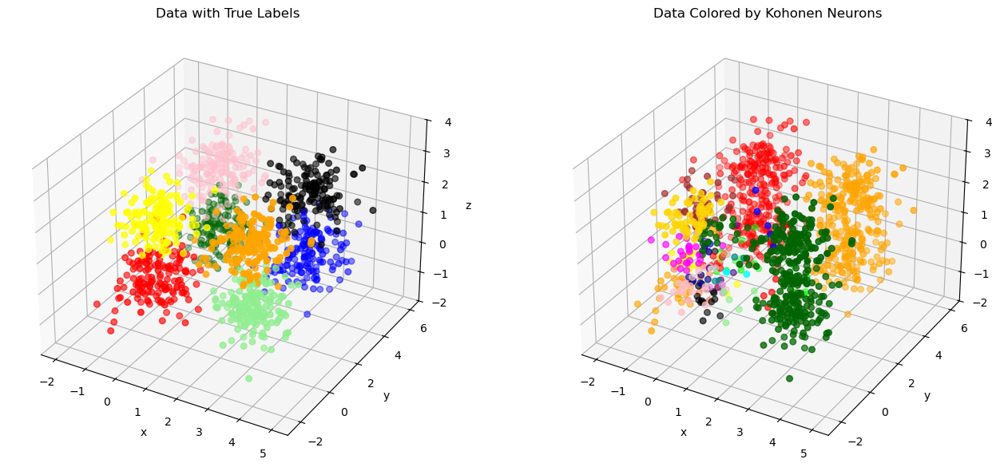

C:\Users\flang\AppData\Local\Temp\ipykernel_17760\1167224659.py:339: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


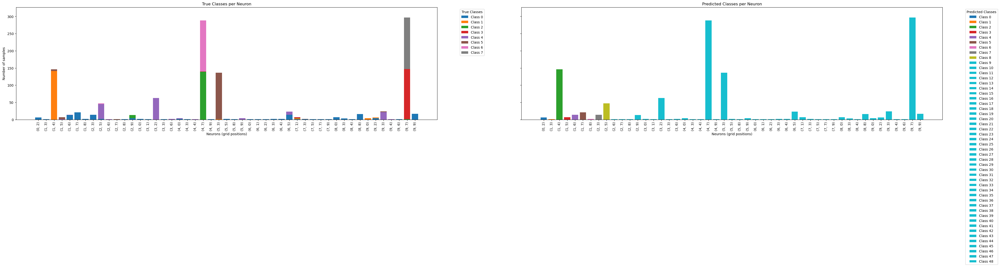


############### Neighborhood function: gaussian. M = 10, N = 10. Sigma: 0.5. ###############

Number of original classes: 8. Number of clusters detected by the network: 55.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.706038
Normalized Mutual Information (NMI)   0.770492
            Calinski-Harabasz Index 219.697695
               Davies-Bouldin Index   0.910646
                   Silhouette Score   0.207365


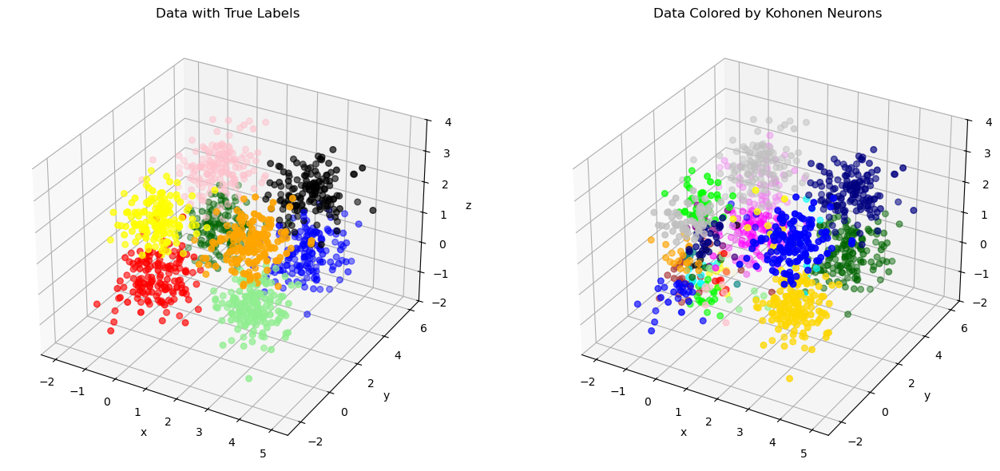

C:\Users\flang\AppData\Local\Temp\ipykernel_17760\1167224659.py:339: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


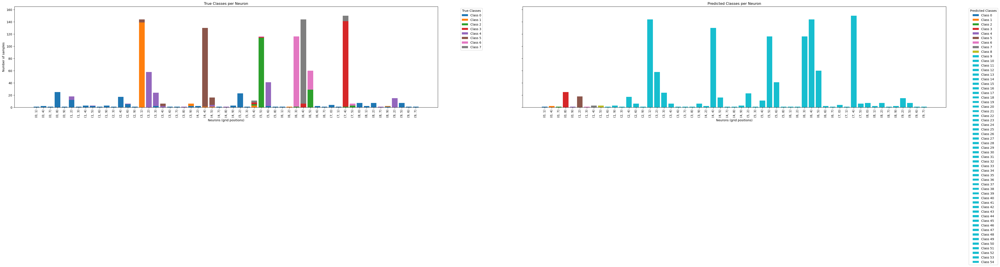


############### Neighborhood function: gaussian. M = 10, N = 10. Sigma: 1.0. ###############

Number of original classes: 8. Number of clusters detected by the network: 74.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.324851
Normalized Mutual Information (NMI)   0.665159
            Calinski-Harabasz Index 284.553816
               Davies-Bouldin Index   1.073555
                   Silhouette Score   0.138514


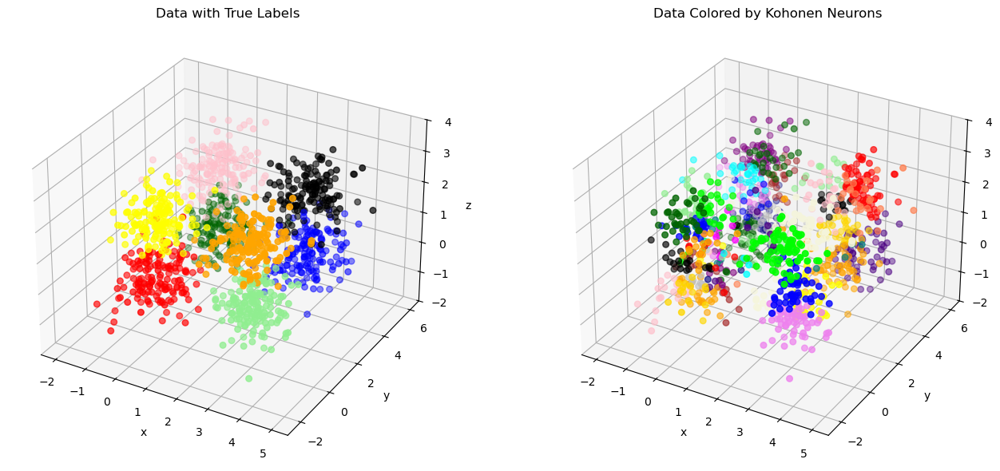

C:\Users\flang\AppData\Local\Temp\ipykernel_17760\1167224659.py:339: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


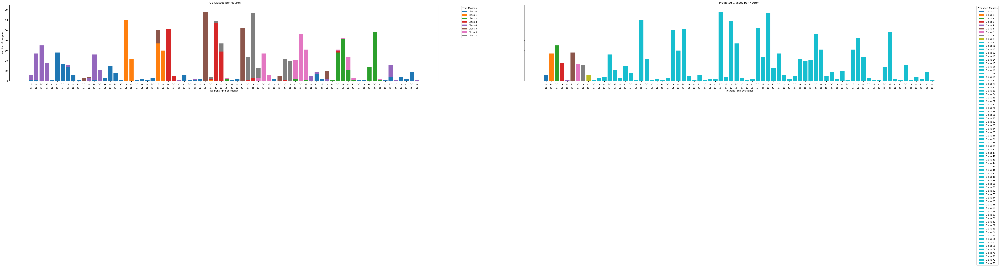


############### Neighborhood function: gaussian. M = 10, N = 10. Sigma: 10.0. ###############

Number of original classes: 8. Number of clusters detected by the network: 95.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.321552
Normalized Mutual Information (NMI)   0.653370
            Calinski-Harabasz Index 208.904621
               Davies-Bouldin Index   1.584665
                   Silhouette Score   0.008365


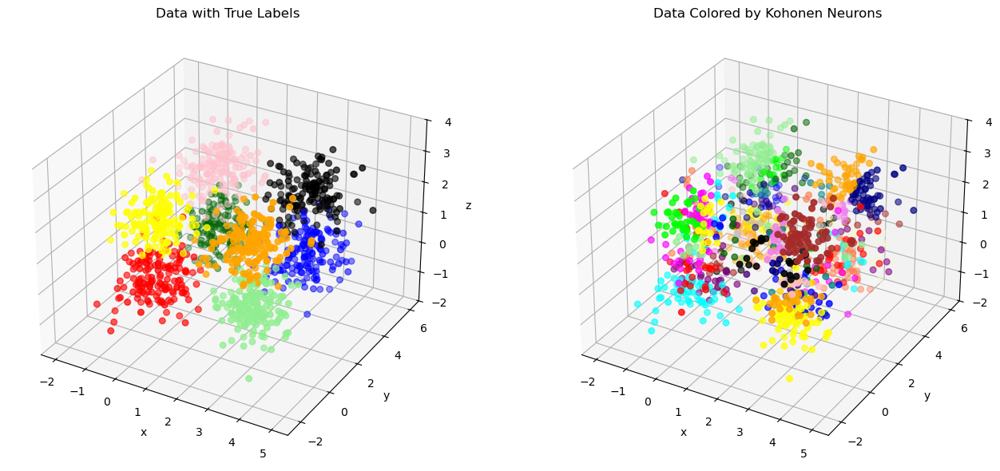

C:\Users\flang\AppData\Local\Temp\ipykernel_17760\1167224659.py:339: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


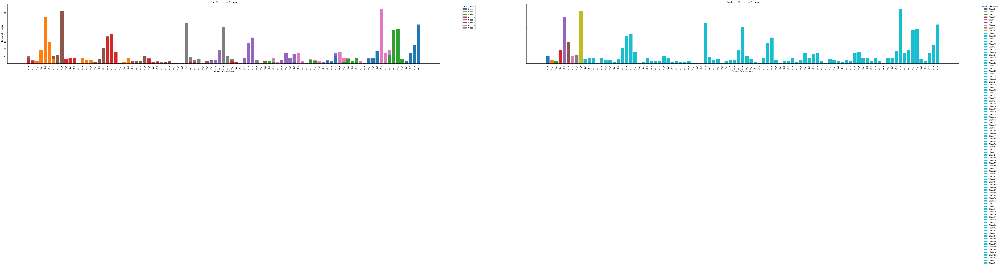


############### Neighborhood function: mexican_hat. M = 2, N = 2. Sigma: 0.1. ###############

Number of original classes: 8. Number of clusters detected by the network: 4.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.412817
Normalized Mutual Information (NMI)   0.696922
            Calinski-Harabasz Index 780.361037
               Davies-Bouldin Index   0.849846
                   Silhouette Score   0.400886


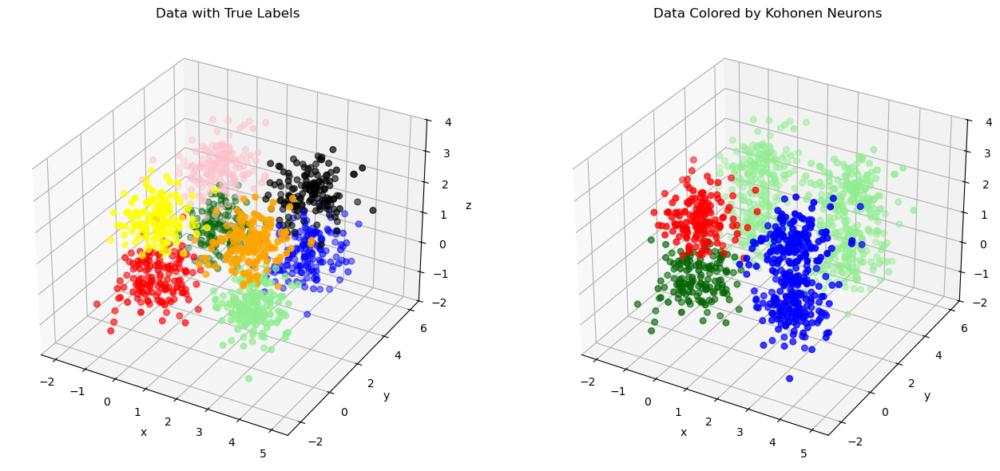

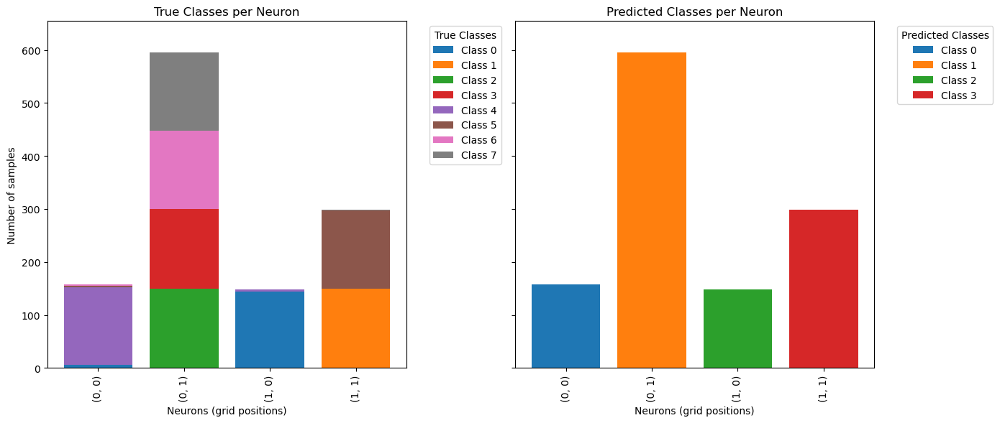


############### Neighborhood function: mexican_hat. M = 2, N = 2. Sigma: 0.5. ###############

Number of original classes: 8. Number of clusters detected by the network: 2.

Clustering Evaluation Metrics:
                             Metric       Value
          Adjusted Rand Index (ARI)    0.248904
Normalized Mutual Information (NMI)    0.500000
            Calinski-Harabasz Index 1160.405944
               Davies-Bouldin Index    0.981463
                   Silhouette Score    0.449763


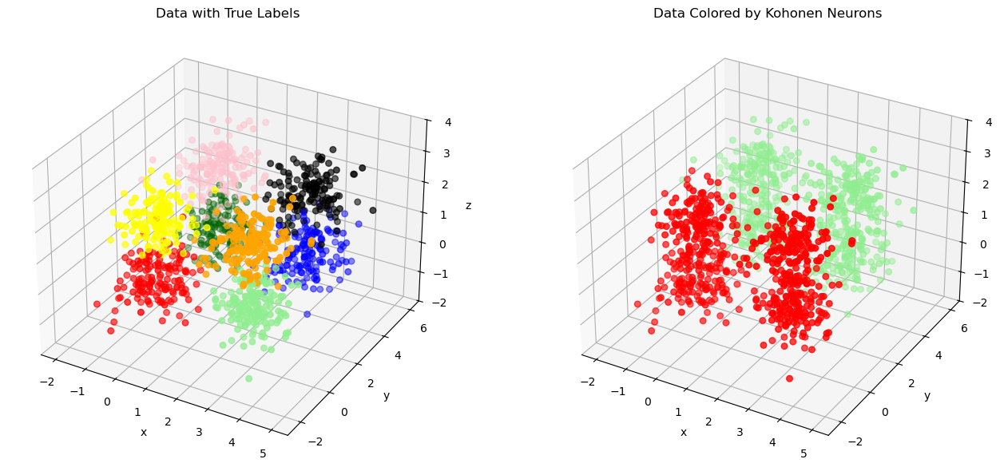

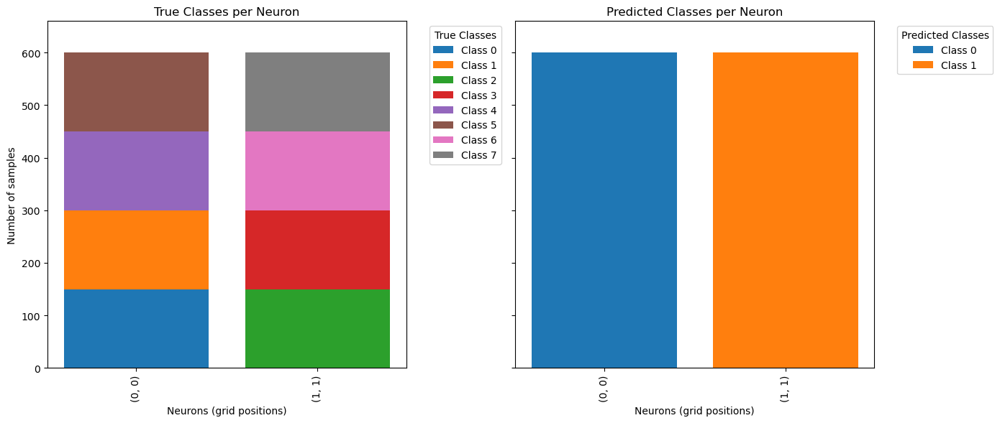


############### Neighborhood function: mexican_hat. M = 2, N = 2. Sigma: 1.0. ###############

Number of original classes: 8. Number of clusters detected by the network: 1.

Clustering Evaluation Metrics:
                             Metric  Value
          Adjusted Rand Index (ARI)    0.0
Normalized Mutual Information (NMI)    0.0
            Calinski-Harabasz Index    NaN
               Davies-Bouldin Index    NaN
                   Silhouette Score    NaN


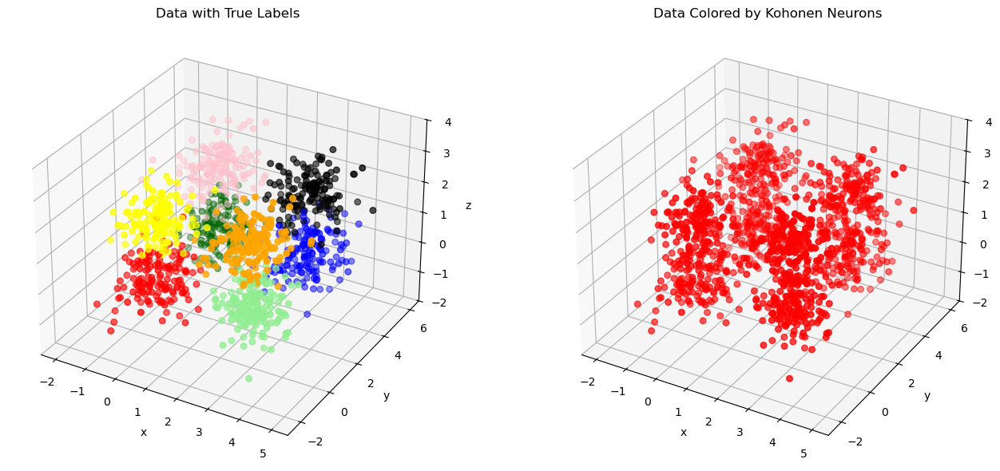

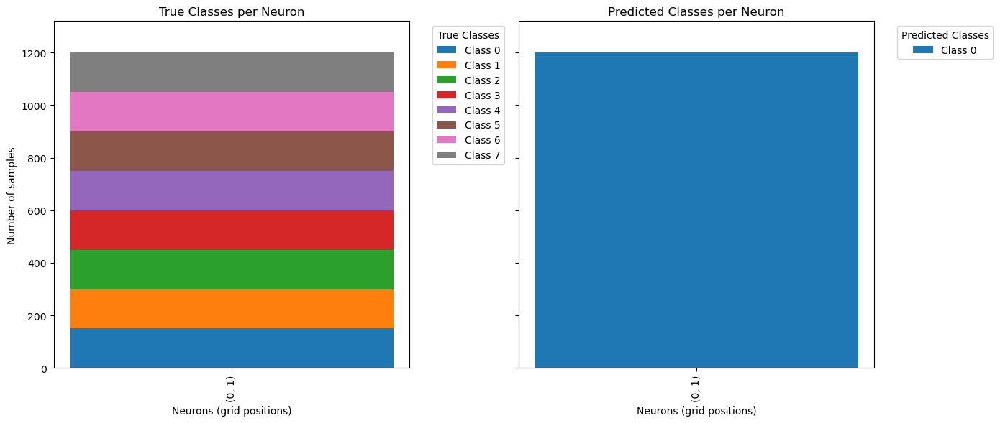


############### Neighborhood function: mexican_hat. M = 2, N = 2. Sigma: 10.0. ###############

Number of original classes: 8. Number of clusters detected by the network: 2.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.243947
Normalized Mutual Information (NMI)   0.480005
            Calinski-Harabasz Index 443.496103
               Davies-Bouldin Index   1.595240
                   Silhouette Score   0.291574


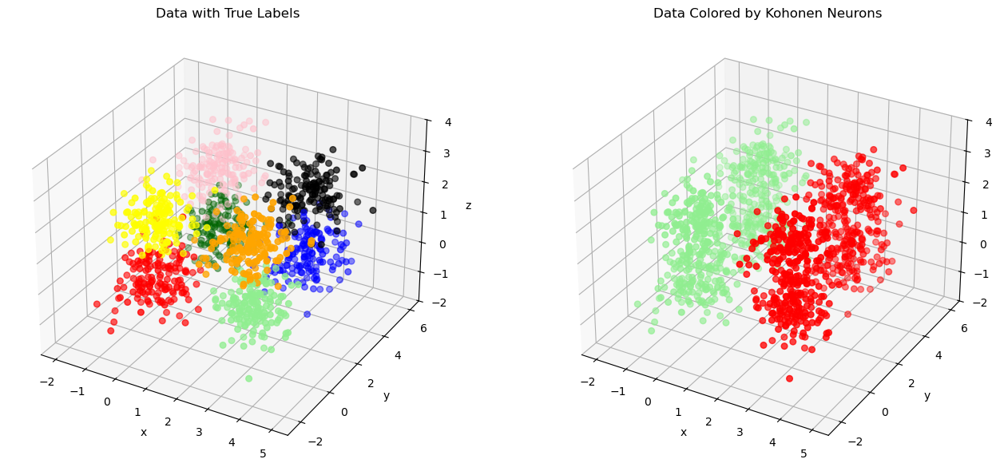

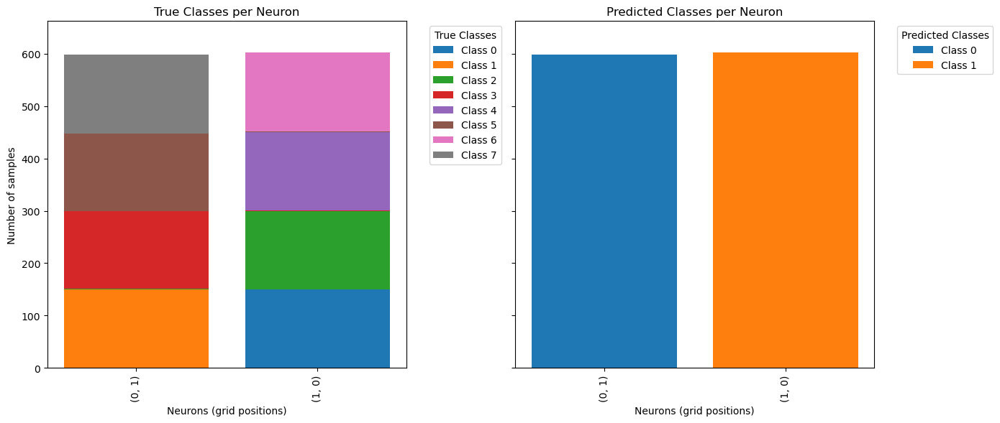


############### Neighborhood function: mexican_hat. M = 2, N = 4. Sigma: 0.1. ###############

Number of original classes: 8. Number of clusters detected by the network: 8.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.406112
Normalized Mutual Information (NMI)   0.688670
            Calinski-Harabasz Index 417.276824
               Davies-Bouldin Index   1.142602
                   Silhouette Score   0.279477


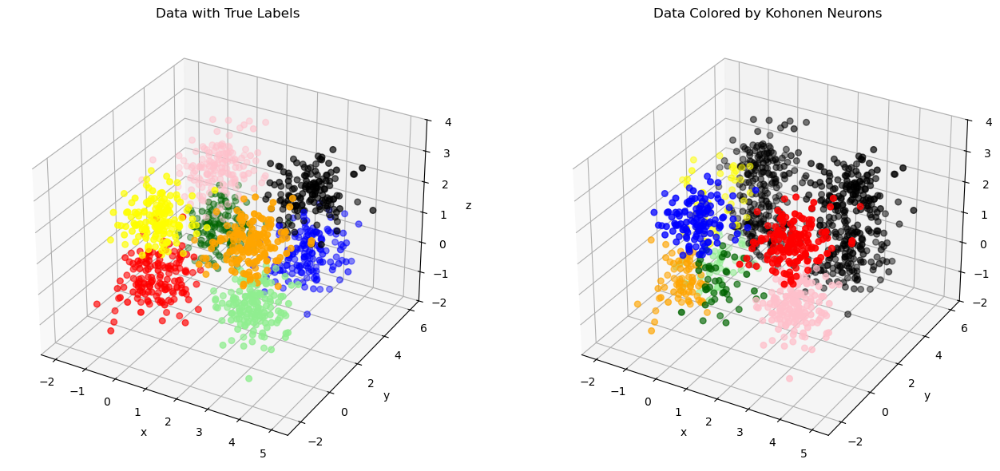

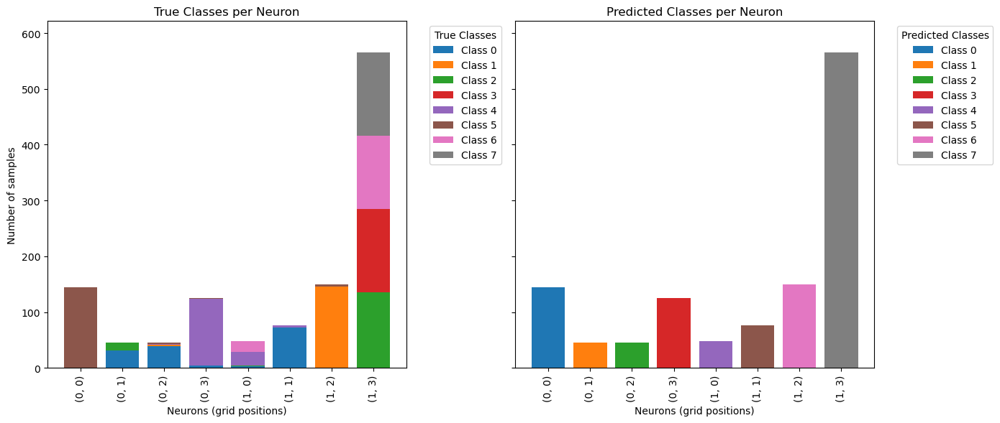


############### Neighborhood function: mexican_hat. M = 2, N = 4. Sigma: 0.5. ###############

Number of original classes: 8. Number of clusters detected by the network: 4.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.413842
Normalized Mutual Information (NMI)   0.698787
            Calinski-Harabasz Index 780.365196
               Davies-Bouldin Index   0.849709
                   Silhouette Score   0.400910


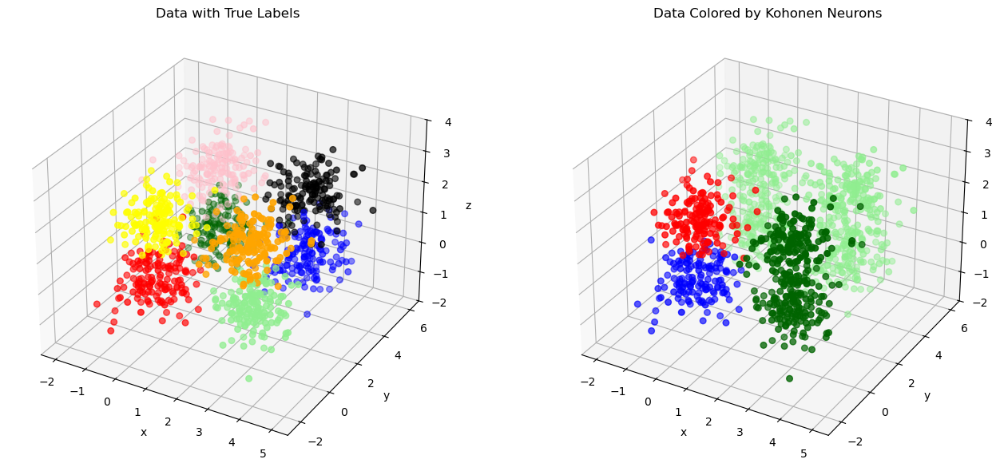

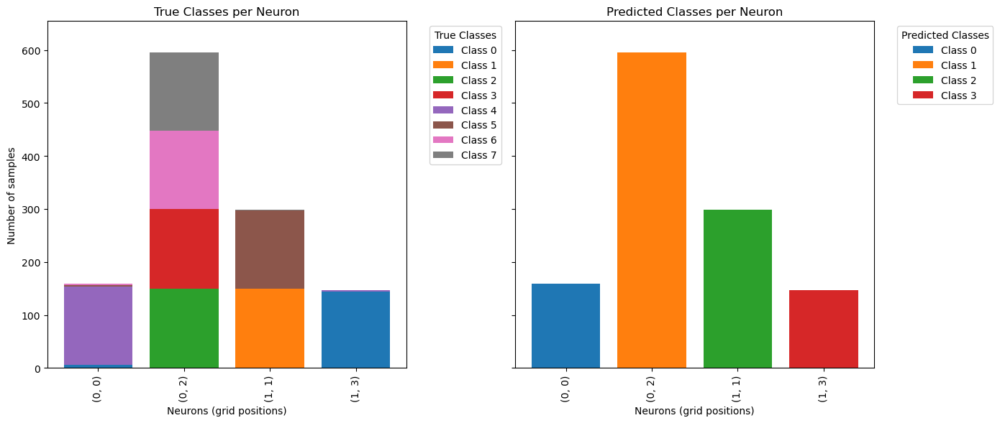


############### Neighborhood function: mexican_hat. M = 2, N = 4. Sigma: 1.0. ###############

Number of original classes: 8. Number of clusters detected by the network: 1.

Clustering Evaluation Metrics:
                             Metric  Value
          Adjusted Rand Index (ARI)    0.0
Normalized Mutual Information (NMI)    0.0
            Calinski-Harabasz Index    NaN
               Davies-Bouldin Index    NaN
                   Silhouette Score    NaN


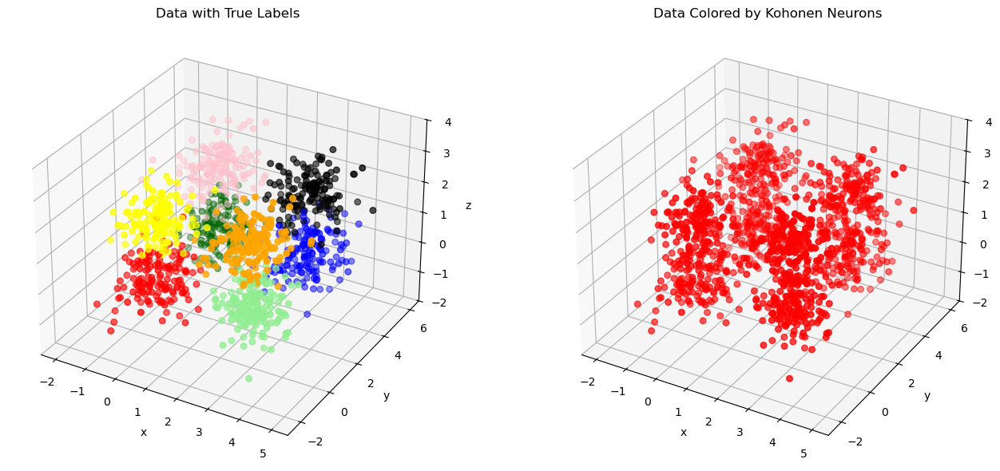

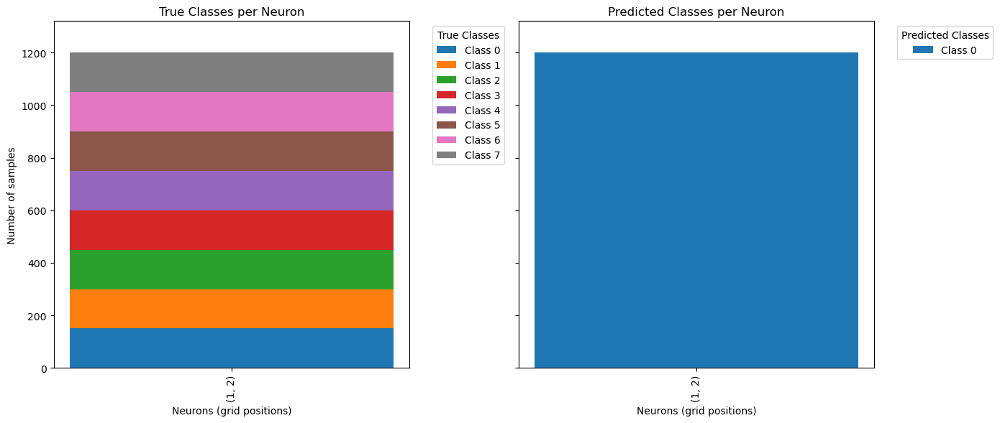


############### Neighborhood function: mexican_hat. M = 2, N = 4. Sigma: 10.0. ###############

Number of original classes: 8. Number of clusters detected by the network: 4.

Clustering Evaluation Metrics:
                             Metric       Value
          Adjusted Rand Index (ARI)    0.593283
Normalized Mutual Information (NMI)    0.789110
            Calinski-Harabasz Index 1278.632587
               Davies-Bouldin Index    0.878862
                   Silhouette Score    0.469373


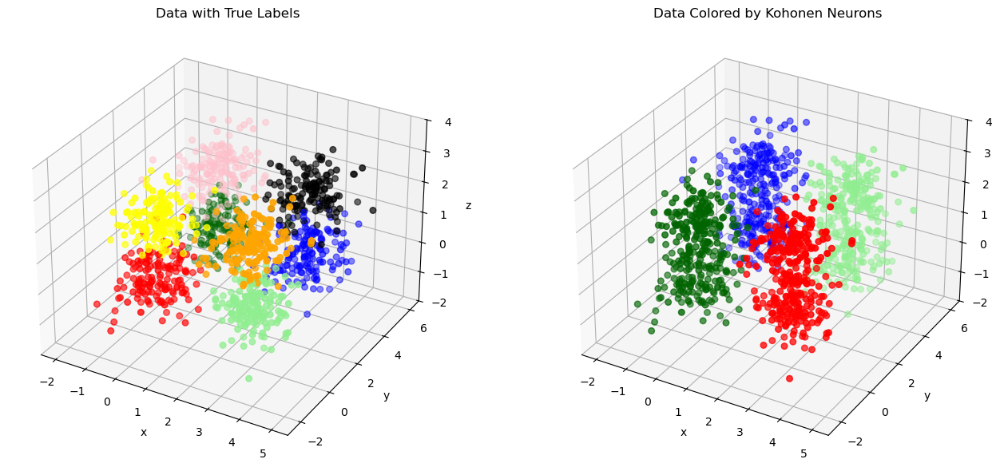

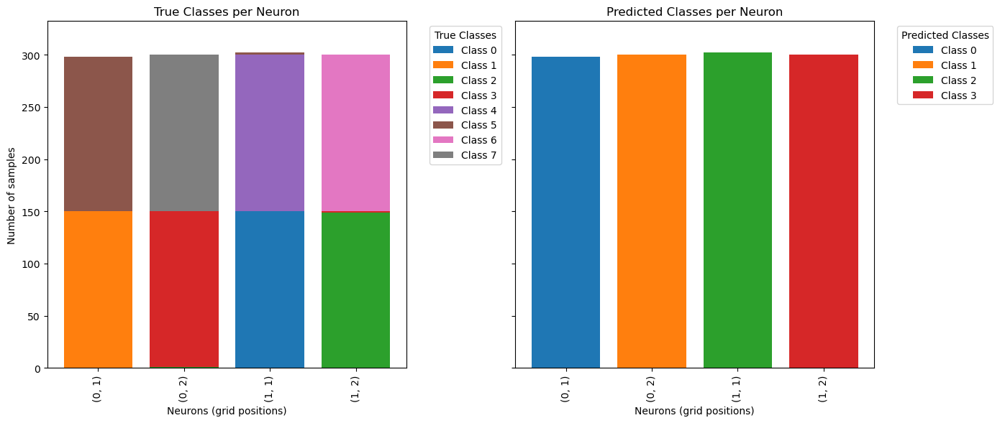


############### Neighborhood function: mexican_hat. M = 3, N = 3. Sigma: 0.1. ###############

Number of original classes: 8. Number of clusters detected by the network: 9.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.654097
Normalized Mutual Information (NMI)   0.813072
            Calinski-Harabasz Index 746.406267
               Davies-Bouldin Index   1.106786
                   Silhouette Score   0.385177


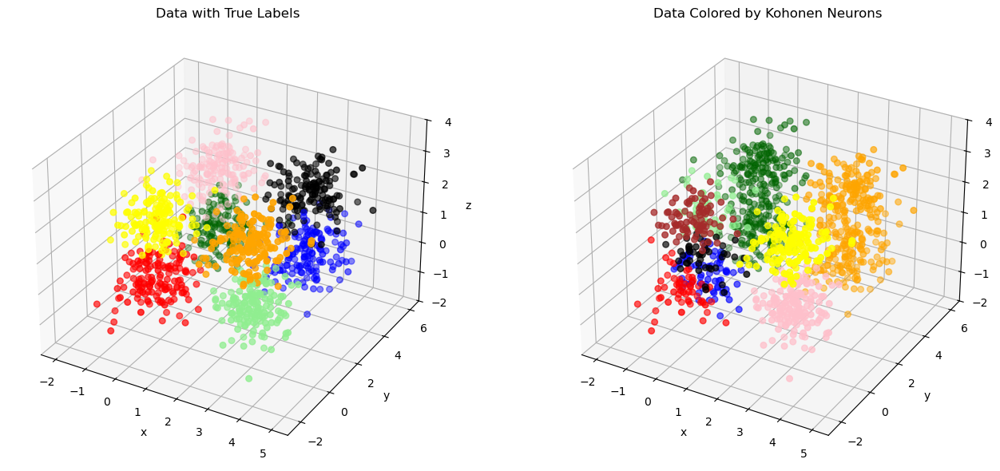

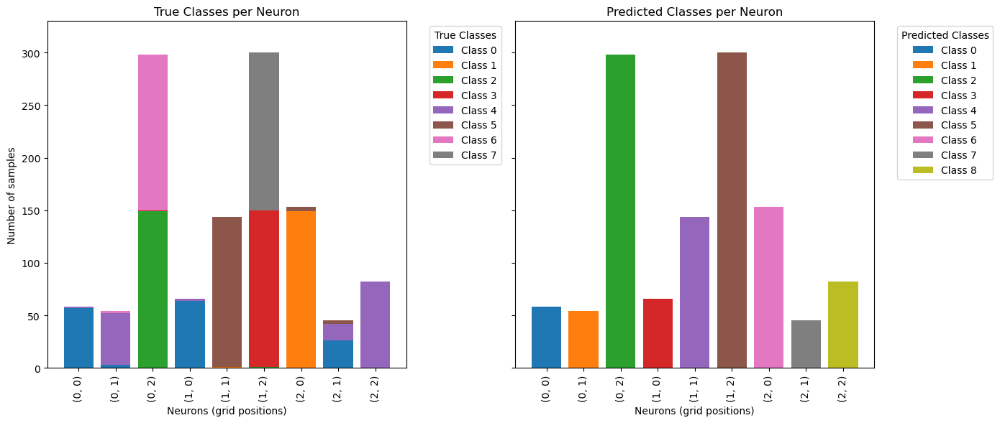


############### Neighborhood function: mexican_hat. M = 3, N = 3. Sigma: 0.5. ###############

Number of original classes: 8. Number of clusters detected by the network: 3.

Clustering Evaluation Metrics:
                             Metric       Value
          Adjusted Rand Index (ARI)    0.378846
Normalized Mutual Information (NMI)    0.648687
            Calinski-Harabasz Index 1026.952731
               Davies-Bouldin Index    0.830444
                   Silhouette Score    0.436808


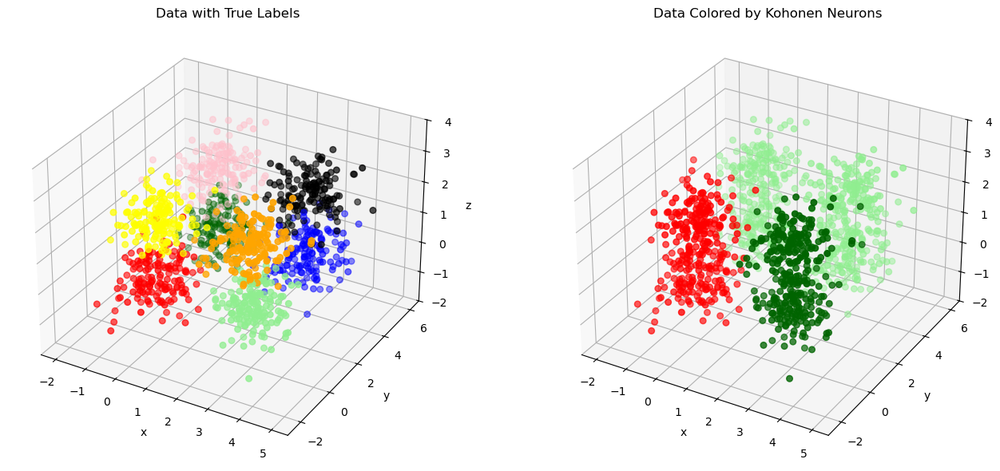

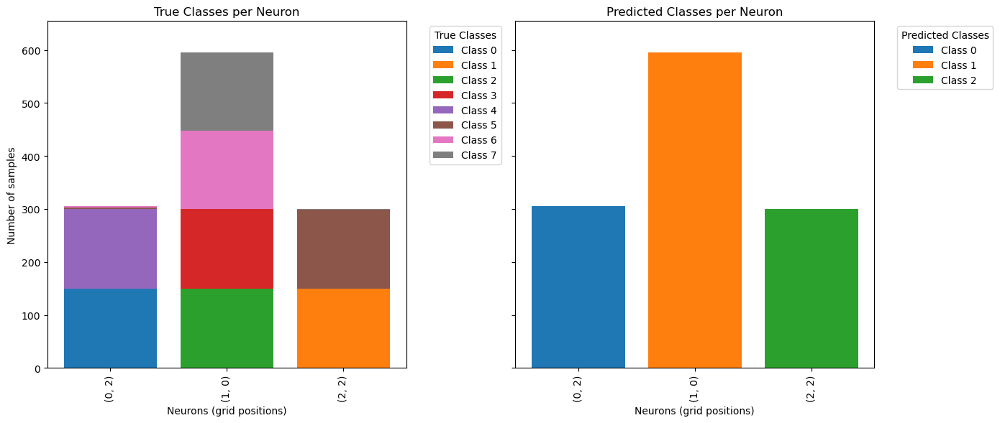


############### Neighborhood function: mexican_hat. M = 3, N = 3. Sigma: 1.0. ###############

Number of original classes: 8. Number of clusters detected by the network: 1.

Clustering Evaluation Metrics:
                             Metric  Value
          Adjusted Rand Index (ARI)    0.0
Normalized Mutual Information (NMI)    0.0
            Calinski-Harabasz Index    NaN
               Davies-Bouldin Index    NaN
                   Silhouette Score    NaN


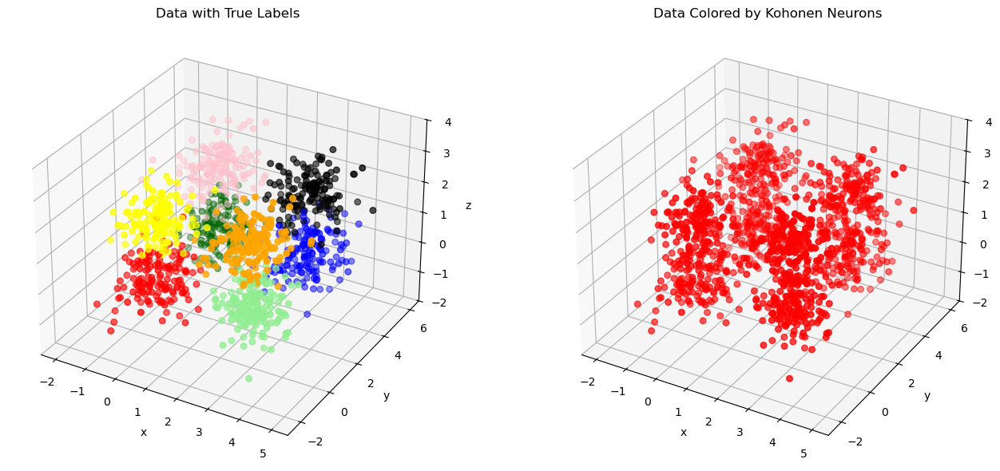

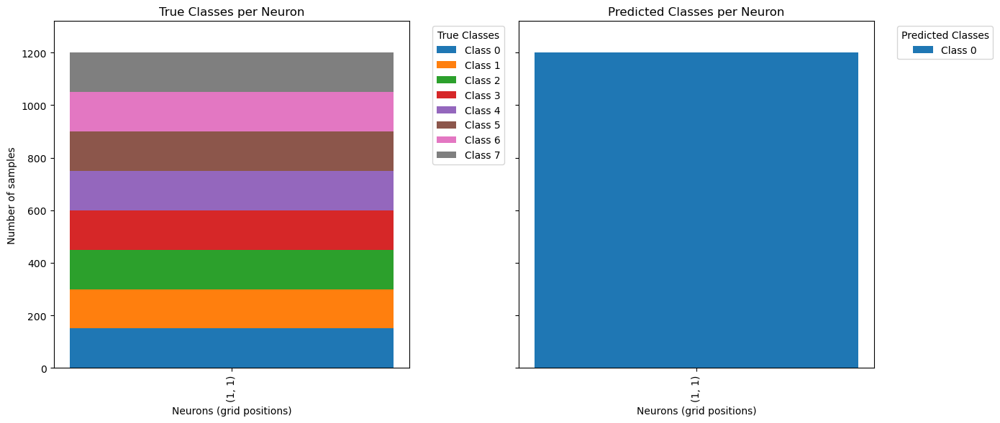


############### Neighborhood function: mexican_hat. M = 3, N = 3. Sigma: 10.0. ###############

Number of original classes: 8. Number of clusters detected by the network: 1.

Clustering Evaluation Metrics:
                             Metric  Value
          Adjusted Rand Index (ARI)    0.0
Normalized Mutual Information (NMI)    0.0
            Calinski-Harabasz Index    NaN
               Davies-Bouldin Index    NaN
                   Silhouette Score    NaN


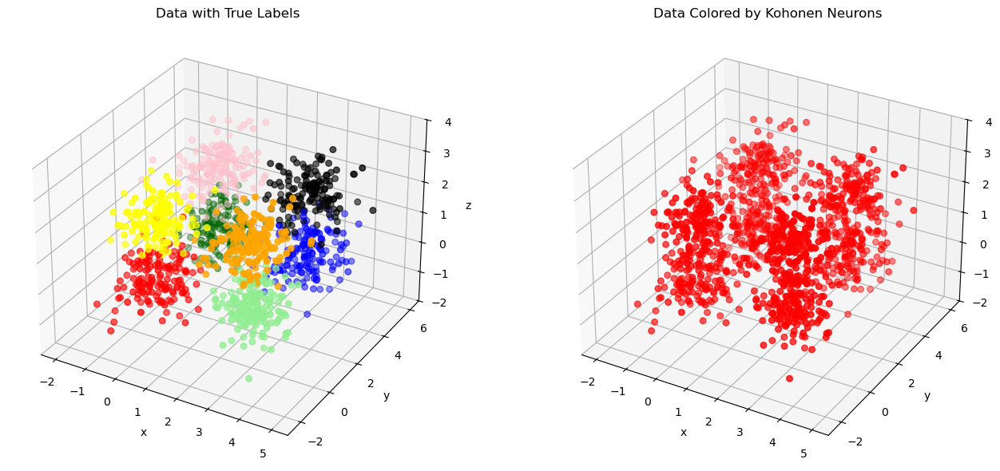

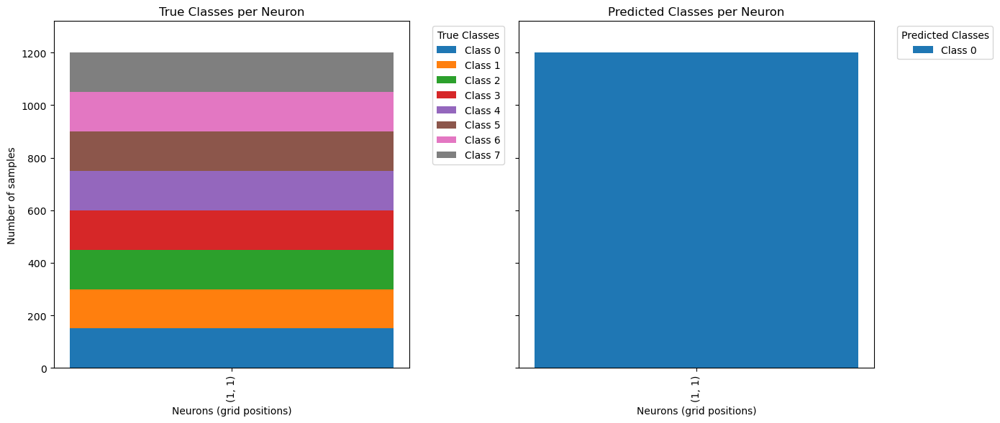


############### Neighborhood function: mexican_hat. M = 10, N = 10. Sigma: 0.1. ###############

Number of original classes: 8. Number of clusters detected by the network: 45.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.597837
Normalized Mutual Information (NMI)   0.740727
            Calinski-Harabasz Index 145.727927
               Davies-Bouldin Index   0.985913
                   Silhouette Score   0.222014


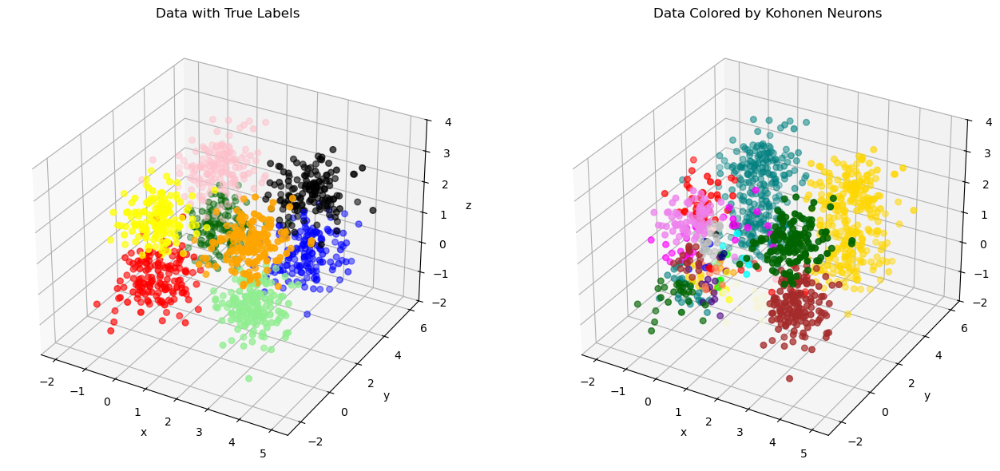

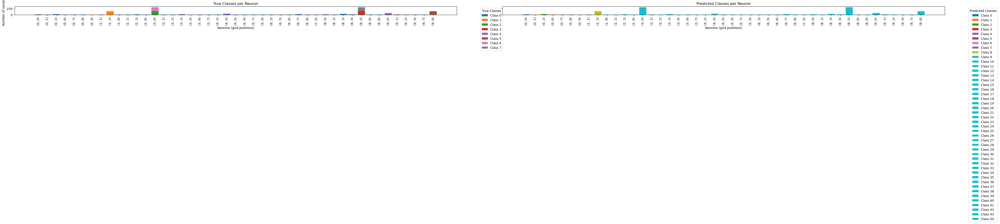


############### Neighborhood function: mexican_hat. M = 10, N = 10. Sigma: 0.5. ###############

Number of original classes: 8. Number of clusters detected by the network: 48.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.778568
Normalized Mutual Information (NMI)   0.801157
            Calinski-Harabasz Index 237.143013
               Davies-Bouldin Index   0.959230
                   Silhouette Score   0.248203


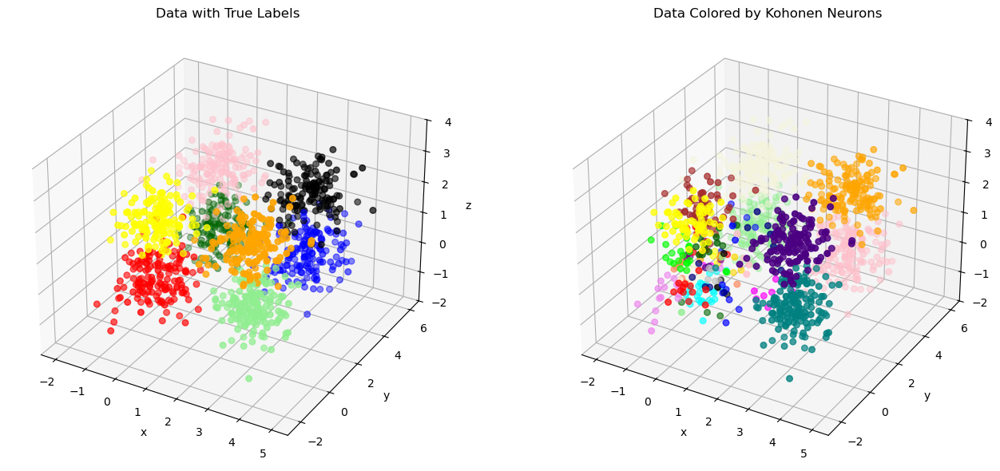

C:\Users\flang\AppData\Local\Temp\ipykernel_17760\1167224659.py:339: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


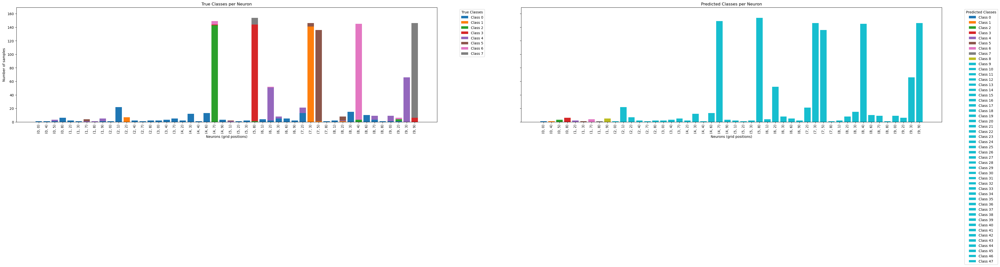


############### Neighborhood function: mexican_hat. M = 10, N = 10. Sigma: 1.0. ###############

Number of original classes: 8. Number of clusters detected by the network: 37.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.732998
Normalized Mutual Information (NMI)   0.785472
            Calinski-Harabasz Index 325.520334
               Davies-Bouldin Index   1.069528
                   Silhouette Score   0.252198


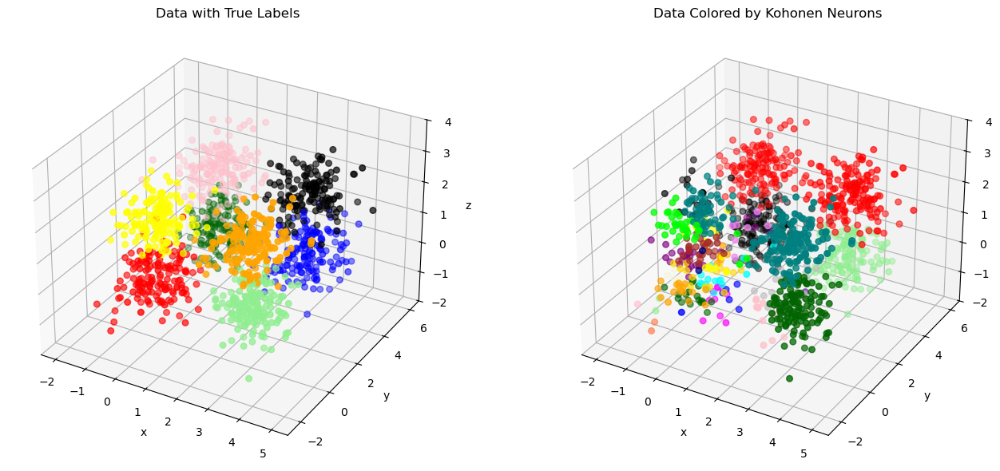

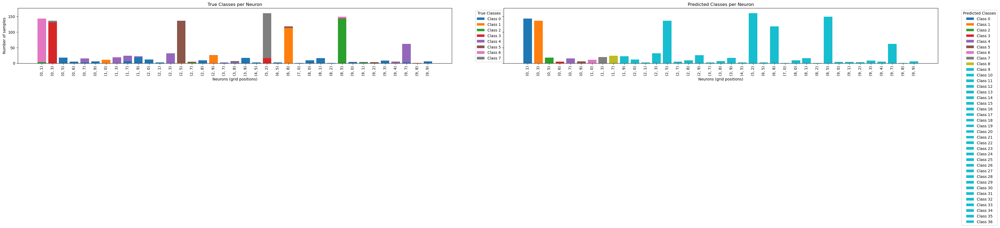


############### Neighborhood function: mexican_hat. M = 10, N = 10. Sigma: 10.0. ###############

Number of original classes: 8. Number of clusters detected by the network: 3.

Clustering Evaluation Metrics:
                             Metric      Value
          Adjusted Rand Index (ARI)   0.158109
Normalized Mutual Information (NMI)   0.347586
            Calinski-Harabasz Index 361.590850
               Davies-Bouldin Index   1.070742
                   Silhouette Score   0.220515


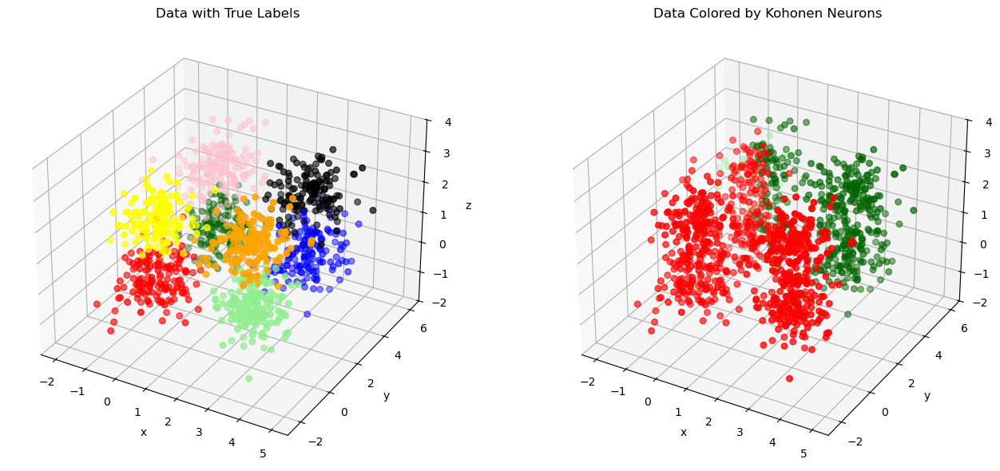

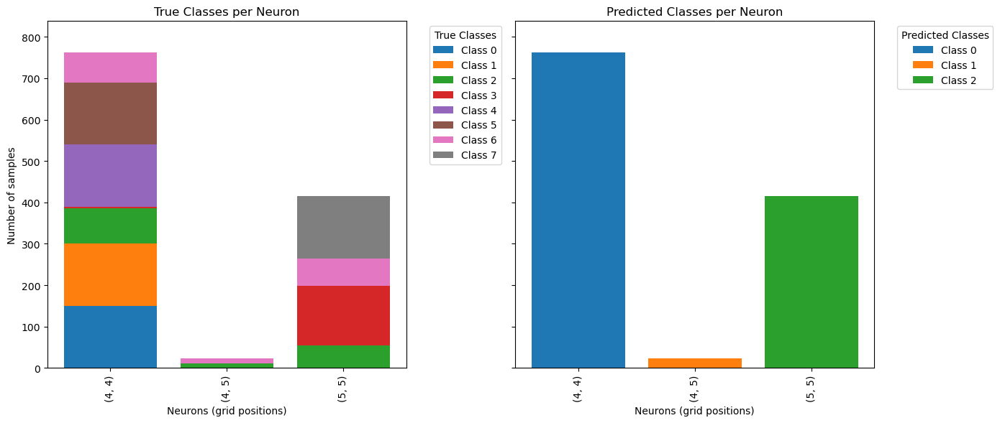

In [19]:
cube = pd.read_csv('data/cube.csv')
cube_X = cube[['x', 'y', 'z']].values 
cube_true_labels = cube['c'].values  

results_cube = []

for function_name in neighborhood_function_names:
    for (M, N) in MNs:
        if (M, N) == (2, 3):
            (M, N) = (2, 4)
        for sigma in sigmas:
            print(f"\n############### Neighborhood function: {function_name}. M = {M}, N = {N}. Sigma: {sigma}. ###############\n")
            som = KohonenNetwork(M=M, N=N)  
            som.train(cube_X, 
                    epochs=10, 
                    learning_rate=0.1, 
                    sigma=sigma, 
                    decay_lambda=1000, 
                    neighborhood_function=function_name, 
                    sigma_decay=True, 
                    verbose=False)

            labels_pred_cube = som.assign_classes(cube_X)  

            unique_true_classes = len(np.unique(cube_true_labels))
            unique_clusters = len(np.unique(labels_pred_cube))
            print(f"Number of original classes: {unique_true_classes}. Number of clusters detected by the network: {unique_clusters}.")

            metrics = som.evaluate_clustering(cube_X, cube_true_labels, labels_pred_cube)
            result = {
                'function_name': function_name,
                'M': M,
                'N': N,
                'sigma': sigma,
                'unique_clusters': unique_clusters,
                'calinski_harabasz': metrics['Calinski-Harabasz Index'],
                'davies_bouldin': metrics['Davies-Bouldin Index'],
                'silhouette': metrics['Silhouette Score'],
                'ari': metrics['Adjusted Rand Index (ARI)'],
                'nmi': metrics['Normalized Mutual Information (NMI)']
            }
            results_cube.append(result)
            
            som.plot_data_and_clusters(cube_X, labels_true=cube_true_labels)
            som.plot_stacked_bar_neurons(cube_X, cube_true_labels, labels_pred_cube)
            
results_df_cube = pd.DataFrame(results_cube)

In [20]:
results_df_cube

,function_name,M,N,sigma,unique_clusters,calinski_harabasz,davies_bouldin,silhouette,ari,nmi
0,gaussian,2,2,0.1,4,780.365196,0.849709,0.400910,0.413842,0.698787
1,gaussian,2,2,0.5,4,1278.632587,0.878862,0.469373,0.593283,0.789110
2,gaussian,2,2,1.0,4,1278.632587,0.878862,0.469373,0.593283,0.789110
3,gaussian,2,2,10.0,4,442.672785,1.384172,0.084942,0.237512,0.453055
4,gaussian,2,4,0.1,8,833.560999,1.126645,0.387399,0.675419,0.825085
5,gaussian,2,4,0.5,8,1030.663700,1.014767,0.399891,0.784248,0.876154
6,gaussian,2,4,1.0,8,826.699953,1.232632,0.293000,0.618463,0.756310
7,gaussian,2,4,10.0,8,629.749168,1.895240,0.175298,0.526609,0.708754
8,gaussian,3,3,0.1,9,688.096206,1.193394,0.366513,0.607111,0.770288
9,gaussian,3,3,0.5,9,1161.430843,1.017797,0.393129,0.885163,0.898188


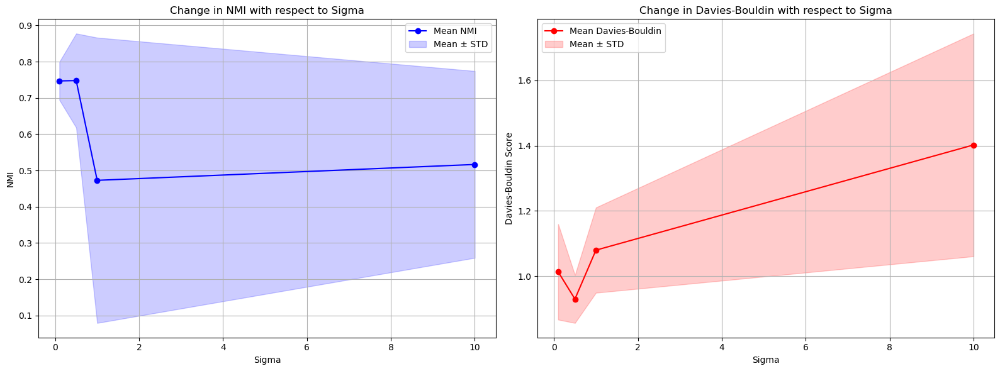

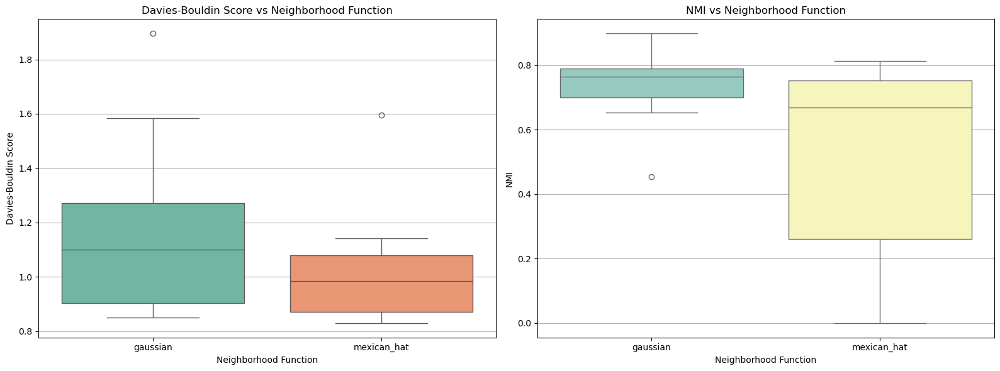

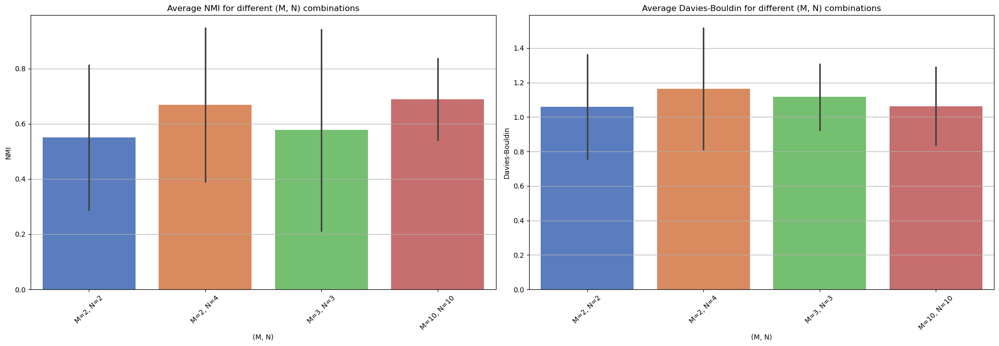

In [21]:
make_summary_plots(results_df_cube)

As we can see the number of clusters found by the network does not always exactly match the number of true classes in the data.
Usually, a single neuron mostly contains data from one class, but sometimes it mixes points from different classes.
Neurons are positioned in the data space according to the patterns they have learned, usually in the centers of local data groups.
The number of elements from each class in a neuron can vary, and some neurons may even have examples from multiple classes.